# JPEG Compression

In [1]:
# import required libraries
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.fftpack import dct, idct
from dahuffman import HuffmanCodec
from math import sqrt, pi, cos

In [2]:
# import external Utility for blockproc and to access other files
import sys
sys.path.append('data')
from Utility import blockproc

## 1.1 Optimal color space
The first step in the process is to apply a color transformation, which takes the image from RGB to YCbCr color space. Implement three functions rgb2ycbcr, ycbcr2rgb and invertColor, that transform a given RGB image to a YCbCr image, YCbCr image to RGB image and any image to its negative respectively.

uint8
(640, 640, 3)


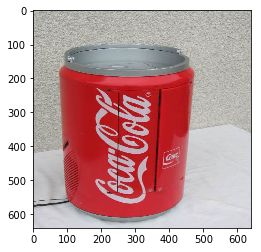

In [3]:
# load image as pixel array
image = mpimg.imread('data/cola.jpg')

# summarize shape of the pixel array
print(image.dtype)
print(image.shape)

# display the array of pixels as an image
plt.imshow(image)
plt.show()

In [4]:
# transform an RGB image to a YCbCr image
# rgb is an np array representation of shape: (dim_x, dim_y, color_channels)
def rgb2ycbcr(rgb):
    constants = np.array([[0.299, 0.587, 0.114], [-0.168736, -0.331264, 0.5], [0.5, -0.418688, -0.081312]])
    ycbcr = rgb.dot(constants.T)
    ycbcr[:,:,[1,2]] += 128
    return np.uint8(ycbcr)

In [5]:
# transform a YCbCr image to an RGB image
def ycbcr2rgb(ycbcr):
    constants = np.linalg.inv(np.array([[0.299, 0.587, 0.114], [-0.168736, -0.331264, 0.5], [0.5, -0.418688, -0.081312]]))
    rgb = ycbcr.astype(np.float)
    rgb[:,:,[1,2]] -= 128
    rgb = rgb.dot(constants.T)
    return np.uint8(rgb)

In [6]:
# transform an image to its negative
def invertColor(img):
    img = 255 - img

In [7]:
# use rgb2ycbcr and ycbcr2rgb functions
ycbcr = rgb2ycbcr(image)
rgb = ycbcr2rgb(ycbcr)

Displaying R, G and B components of the RGB image for validation:

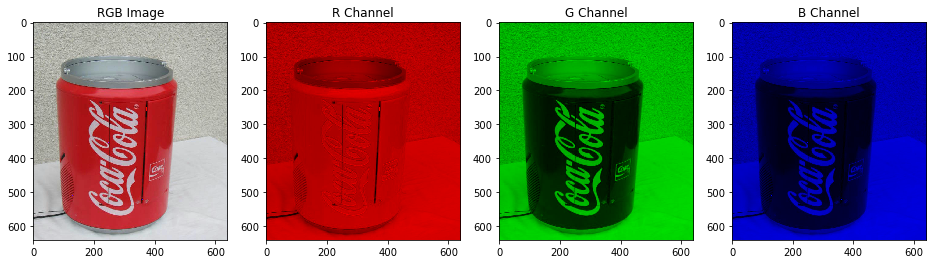

In [8]:
r, g, b = np.copy(rgb), np.copy(rgb), np.copy(rgb)
r[:,:,[1,2]] = 0
g[:,:,[0,2]] = 0
b[:,:,[0,1]] = 0

f, axarr = plt.subplots(1,4, figsize=(16,4))
axarr[0].imshow(rgb,aspect="auto")
axarr[0].set_title("RGB Image")
axarr[1].imshow(r,aspect="auto")
axarr[1].set_title("R Channel")
axarr[2].imshow(g,aspect="auto")
axarr[2].set_title("G Channel")
axarr[3].imshow(b,aspect="auto")
axarr[3].set_title("B Channel")
plt.show()

Displaying Y, Cb and Cr components of the YCbCr image for validation (in RGB):

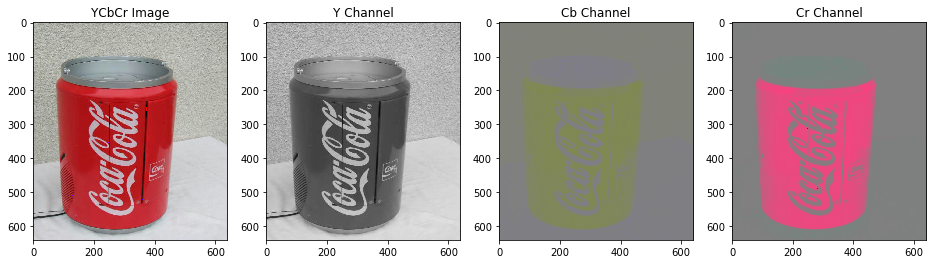

In [9]:
y, cb, cr = np.copy(ycbcr), np.copy(ycbcr), np.copy(ycbcr)
y[:,:,[1,2]] = -128
y_rgb = ycbcr2rgb(y)

cb[:,:,[0,2]] = -128
cb_rgb = ycbcr2rgb(cb)

cr[:,:,[0,1]] = -128
cr_rgb = ycbcr2rgb(cr)

f, axarr = plt.subplots(1,4, figsize=(16,4))
axarr[0].imshow(rgb,aspect="auto")
axarr[0].set_title("YCbCr Image")
axarr[1].imshow(y_rgb,aspect="auto")
axarr[1].set_title("Y Channel")
axarr[2].imshow(cb_rgb,aspect="auto")
axarr[2].set_title("Cb Channel")
axarr[3].imshow(cr_rgb,aspect="auto")
axarr[3].set_title("Cr Channel")
plt.show()

## 1.2 Downsample
Another step in JPEG compression is downsampling of all the CbCr-channels by a factor of w in vertical and horizontal direction. Downsampling here means to assign the whole block of width and height w the mean of all values in the given block. Implement a function downsample that downsamples a given matrix given a blocksize w x w. Also implement a function upsample that upsample a matrix. Now once you have all the 3 diﬀerent channels downsampled, combine these 3 diﬀerent channels into a single image and show the image, do the same for upsampled images. Use w = 4

In [10]:
# downsample a matrix m with a blocksize w
def downsample(m,w):
    x,y = m.shape
    downsampled = np.zeros((x//w,y//w))
    # downsample in each dimension
    for i in range(0,x,w):
        for j in range(0,y,w):
            downsampled[i//w,j//w] = np.mean(m[i:i+w, j:j+w])
    return np.uint8(downsampled)

In [11]:
# upsample a matrix m with a blocksize w  
def upsample(m,w):
    x,y = m.shape
    upsampled = np.zeros((x*w,y*w))
    # upsample in each dimension by repeating elements in a block
    for i in range(0,x*w,w):
        for j in range(0,y*w,w):
            upsampled[i:i+w, j:j+w] = np.full((w, w), m[i//w,j//w])
    return np.uint8(upsampled)

Displaying downsampled and upsampled YCbCr image for validation (in RGB and in YCbCr):

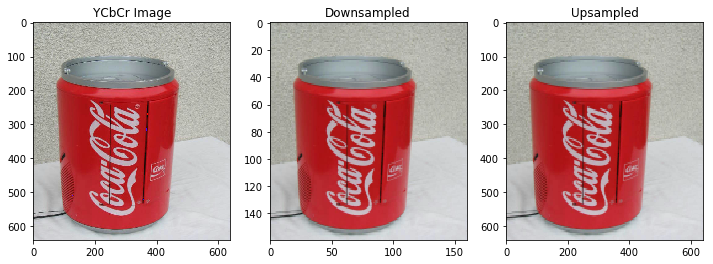

In [12]:
# downsample channels
y, cb, cr = ycbcr[:,:,0], ycbcr[:,:,1], ycbcr[:,:,2]
d_y, d_cb, d_cr = downsample(y, 4), downsample(cb, 4), downsample(cr, 4)
downsampled = np.zeros((len(d_y),len(d_y[0]),3))
downsampled[:,:,0], downsampled[:,:,1], downsampled[:,:,2] = d_y, d_cb, d_cr
downsampled_rgb = ycbcr2rgb(downsampled)

# upsample channels
u_y, u_cb, u_cr = upsample(d_y, 4), upsample(d_cb, 4), upsample(d_cr, 4)
upsampled = np.zeros((len(u_y),len(u_y[0]),3))
upsampled[:,:,0], upsampled[:,:,1], upsampled[:,:,2] = u_y, u_cb, u_cr
upsampled_rgb = ycbcr2rgb(upsampled)

f, axarr = plt.subplots(1,3, figsize=(12,4))
axarr[0].imshow(rgb,aspect="auto")
axarr[0].set_title("YCbCr Image")
axarr[1].imshow(downsampled_rgb,aspect="auto")
axarr[1].set_title("Downsampled")
axarr[2].imshow(upsampled_rgb,aspect="auto")
axarr[2].set_title("Upsampled")
plt.show()

## 1.3 Quantization
An important step in the JPEG compression is to quantize blocks of an image. To do so, a function, that quantizes a matrix M (8x8) using a given matrix Q (4x4), comes in handy. A quantization in this case is a block by component-wise division of the two mentioned matrices. Implement such a function by the name quanmat using the Q.

In [13]:
# quantize a matrix m
def quanmat(m):
    q = np.array([[8, 19, 26, 29],
                 [22, 26, 29, 34],
                 [26, 29, 35, 22],
                 [26, 38, 56, 69]])
    
    # get the matrix dimensions
    quantized = np.copy(m)
    mx,my = m.shape
    qx,qy = q.shape
    x,y = mx//qx, my//qy
    
    # divide each block of matrix m with the relevant element of q
    for i in range(0,qx):
        for j in range(0,qy):
            quantized[i*x:i*x+x,j*y:j*y+y] = np.divide(m[i*x:i*x+x,j*y:j*y+y], q[i,j])
            
    return quantized

## 1.4 DCT
The goal of this subtask is to treat the luminance channel Y of the image according to the JPEG pipeline. Use the method "blockproc" and a block-size of 8x8 pixels to first apply a blockwise discrete cosine transform to the Y channel and downsampled CbCr. Now follow up with the method quanmat from subtask 1.3 to quantize the resulting matrices. Lastly, apply the inverse discrete cosine transform. The result will be referred to as Y', Cb', Cr'.

Hint: Make sure to have two functions "dct_quant" that transforms Y to quantizded coefficient of DCT of Y and "idct_quant" that works complete opposite in one go, for later use. For the DCT you can use "dct2" and "idct2".

The following DCT equation is used to compute the i,j<sup>th</sup> entry of the DCT of a matrix representation of the image:

$$D_{i,j} = C_i C_j \sum_{x=0}^{N-1} \sum_{y=0}^{N-1} img(x,y) \cos(\frac{(2x+1)i\pi}{2N})\cos(\frac{(2y+1)j\pi}{2N})$$ $[eq. 1]$

$$C_u = \begin{cases}
       \frac{1}{\sqrt{N}} & \text{if }u=0, \\
       \sqrt{\frac{2}{N}} & \text{if }u > 0 \end{cases}$$

To perform DCT on an 8 x 8 block of image matrix $M$ we perform a matrix multiplication as follows:

$$D = TMT'$$ 

Where $T$ is the matrix form of $eq. 1$ for $N = 8$ and $M$ is the 8 x 8 block matrix representation of the image:

$$T_{i,j} = \begin{cases}
            \frac{1}{\sqrt{N}} & \text{if }i=0, \\
            \sqrt{\frac{2}{N}}\cos(\frac{(2j+1)i\pi}{2N}) & \text{if }i > 0\end{cases}$$

Since $T$ is orthogonal, $T^{-1}$, the inverse of $T$ is the same as $T'$.  
Therefore, to perform IDCT to get back to matrix $M$:

\begin{equation}\begin{aligned} T^{-1}D &= T^{-1}TMT'\\
                                T^{-1}D &= IMT' \\
                                T^{-1}D &= MT' \\
                                T^{-1}DT &= MT^{-1}T\\
                                T'DT &= M\\    
\end{aligned}                        
\end{equation}


Ref: <https://www.math.cuhk.edu.hk/~lmlui/dct.pdf> <br/>
Ref: <https://www.geeksforgeeks.org/discrete-cosine-transform-algorithm-program/>

In [14]:
# compute matrix T from the DCT equation to be used in dct2 and idct2 functions
def mat_t(mat):
    # mat must be square
    rows, cols = mat.shape
    block_size = rows
    matrix_t = np.zeros((rows,cols))
    
    for row in range(rows):
        for col in range(cols):
            if row == 0:
                matrix_t[row,col] = 1.0/sqrt(block_size)
            else:
                matrix_t[row,col] = sqrt(2.0/block_size) * cos((2*col + 1) * row * pi / (2 * block_size))
    return matrix_t

In [15]:
# define 2D dct and idct for 2D matrix m
def dct2(m):
    t_matrix = mat_t(m)
    return np.dot(np.dot(t_matrix, m), t_matrix.T)

In [16]:
# inverse of dct2 such that idct2(dct(m)) = m
def idct2(m):
    t_matrix = mat_t(m)
    idct_matrix = np.dot(np.dot(t_matrix.T, m), t_matrix)

    return idct_matrix

In [17]:
# transform a matrix m to quantizded coefficient of DCT of itself
def dct_quant(m):
    dct_out = blockproc(m,[8,8],dct2)
    # quantization
    out = blockproc(dct_out,[8,8],quanmat)
    return out

In [18]:
# inverse quantize a matrix m
def inv_quanmat(m):
    q = np.array([[8, 19, 26, 29],
                 [22, 26, 29, 34],
                 [26, 29, 35, 22],
                 [26, 38, 56, 69]])
    
    # get the matrix dimensions
    inv_quantized = np.copy(m)
    mx,my = m.shape
    qx,qy = q.shape
    x,y = mx//qx, my//qy
    
    # multiply each block of matrix m with the relevant element of q
    for i in range(0,qx):
        for j in range(0,qy):
            inv_quantized[i*x:i*x+x,j*y:j*y+y] = np.multiply(m[i*x:i*x+x,j*y:j*y+y], q[i,j])
            
    return inv_quantized

In [19]:
# inverse of dct_quant
def idct_quant(m):
    inv_out = blockproc(m,[8,8],inv_quanmat)
    # idct of inverse quantized m
    out = blockproc(inv_out,[8,8],idct2)
    return out

Applying a blockwise discrete cosine transform to the Y channel and downsampled CbCr:

In [20]:
# downsample chroma channels
y, cb, cr = ycbcr[:,:,0], ycbcr[:,:,1], ycbcr[:,:,2]
cb, cr = downsample(cb, 4), downsample(cr, 4)

# dct and quantization for all channels
y_dct = dct_quant(y)
cb_dct = dct_quant(cb)
cr_dct = dct_quant(cr)

# inverse quantization and idct for all channels
y_prime = idct_quant(y_dct)
cb_prime = idct_quant(cb_dct)
cr_prime = idct_quant(cr_dct)

[[172 166 160 162 172 186 199 205]
 [180 185 189 190 188 185 185 185]
 [167 177 188 190 181 169 165 165]
 [156 163 170 173 169 164 166 169]
 [178 177 178 178 178 176 174 173]
 [196 193 191 189 184 174 162 153]
 [194 195 194 190 181 171 162 156]
 [190 195 197 192 184 181 185 191]]
[[201 195 188 187 190 190 187 182]
 [185 180 179 185 195 199 194 187]
 [161 160 164 175 187 189 180 170]
 [164 170 179 187 190 186 176 168]
 [174 186 201 207 203 195 191 190]
 [153 166 180 186 185 182 184 188]
 [150 153 158 163 167 169 170 170]
 [185 178 171 172 179 182 177 172]]
[[184 181 180 185 192 197 197 195]
 [179 187 195 199 194 185 178 173]
 [180 192 205 206 195 181 176 176]
 [193 197 198 193 182 174 175 179]
 [195 188 180 172 169 166 164 163]
 [175 166 161 165 174 177 170 161]
 [165 158 155 162 176 182 175 165]
 [177 166 156 155 160 163 158 152]]
[[165 133 120 147 180 190 185 181]
 [171 171 164 162 180 201 195 173]
 [183 190 186 178 182 191 181 160]
 [183 164 160 178 189 181 170 169]
 [169 143 134 160

[[170 171 173 172 164 162 170 181]
 [183 181 186 191 177 161 166 183]
 [173 164 166 179 175 159 155 165]
 [174 166 164 175 187 189 181 172]
 [162 176 179 172 173 185 185 174]
 [145 172 184 166 145 146 154 157]
 [168 173 180 183 169 154 152 160]
 [190 158 153 187 202 179 158 158]]
[[198 187 170 156 159 170 177 176]
 [168 160 149 144 155 169 174 170]
 [156 152 144 143 153 164 164 157]
 [179 180 178 175 180 186 187 184]
 [145 155 160 157 157 163 171 175]
 [164 175 182 177 174 175 181 183]
 [173 180 185 184 183 182 176 169]
 [176 181 187 195 206 207 195 180]]
[[170 173 181 190 195 195 189 184]
 [171 179 186 184 175 170 173 179]
 [166 177 184 178 164 161 174 189]
 [152 157 159 155 148 147 156 164]
 [198 190 183 182 184 182 173 164]
 [182 171 163 168 178 176 159 141]
 [181 178 177 183 189 186 174 162]
 [192 196 199 198 190 181 174 170]]
[[182 197 205 196 183 177 180 182]
 [178 180 186 186 170 154 157 172]
 [186 178 182 193 183 163 166 187]
 [158 153 159 172 176 170 170 177]
 [158 165 170 176

[[191 191 183 170 167 177 183 182]
 [162 171 177 179 185 191 189 181]
 [171 171 169 169 178 189 193 190]
 [199 189 176 168 171 178 182 182]
 [201 196 190 188 184 177 169 163]
 [197 192 190 189 185 177 175 177]
 [188 186 187 188 183 176 180 189]
 [166 177 196 208 200 180 170 171]]
[[177 179 181 185 186 182 176 170]
 [169 177 188 198 199 190 176 165]
 [185 184 182 182 181 178 173 169]
 [180 174 167 164 166 172 177 179]
 [154 157 163 172 180 185 186 185]
 [176 173 171 173 178 184 189 190]
 [200 189 174 165 164 171 180 185]
 [176 173 170 169 171 172 171 170]]
[[201 202 197 187 180 176 169 161]
 [159 161 159 157 163 176 183 183]
 [156 152 145 140 149 167 181 185]
 [198 191 177 166 169 183 193 195]
 [193 188 177 171 178 191 198 197]
 [177 175 171 171 182 195 198 193]
 [197 195 191 192 201 211 209 200]
 [190 188 183 184 192 200 196 186]]
[[152 173 182 176 182 199 196 178]
 [183 189 196 201 207 212 211 207]
 [192 180 175 182 186 183 187 197]
 [208 192 179 178 181 186 195 205]
 [183 181 174 167

 [172 180 189 193 188 178 168 162]]
[[166 176 185 189 191 193 188 182]
 [177 182 185 186 193 201 204 200]
 [180 186 191 193 195 193 181 168]
 [205 200 188 177 175 177 172 165]
 [174 184 194 199 200 192 173 154]
 [139 160 185 198 197 182 156 134]
 [164 167 163 152 145 148 154 157]
 [147 165 181 182 174 166 158 152]]
[[169 186 187 167 158 172 186 188]
 [197 205 201 184 174 181 192 196]
 [159 172 188 197 196 190 184 182]
 [203 191 181 176 172 174 186 200]
 [161 154 150 151 151 152 162 174]
 [137 157 181 195 193 180 165 156]
 [160 170 169 150 133 129 129 125]
 [115 134 137 118 108 120 131 131]]
[[167 178 194 200 189 172 166 169]
 [179 171 168 175 183 187 189 193]
 [203 177 156 159 175 185 184 180]
 [184 166 155 164 180 186 181 175]
 [172 167 164 166 163 153 146 144]
 [148 146 145 140 127 114 111 116]
 [107 104 107 116 122 124 128 135]
 [138 127 123 131 139 136 127 121]]
[[168 169 172 175 179 181 182 183]
 [184 178 168 161 160 166 175 181]
 [198 187 170 154 147 148 154 160]
 [166 161 153 14

 [173 188 193 183 181 190 189 179]]
[[156 164 182 197 196 186 185 192]
 [190 174 167 179 194 196 189 183]
 [197 176 161 169 186 193 187 179]
 [170 170 171 173 174 176 180 185]
 [166 173 177 172 166 169 180 191]
 [190 185 174 166 169 181 191 193]
 [193 188 178 171 179 194 201 198]
 [172 183 189 186 187 197 204 205]]
[[185 181 173 169 180 195 196 187]
 [187 189 187 185 190 200 202 196]
 [188 192 194 190 188 190 189 186]
 [185 184 181 177 174 172 168 165]
 [182 173 165 167 174 176 173 169]
 [183 171 166 175 189 195 195 193]
 [190 182 180 190 197 197 195 196]
 [198 193 193 198 193 181 175 178]]
[[193 185 168 156 161 174 177 171]
 [186 187 183 179 183 188 184 174]
 [176 183 189 190 192 194 191 185]
 [172 177 181 182 182 186 192 195]
 [178 181 184 184 181 180 185 191]
 [184 188 196 200 194 183 177 177]
 [181 184 194 204 201 186 175 172]
 [172 171 180 193 195 185 177 177]]
[[171 180 187 189 191 194 191 184]
 [164 174 183 187 189 189 183 175]
 [164 175 184 188 189 188 180 171]
 [176 184 190 19

[[147 146 144 142 140 138 136 135]
 [134 134 135 136 137 139 140 140]
 [148 147 145 142 138 135 133 132]
 [128 129 131 134 136 139 141 142]
 [129 129 129 130 130 130 131 131]
 [136 136 134 132 130 129 127 126]
 [185 187 191 197 203 208 212 214]
 [182 180 175 169 163 157 152 150]]
[[130 132 133 127 117 109 106 106]
 [136 136 135 131 124 118 114 113]
 [123 123 125 128 132 134 133 132]
 [145 140 135 134 134 132 127 122]
 [128 125 124 127 133 137 136 134]
 [144 145 148 155 164 173 178 180]
 [201 200 196 190 184 180 179 179]
 [148 151 151 148 143 142 146 151]]
[[124 124 124 125 125 125 125 125]
 [103 109 117 122 123 123 123 124]
 [132 141 148 147 136 125 119 118]
 [165 174 180 175 159 145 139 139]
 [119 128 138 138 132 129 133 139]
 [198 203 207 205 200 199 203 209]
 [170 170 168 162 154 149 147 147]
 [136 137 138 138 138 137 136 135]]
[[120 119 118 118 119 121 123 125]
 [128 128 128 128 129 130 132 132]
 [134 134 134 134 133 131 130 129]
 [127 129 132 135 137 137 137 136]
 [178 181 186 192

[[77 76 77 77 78 79 80 82]
 [75 75 76 76 77 79 80 82]
 [75 75 75 74 76 77 78 80]
 [77 75 74 74 74 73 74 75]
 [78 77 74 73 71 70 71 71]
 [75 74 73 71 69 69 70 70]
 [69 68 68 69 70 72 73 74]
 [64 65 66 67 71 73 75 77]]
[[ 89  91  95  95  94  94  98 103]
 [ 85  86  89  89  89  91  95  99]
 [ 78  81  81  82  83  86  91  94]
 [ 75  76  76  79  81  84  89  91]
 [ 74  75  77  79  85  88  91  92]
 [ 73  75  78  83  90  94  93  92]
 [ 72  74  79  88  96  97  95  91]
 [ 70  73  80  89  98 100  94  90]]
[[ 85  83  88 100 110 115 122 128]
 [ 93  91  94 105 114 118 124 131]
 [100  99 104 112 119 122 129 135]
 [107 106 111 118 122 124 129 136]
 [108 108 113 119 121 122 128 137]
 [108 109 114 120 120 118 125 134]
 [106 109 114 118 119 118 124 135]
 [105 108 114 118 117 116 124 135]]
[[142 158 169 167 165 172 177 174]
 [146 165 177 176 172 176 177 171]
 [149 170 185 186 184 186 184 176]
 [148 170 186 187 188 193 192 185]
 [148 168 181 180 178 184 186 181]
 [151 168 179 174 169 172 171 165]
 [151 170 1

[[73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]
 [73 73 73 72 72 71 71 71]]
[[71 71 70 70 70 70 69 69]
 [72 72 71 71 70 70 69 69]
 [72 72 71 71 70 70 69 69]
 [72 72 71 71 70 70 69 69]
 [72 72 71 71 70 70 69 69]
 [72 72 71 71 70 70 69 69]
 [72 72 71 71 70 70 69 69]
 [72 72 71 71 70 70 69 69]]
[[68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]
 [68 68 68 68 68 68 68 68]]
[[68 68 66 66 66 66 66 66]
 [68 68 66 66 66 66 65 65]
 [68 68 66 66 66 66 65 65]
 [68 68 66 66 66 66 65 65]
 [68 68 66 66 66 66 65 65]
 [68 68 66 66 66 66 65 65]
 [68 68 66 66 66 66 65 65]
 [68 68 66 66 66 66 65 65]]
[[65 65 65 64 64 64 63 63]
 [65 65 65 64 64 64 63 63]
 [65 65 65 64 64 64 63 63]
 [65 65 65 64 64 64 63 63]
 [65 65 65 64 64 64 63 6

 [180 189 195 190 177 168 169 174]]
[[181 177 175 179 187 191 189 185]
 [187 185 183 183 185 186 184 182]
 [189 190 190 189 186 185 186 187]
 [181 186 191 191 187 187 192 197]
 [173 180 187 187 183 183 189 196]
 [176 182 186 184 179 177 182 187]
 [188 190 192 189 185 183 184 187]
 [198 199 199 198 195 194 194 195]]
[[184 185 181 174 175 182 188 188]
 [186 185 178 171 172 183 192 194]
 [189 186 176 166 165 175 185 187]
 [198 195 185 172 168 174 178 179]
 [203 202 195 184 179 181 181 179]
 [192 193 189 181 179 181 181 178]
 [189 189 184 175 173 177 179 177]
 [201 199 190 179 175 179 183 182]]
[[177 184 192 196 193 193 196 201]
 [192 193 192 193 192 192 193 193]
 [192 186 181 179 178 177 173 171]
 [180 178 177 174 169 165 162 162]
 [177 185 192 190 181 173 174 178]
 [181 192 202 199 188 180 185 193]
 [186 191 194 188 179 175 180 188]
 [192 189 183 175 169 169 173 179]]
[[195 191 187 190 193 191 182 173]
 [194 195 194 192 186 183 182 182]
 [185 190 193 187 176 173 180 190]
 [176 181 183 17

 [76 77 77 77 75 75 73 72]]
[[73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]
 [73 73 72 72 72 71 71 71]]
[[71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]]
[[71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]]
[[71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]]
[[71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 

 [72 72 72 72 72 72 72 72]]
[[72 72 72 72 72 72 72 72]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]]
[[70 70 70 70 70 70 70 70]
 [70 70 70 70 70 70 70 70]
 [70 70 70 70 70 70 70 70]
 [70 70 70 70 70 70 70 70]
 [71 71 71 71 71 71 71 71]
 [72 72 72 72 72 72 72 72]
 [72 72 72 72 72 72 72 72]
 [72 72 72 72 72 72 72 72]]
[[72 72 71 71 70 70 69 69]
 [71 71 70 70 69 69 68 68]
 [71 71 70 70 69 69 68 68]
 [71 71 70 70 69 69 68 68]
 [71 71 70 70 69 69 68 68]
 [71 71 70 70 69 69 68 68]
 [71 71 70 70 69 69 68 68]
 [71 71 70 70 69 69 68 68]]
[[70 70 70 70 70 70 70 70]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]
 [71 71 71 71 71 71 71 71]]
[[69 69 69 69 69 69 69 69]
 [69 69 69 69 69 69 69 69]
 [69 69 69 69 69 69 69 69]
 [69 69 69 69 69 69 69 

[[ 66  70  75  78  75  73  73  73]
 [ 70  73  76  78  77  76  75  76]
 [ 72  74  77  76  74  75  78  80]
 [ 74  75  74  73  72  75  80  84]
 [ 76  75  75  75  74  77  82  87]
 [ 81  82  82  82  80  83  89  94]
 [ 89  91  93  93  94  95 100 104]
 [ 98 100 101 102 103 105 109 112]]
[[ 77  79  84  85  88  89  93  95]
 [ 77  79  83  85  88  92  99 102]
 [ 81  83  84  86  91  96 106 111]
 [ 89  90  90  90  93 101 109 117]
 [ 99  99  97  95  97 102 112 118]
 [107 106 105 102 101 106 113 120]
 [112 111 110 108 106 111 116 121]
 [112 111 111 110 111 113 119 124]]
[[112 120 130 136 138 140 145 149]
 [113 121 130 135 138 140 145 149]
 [115 122 131 136 137 141 146 149]
 [117 124 132 137 137 141 147 150]
 [120 127 134 137 138 141 146 153]
 [122 129 135 138 139 142 147 154]
 [125 129 135 138 139 142 148 153]
 [126 130 135 138 139 142 148 154]]
[[164 183 199 206 208 209 210 209]
 [165 182 201 207 207 209 211 208]
 [166 184 201 206 207 210 211 209]
 [167 185 202 207 207 210 211 209]
 [169 186 202 208

 [121 119 118 116 113 111 109 107]]
[[103 103 104 103  99  97  95  96]
 [104 104 103 102  99  98  96  98]
 [106 104 102 101  99 100  99 100]
 [107 104 101 101 100 101 100 100]
 [108 103 100 100 101 102  99  97]
 [107 103  99 101 101 101  95  91]
 [106 102  99 101 102 100  91  84]
 [104 102 100 101 104 100  88  80]]
[[95 94 91 88 85 82 81 81]
 [96 95 93 90 85 81 78 78]
 [98 96 92 88 82 78 75 75]
 [99 94 87 80 74 73 73 75]
 [95 89 80 72 67 69 73 78]
 [86 82 75 70 68 71 76 81]
 [74 74 75 76 76 78 80 82]
 [66 70 76 82 85 85 83 82]]
[[81 81 80 81 80 77 76 75]
 [81 81 80 81 80 77 76 75]
 [81 81 80 81 80 78 76 75]
 [82 82 81 82 81 78 77 76]
 [82 82 82 82 81 79 77 76]
 [83 83 82 83 82 79 78 77]
 [83 83 82 83 82 80 78 77]
 [83 84 84 82 81 81 78 77]]
[[74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]
 [74 74 74 74 74 74 72 72]]
[[71 71 71 71 71 71 71 71]
 [71 

 [72 72 72 72 72 72 72 72]]
[[77 68 72 75 66 68 68 57]
 [77 68 72 75 66 68 68 57]
 [76 68 73 76 66 66 66 56]
 [76 68 73 76 67 66 65 54]
 [74 68 72 75 67 65 64 52]
 [74 67 72 76 67 64 63 49]
 [73 66 72 76 68 64 62 47]
 [74 66 73 76 68 64 61 47]]
[[30 18 12 20 36 52 64 73]
 [30 19 13 21 38 53 65 75]
 [29 18 12 21 38 54 65 75]
 [28 17 12 22 39 54 66 74]
 [27 18 13 24 41 55 68 75]
 [26 17 13 25 42 56 69 76]
 [25 17 14 27 43 57 69 76]
 [26 16 15 27 44 58 70 76]]
[[86 83 78 76 75 76 74 74]
 [86 83 78 76 75 76 74 74]
 [86 82 78 75 75 76 74 73]
 [86 82 78 75 75 76 74 73]
 [86 82 77 76 76 76 75 73]
 [86 82 77 76 76 76 75 73]
 [86 83 77 76 76 75 75 74]
 [86 82 77 76 76 76 75 74]]
[[ 74  71  73  76  70  74 119 169]
 [ 75  72  73  76  71  77 119 169]
 [ 75  72  73  76  71  80 122 167]
 [ 75  73  73  75  73  86 124 165]
 [ 75  74  73  74  76  91 127 164]
 [ 76  75  73  74  78  96 130 162]
 [ 77  75  74  74  80  99 133 160]
 [ 77  75  74  74  80 101 134 159]]
[[109  91  73  72  89 117 152 179]
 [ 96

 [86 86 86 86 86 86 86 86]]
[[84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]
 [84 84 84 84 84 84 84 84]]
[[83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]]
[[83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]]
[[83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [83 83 83 83 83 83 83 83]
 [84 84 84 84 84 84 84 84]]
[[81 81 81 81 81 81 81 81]
 [81 81 81 81 81 81 81 81]
 [81 81 81 81 81 81 81 81]
 [82 82 82 82 82 82 82 

[[196 185 181 169 156 157 154 133]
 [186 185 194 193 185 183 172 145]
 [179 181 188 187 180 182 171 141]
 [159 164 179 185 185 192 180 146]
 [ 91 108 134 154 166 183 173 137]
 [ 68  74  82  89 109 145 156 133]
 [ 97  90  84  78  96 145 169 153]
 [ 78  84  92  97 117 161 172 146]]
[[ 59  55 116 182 188 181 167 129]
 [ 55  53 116 181 186 181 171 138]
 [ 51  50 115 182 183 178 178 155]
 [ 47  47 115 182 181 177 185 170]
 [ 48  46 116 183 181 176 189 181]
 [ 52  48 116 185 182 175 189 184]
 [ 56  50 117 186 183 176 188 182]
 [ 60  52 117 188 186 175 186 180]]
[[ 94  82  73  78  82  80  82  88]
 [ 87  79  77  83  83  74  66  64]
 [ 91  82  76  77  80  77  76  75]
 [128 111  88  74  72  76  83  90]
 [174 156 130 107  91  83  77  73]
 [187 186 179 165 148 129 103  82]
 [183 189 193 193 188 178 157 137]
 [183 185 184 180 185 192 189 179]]
[[100 112 128 145 158 171 180 188]
 [ 71  75  82  87  92 101 110 116]
 [ 73  72  72  70  71  77  85  91]
 [ 79  77  76  74  74  77  80  83]
 [ 79  80  79  80

 [71 76 83 90 94 94 93 91]]
[[88 88 88 87 87 86 86 86]
 [88 88 88 87 87 86 86 86]
 [88 88 88 87 87 86 86 86]
 [88 88 88 87 87 86 86 86]
 [88 88 88 87 87 86 86 86]
 [88 88 88 87 87 86 86 86]
 [88 88 88 87 87 86 86 86]
 [88 88 88 87 88 87 87 87]]
[[86 86 86 86 86 86 86 86]
 [86 86 86 86 86 86 86 86]
 [87 87 87 87 87 87 87 87]
 [87 87 87 87 87 87 87 87]
 [87 87 87 87 87 87 87 87]
 [87 87 87 87 87 87 87 87]
 [87 87 87 87 87 87 87 87]
 [87 87 87 87 87 87 87 87]]
[[86 86 86 87 87 88 88 88]
 [86 86 86 87 87 88 88 88]
 [86 87 87 87 88 88 89 89]
 [86 86 86 87 87 88 88 88]
 [85 85 86 86 87 87 87 88]
 [85 85 85 86 86 87 87 87]
 [84 85 85 85 86 86 87 87]
 [84 84 85 85 86 86 86 87]]
[[89 89 88 87 87 86 85 85]
 [89 88 88 87 87 86 86 85]
 [88 88 88 87 87 86 86 86]
 [87 87 87 87 87 87 87 87]
 [87 87 87 87 87 87 87 87]
 [86 86 86 87 87 88 88 88]
 [85 86 86 87 87 88 88 89]
 [85 85 86 87 87 88 89 89]]
[[88 88 88 88 88 88 88 88]
 [88 88 88 88 88 88 88 88]
 [88 88 88 88 88 88 88 88]
 [88 88 88 88 88 88 88 

 [220 220 220 219 219 219 219 219]]
[[216 217 217 217 218 218 219 219]
 [218 218 218 218 219 219 220 220]
 [219 219 220 220 221 221 221 222]
 [220 221 221 221 222 222 223 223]
 [221 221 222 222 222 223 223 223]
 [221 221 221 222 222 223 223 223]
 [220 220 220 221 221 222 222 222]
 [219 219 220 220 221 221 221 222]]
[[219 219 219 219 219 219 219 219]
 [220 220 220 220 220 220 220 220]
 [222 222 222 222 222 222 222 222]
 [223 223 223 223 223 223 223 223]
 [224 224 224 224 224 224 224 224]
 [223 223 223 223 223 223 223 223]
 [222 222 222 222 222 222 222 222]
 [222 222 222 222 222 222 222 222]]
[[219 219 218 218 217 217 217 216]
 [220 220 219 219 218 218 218 218]
 [222 221 221 221 220 220 219 219]
 [223 223 222 222 221 221 221 220]
 [223 223 223 222 222 222 221 221]
 [223 223 223 222 222 221 221 221]
 [222 222 222 221 221 220 220 220]
 [222 221 221 221 220 220 219 219]]
[[217 216 216 214 213 212 211 211]
 [218 217 217 216 214 213 213 212]
 [219 219 218 217 217 216 215 215]
 [221 220 220 21

 [186 187 188 188 188 187 187 186]]
[[131 133 135 137 138 137 136 135]
 [142 141 138 137 135 135 136 137]
 [155 153 146 141 137 137 136 138]
 [168 166 160 154 149 145 141 140]
 [177 176 174 170 165 158 150 146]
 [181 182 184 182 177 170 162 158]
 [182 183 185 185 183 179 174 171]
 [184 183 184 184 183 182 181 181]]
[[141 139 137 137 137 141 144 147]
 [135 135 136 136 138 139 140 141]
 [132 135 137 139 138 138 136 135]
 [135 136 137 138 137 137 137 137]
 [140 138 136 133 133 135 138 140]
 [150 146 141 137 135 134 136 138]
 [168 166 159 152 145 140 137 135]
 [185 181 176 168 159 149 141 136]]
[[146 147 147 147 149 150 151 150]
 [142 142 144 146 148 149 150 151]
 [134 134 136 138 141 142 145 146]
 [135 135 136 138 140 141 143 144]
 [143 144 144 143 143 143 145 145]
 [140 139 140 140 139 139 137 137]
 [135 135 135 135 135 135 135 135]
 [137 137 138 140 141 142 143 142]]
[[132 117  95  76  64  62  67  73]
 [144 143 137 132 125 117 111 108]
 [146 150 157 161 160 152 143 137]
 [140 142 145 14

 [208 207 207 205 204 203 202 202]]
[[200 200 201 202 203 205 207 209]
 [203 203 203 204 205 207 208 209]
 [203 203 202 202 203 204 206 206]
 [200 199 199 198 198 199 200 201]
 [200 200 199 199 199 200 201 201]
 [202 202 202 202 202 204 205 206]
 [202 202 202 202 204 205 207 208]
 [198 198 199 200 201 204 206 207]]
[[207 208 208 209 210 211 212 212]
 [206 207 207 208 209 210 211 211]
 [205 205 206 207 208 209 209 210]
 [203 204 204 205 206 207 208 208]
 [203 203 204 205 206 207 207 208]
 [203 204 204 205 206 207 208 208]
 [204 204 205 206 207 208 208 209]
 [205 205 206 207 208 208 209 210]]
[[214 214 213 213 212 211 211 210]
 [213 213 212 212 211 210 210 210]
 [211 211 211 210 210 210 209 209]
 [210 210 210 209 209 209 209 209]
 [209 209 209 209 209 210 210 210]
 [209 209 210 210 210 211 211 211]
 [210 210 210 211 212 212 213 213]
 [210 211 211 212 213 213 214 214]]
[[209 209 209 209 209 209 209 209]
 [210 210 210 210 210 210 210 210]
 [210 210 210 210 210 210 210 210]
 [210 210 210 21

[[ 1.39600000e+03 -2.83343122e+01  6.86625468e+00  9.60651179e+00
  -1.47500000e+01 -2.16310513e-02 -4.08713362e-01  7.88423997e-02]
 [ 7.83853081e+00 -4.81765997e+01  9.29580067e+00 -8.18804086e-02
   1.62514037e+01 -1.31378846e-01  1.07046903e-01 -8.52310480e-02]
 [-8.58386410e+00 -1.60292511e+01  9.64797077e+00  1.35737088e-01
   1.03144611e-15  3.60212895e+01  1.25000000e-01  2.91767736e-01]
 [-2.68763426e+01  1.08996674e+01 -1.41240347e+01 -1.84658287e+01
  -8.80081135e-02  2.22379576e-01 -2.10116410e-01  4.53265989e-01]
 [-1.20000000e+01  1.32699292e-01 -3.66268908e-01 -2.71591850e-01
   2.50000000e-01  1.81471873e-01  4.22311599e-01 -2.63955304e-02]
 [ 5.08228289e-03  2.21836658e+01  1.61861196e-01  2.95602881e-01
   5.06279110e-02 -8.15220336e-03  1.76872981e-01  5.23143187e-01]
 [ 3.08859560e+01  9.34978121e-02 -1.25000000e-01 -3.73885122e-01
   9.76996262e-15 -1.60283444e-01  1.02029227e-01 -4.51267157e-02]
 [-4.62962700e+01 -5.12007743e-01 -7.98534272e-01  7.90301003e-03
   

  -1.91173342e-01  2.64424236e-01  3.36719411e-01 -5.07622206e-01]]
[[ 1.42425000e+03 -4.16572582e+01 -1.16537804e+01 -1.97321697e+01
  -1.45000000e+01 -5.09209887e-01 -4.36109984e-02 -4.24294169e-01]
 [ 2.43971125e+01  3.21437208e+01 -2.74433345e-01 -1.11927869e+01
  -1.32699292e-01  3.51149827e-01  3.85291927e-01  4.13106762e-02]
 [-4.52576654e+01 -5.59997095e+01  9.77297077e+00  1.51507511e+01
   3.66268908e-01 -5.73012313e-01  1.76776695e-01  1.45951518e-01]
 [ 3.02858529e-01  3.29437681e+01 -2.25974740e-01 -3.79479060e+01
   2.71591850e-01  1.84514891e-01 -1.84823644e-01 -8.61689992e-02]
 [-1.20000000e+01  1.36331318e+01 -2.40565132e+01 -1.03291072e-01
   2.50000000e-01 -4.47070185e-01 -5.88789930e-01  2.28420948e-01]
 [-1.90799249e-01 -2.16772870e+01  3.53867539e+01  4.07855430e+01
  -1.81471873e-01  1.96120320e-01  3.98374036e-01 -1.73241214e-01]
 [ 3.11938491e+01  1.25317404e-01  1.76776695e-01 -1.27388779e-01
  -4.22311599e-01 -5.54537206e-01  2.27029227e-01 -2.19530420e-01]
 

[[ 1.38637500e+03 -5.92340533e-01 -1.79904458e+01 -1.98709392e+01
   1.25000000e-01  2.91233644e-01  1.04402771e-02 -1.50302169e-01]
 [ 4.02085382e+01  1.64607203e+01 -5.96335582e-01 -1.21673251e+01
   1.68924914e+01 -3.25566062e-01 -2.66469409e-01  1.44814083e-01]
 [ 1.75285061e+01  4.81314799e+01  9.91313582e+00 -3.01489065e+01
  -2.58991229e-01  3.57423690e-02 -2.65165043e-01  1.72919112e-01]
 [ 1.81308592e-01 -2.15885188e+01 -1.40099999e+01  1.87823411e+01
  -3.33188228e+01 -4.03805312e-01 -2.79322922e-01  4.45370257e-01]
 [ 2.41250000e+01 -1.41694555e+01  6.76495125e-02  2.21705206e-01
  -1.25000000e-01  4.01649375e-01 -1.63320371e-01  2.80275330e-01]
 [-1.03218865e-01 -2.90012019e-02  4.16330962e-02 -1.53805312e-01
   1.77315296e-01 -2.21680899e-01 -2.20338596e-01  7.98413018e-01]
 [ 1.80901439e-01  1.04522933e-01 -2.65165043e-01  1.66173291e-01
  -2.98619396e-01 -3.40046713e-01 -1.63135816e-01 -3.06157818e-01]
 [ 4.56581584e+01 -1.05185917e-01  2.83396334e-01  4.38634258e-01
   

[[ 1.41587500e+03 -3.46071325e+01 -1.63320371e-01  8.48984490e-02
   3.75000000e-01 -7.40738551e-02 -6.76495125e-02 -1.45556232e-01]
 [-2.42273036e+01 -4.02311591e+01 -2.18439970e-01  1.19022268e+01
   1.67186715e-01 -4.44730972e-02 -2.61762425e-01 -1.25315730e-02]
 [ 3.59019770e+01  7.73151182e+00  9.78813582e+00  5.21167471e-01
   6.76495125e-02  3.95893362e-01  1.40165043e-01  1.65328744e-01]
 [ 1.86227073e-01 -1.05459300e+01  1.38487303e+01  1.91300998e+01
  -3.69803720e-01  4.21386848e-01  2.00136331e-01 -1.29345993e-01]
 [-1.18750000e+01  1.47992510e+01  1.63320371e-01  4.41400706e-01
   6.25000000e-01  1.03695132e-01  6.76495125e-02 -4.62690071e-01]
 [-1.47411511e+01 -2.21739549e+01  1.28395113e-01  5.98163543e-01
   3.28456323e-01 -1.08391685e-01 -1.77759281e-01  7.37084373e-03]
 [-3.12422678e+01 -1.56614148e-01  3.90165043e-01 -8.63251752e-02
  -1.63320371e-01 -3.79390576e-02 -2.88135816e-01 -5.99687353e-01]
 [-1.18508192e-01  1.64245122e-01  2.61019284e-01 -8.82776169e-03
  -

  -3.81074231e-03 -3.04238362e-01  4.03624434e-01  1.81303018e-01]]
[[ 1.43625000e+03 -4.18788853e+01  1.78271255e+01 -1.03512104e+01
   3.00000000e+01 -3.48825652e-01 -7.80897896e-02  1.21380646e-01]
 [ 4.82601801e+01  4.42065630e-01 -1.78653362e+01  2.42511278e+01
  -1.62404703e+01 -7.65856365e-02 -2.42354825e-01 -5.03417437e-01]
 [-1.78158603e+01 -7.74208438e+00 -2.06798250e+01  2.37104428e-01
   2.30969883e-01  3.54851853e-01 -7.32233047e-02  2.34583098e-01]
 [-2.65339918e+01  1.08572218e+01  4.94392893e-02 -1.84238611e+01
  -3.50103743e-01 -3.12075720e-01  4.18844471e-01 -2.62323078e-01]
 [ 1.15000000e+01  1.40286644e+01 -2.30969883e-01  3.29570387e-01
   2.50000000e-01 -4.58513848e-01  9.56708581e-02  5.21994732e-02]
 [ 3.01017470e+01  3.31383579e-02  3.92180770e-01  4.14776703e-02
  -7.06308640e-01  2.31472987e-01 -3.01231061e-01 -5.49632481e-01]
 [ 3.14627974e+01  1.42851581e-02  4.26776695e-01  2.37688926e-01
  -9.56708581e-02  1.05376097e-01  1.79825023e-01  7.18163394e-02]
 

[[ 1.44012500e+03 -7.50687858e+00  1.70105236e+01  6.30599327e-01
  -1.36250000e+01 -1.45461146e-02 -4.16337352e-01  6.60610961e-01]
 [ 1.63644262e+01  3.19657386e+01 -1.40235253e+00  1.17278329e+01
  -5.09928196e-01  8.18629369e-01  2.42103575e-01  3.67901434e-01]
 [-4.40464316e+01  2.36166200e+01  2.01861066e+01 -9.09840038e-01
  -5.29589279e-01  6.51968137e-01  1.61611652e-01 -5.85695981e-01]
 [ 9.64255264e+00  1.08597145e+01 -4.14933998e+01  5.88477827e-01
   2.99886007e-01 -8.72059678e-01  3.72339326e-01  4.03718037e-01]
 [ 2.38750000e+01  1.37893851e+01 -6.64888304e-01 -3.49829357e-02
   1.25000000e-01  5.37066867e-01  6.81302828e-01 -2.63204091e-02]
 [-2.19007818e-01  3.34662979e-02 -1.19786755e-01  5.85047103e-01
   2.26171041e-01 -4.98380403e-01 -2.92821644e-01  2.76083509e-01]
 [-8.32533179e-01 -7.48072907e-02 -3.38388348e-01  4.11500638e-01
   3.54662087e-01 -2.35348961e-01  5.63893411e-01  2.32448968e-01]
 [ 4.91192866e-01  3.25008215e-01  4.96514135e-01  2.65001576e-01
   

[[ 1.13212500e+03  7.07495999e+00  5.50845673e+00 -1.68777003e-01
  -1.25000000e-01 -2.26631725e-01  5.59602040e-01  2.29332701e-01]
 [ 5.51797116e+01  5.64257358e-02 -6.10620740e-01  2.69880881e-01
   1.93582245e-01 -4.83603353e-01 -2.00136331e-01 -1.65552919e-01]
 [ 1.77707411e+01  7.96242298e+00  3.38388348e-01  1.93153319e-01
   6.25260137e-01 -4.56823177e-01  3.90165043e-01  4.47398240e-02]
 [ 6.83368584e+00 -5.90881033e-01  2.61019284e-01  4.92193660e-01
  -1.88331848e-01  1.52096594e-01 -4.22184943e-02  5.23839953e-02]
 [-1.87500000e+00 -3.38668069e-01  3.94290254e-01 -5.73652643e-01
  -1.25000000e-01 -3.21031140e-01 -2.80213456e-02 -3.75054118e-01]
 [ 3.47857715e-01 -2.19089857e+01 -2.18439970e-01  7.88732892e-02
   6.00048173e-01 -6.54169645e-02  1.34513258e-01 -2.37327642e-01]
 [ 3.14699382e+01 -4.06752725e+01  1.40165043e-01  3.58646656e-01
  -1.23692204e-01  1.78020238e-01  1.61611652e-01 -2.97846677e-01]
 [-1.25166334e+00  2.61223777e-01  2.11579995e-01  1.30049962e-01
  -

   1.06303762e-01  6.47447553e-01  1.38892558e-01 -8.78417437e-01]]
[[ 1.19375000e+03  1.37508792e+01 -9.56708581e-02 -1.60822253e-01
   4.69198759e-14 -3.60968687e-01 -2.30969883e-01 -3.63535333e-01]
 [-8.25603106e+00 -1.05969883e-01  6.08829528e-02 -1.29583619e-14
  -1.32699292e-01 -1.76776695e-01 -1.99775511e-01 -1.70942766e-01]
 [-2.30969883e-01  8.32600029e-02 -7.32233047e-02  2.92370250e-02
  -9.56708581e-02  4.93744412e-01 -4.26776695e-01  4.18576301e-01]
 [-1.61854106e-01 -1.76776695e-01 -3.28456323e-01  2.93291419e-02
   2.71591850e-01  6.10747764e-02 -8.32600029e-02 -6.56005809e-15]
 [-5.00000000e-01  2.71591850e-01  6.92909649e-01 -2.63955304e-02
  -7.50000000e-01  1.32699292e-01 -2.87012574e-01  1.81471873e-01]
 [-4.19503966e-01  7.60490611e-15  3.69803720e-01  1.81815575e-02
  -1.81471873e-01  2.20670858e-01  4.18576301e-01  1.76776695e-01]
 [ 9.56708581e-02  2.59481478e-01  7.32233047e-02 -4.06806885e-02
  -2.30969883e-01 -6.08829528e-02 -4.26776695e-01  2.30437589e-02]
 

  -3.15544362e-30 -2.52435490e-29  1.49883572e-29  0.00000000e+00]]
[[ 1.40300000e+03 -2.28701607e+00  5.41196100e-01 -1.68567118e+00
   1.00000000e+00  1.77722049e+00 -1.30656296e+00 -8.77244266e-01]
 [ 4.74167923e-14 -1.50814721e-14  3.56885725e-15 -1.11159704e-14
   6.59438833e-15  1.17196820e-14 -8.61598356e-15 -5.78488935e-15]
 [-1.27255994e-13  1.99290881e-14 -4.71598993e-15  1.46889608e-14
  -8.71401315e-15 -1.54867227e-14  1.13854069e-14  7.64431807e-15]
 [ 5.60915531e-14 -4.21922135e-15  9.98430301e-16 -3.10982504e-15
   1.84485864e-15  3.27872057e-15 -2.41042397e-15 -1.61839166e-15]
 [ 4.35700657e-14 -3.05220268e-15  7.22268728e-16 -2.24966067e-15
   1.33457859e-15  2.37184041e-15 -1.74371096e-15 -1.17075142e-15]
 [ 4.13444597e-13  2.96243201e-15 -7.01025530e-16  2.18349418e-15
  -1.29532628e-15 -2.30208040e-15  1.69242534e-15  1.13631755e-15]
 [-2.98945604e-13 -1.72359681e-14  4.07869399e-15 -1.27039661e-14
   7.53644380e-15  1.33939223e-14 -9.84683836e-15 -6.61130211e-15]
 

[[ 1.11600000e+03  1.35258852e+01 -2.30969883e-01 -2.88271148e-01
  -2.50000000e-01  2.79760175e-01  9.56708581e-02 -5.13871555e-01]
 [-1.56670716e-01 -7.85083453e+00  7.51681109e-02  2.07388351e-02
   3.46759961e-01  1.45738835e-01 -3.31808094e-01  2.57282510e-01]
 [ 1.77314546e+01  1.46984450e-01 -3.75000000e-01 -3.32474803e-01
   1.35299025e-01 -1.40791184e-01 -5.17766953e-02  9.82118698e-02]
 [ 8.96048437e+00  1.26708718e-01 -5.08029570e-01 -1.22281460e-01
   2.93968901e-01 -1.07418465e-01 -3.20364431e-01  2.51708718e-01]
 [ 5.21999407e-14  1.49825945e-01 -3.96281669e-02 -1.92915536e-01
   2.50000000e-01 -7.04453309e-01  5.57610624e-01  2.62833250e-01]
 [-2.96697968e-01 -7.49320230e-02  1.01053364e-01  5.69358231e-01
   1.96423740e-01  4.38145452e-01  6.37244474e-02  1.99932023e-01]
 [-3.09059673e-01  5.51275593e-01 -3.01776695e-01  3.44874224e-02
  -3.26640741e-01 -1.73379981e-01 -3.75000000e-01 -5.68644726e-02]
 [-3.11680051e-01 -6.59407943e-02  1.12497028e-01  2.81037860e-01
   

[[ 1.48150000e+03 -3.49653513e+01 -1.20596775e+01 -9.43779490e+00
   2.50000000e-01  3.34454432e-01  9.36311225e-01 -6.04462840e-01]
 [-1.61400536e+01  8.35365195e+00 -1.79676215e+01 -1.30737733e+01
  -1.47168820e+00  8.01831800e-01  8.15573624e-01 -1.83658284e-01]
 [-9.52415816e+00  8.08265108e+00 -2.01494949e+01  8.64614038e-01
   2.87012574e-01  6.08030496e-01 -5.55728104e-15 -6.92950097e-02]
 [ 9.36419810e+00  1.07942975e+01 -1.44779437e+01  4.02077115e-02
   4.13560020e-01  8.36939766e-01 -2.58270440e-01 -1.60592348e-01]
 [-1.27500000e+01 -1.38985304e+01  2.32679327e+01  6.46474773e-01
  -5.00000000e-01  8.41264391e-02  6.44832621e-01 -1.75629888e-01]
 [-1.52447888e+01 -2.25170772e+01  1.30035295e+00  8.69397663e-02
   1.45314543e-03  6.74258383e-01  5.39940021e-01 -2.16110151e-01]
 [ 2.99224483e+01  4.15601701e+01 -2.48689958e-14 -1.48696559e-02
   6.92909649e-01  3.21292096e-01 -3.50505063e-01  6.68954086e-01]
 [-5.30921443e-01  5.66341716e-01 -7.02737494e-01  2.08575840e-01
   

[[ 1.46725000e+03 -1.41228627e-04  6.13371687e+00  1.01180014e+01
   1.50000000e+01 -3.99493527e-01  4.35909836e-01 -3.02411173e-01]
 [ 2.26125182e+01  7.28251044e-03 -8.82159181e+00  1.19434538e+01
  -1.38892558e-01  2.27803441e-01  3.26357970e-01  3.66116524e-02]
 [ 3.71521556e+01  1.61329895e+01 -4.01007666e+01 -2.98958561e+01
   3.26640741e-01 -4.69194455e-01 -3.75000000e-01 -3.56380289e-02]
 [-2.80382273e+01  2.22322852e+01 -1.36797296e+01 -1.42581535e-01
  -2.45196320e-01 -2.13388348e-01  6.64837310e-02  1.47360279e-01]
 [ 1.25000000e+00  2.18800790e-01  2.38651715e+01 -3.89339276e-01
   5.87377807e-15 -4.10484409e-01  1.26850164e-01 -8.39267117e-02]
 [-1.02768188e+00  1.43377447e-01 -2.59556599e-01  2.13388348e-01
   4.87725805e-02  3.19358231e-01 -2.05443297e-01  9.53534065e-02]
 [ 8.46956287e-01  4.08934694e+01  3.75000000e-01 -4.20688165e-01
   1.35299025e-01 -4.85695815e-01 -1.49233431e-01 -2.33029037e-01]
 [-3.17332240e-01 -3.66116524e-02  8.88305652e-02 -9.08716373e-02
  -

  -7.80590668e-01 -2.61373704e-01 -6.81037478e-02  3.03544436e-01]]
[[ 1.43400000e+03 -6.52122716e+00  2.38651715e+01 -2.01069636e+01
  -1.47500000e+01  1.85114406e-01  1.26850164e-01  1.56022148e-01]
 [ 1.59672211e+01  1.95222930e-01  9.01734884e+00 -1.17007363e+01
  -1.70046295e+01 -3.67968484e-01 -6.07680158e-01 -1.92649513e-01]
 [-5.57610624e-01 -4.94392893e-02  9.87652416e+00  1.50646496e+01
   2.30969883e-01 -5.15481132e-01 -4.26776695e-01  3.92180770e-01]
 [ 8.75532042e+00 -2.26224503e+01  1.38809333e+01 -1.89846291e+01
  -2.00710390e-01  2.88320371e-01 -1.70888867e-01 -5.39941814e-01]
 [-1.17500000e+01 -4.25793145e-02 -6.92909649e-01  3.77895612e-01
  -8.37314129e-15 -2.23770501e-02  2.87012574e-01  4.79459254e-01]
 [-1.51320893e+01 -7.40192165e-02  3.49356639e+01  3.83203706e-02
   4.20072742e-01  1.88687520e-01 -1.75804087e-01  2.94811636e-01]
 [-3.96281669e-02 -4.66638877e-01  7.32233047e-02 -3.12272539e-01
  -9.56708581e-02 -2.42354825e-01 -3.76524164e-01 -1.01782995e-01]
 

  -4.87725805e-02  8.57678601e-01 -4.87725805e-02  3.92581535e-01]]
[[ 7.21000000e+02  6.91653188e+00 -9.01834461e-14 -5.29822122e-01
   5.02622151e-14 -2.29473220e-01 -1.49410532e-13  7.60406030e-01]
 [ 1.11981937e+02 -1.23255038e-16  1.87665139e-01  2.40469399e-15
  -3.46759961e-01  3.96478499e-14 -4.53063723e-01 -2.77201267e-14]
 [ 5.41196100e-01  2.86543717e-01  2.49083468e-15  5.80512618e-01
  -5.79149744e-15  5.50608884e-01  3.26525512e-15 -7.47032624e-01]
 [-5.28622021e+00  8.09029188e-15  1.59094823e-01 -4.48981051e-15
  -2.93968901e-01 -6.13996207e-16 -3.84088878e-01 -8.38169634e-17]
 [ 1.10000000e+01  2.19311067e-01  9.45134226e-16  4.44305122e-01
  -1.68396625e-15  4.21417795e-01 -2.64171463e-15 -5.71754017e-01]
 [ 1.49709737e+01  6.94442618e-15  1.06303762e-01  1.71517035e-15
  -1.96423740e-01  5.01662262e-15 -2.56639984e-01 -1.91360286e-16]
 [-1.30656296e+00  1.18690294e-01 -8.40993941e-15  2.40456199e-01
   5.13478149e-15  2.28069667e-01 -7.07767178e-15 -3.09431044e-01]
 

  -1.77635684e-15 -1.42108547e-14  9.32587341e-15  3.55271368e-15]]
[[ 5.71125000e+02  1.46984450e-01  6.76495125e-02 -3.44874224e-02
  -1.25000000e-01 -1.73379981e-01 -1.63320371e-01 -9.82118698e-02]
 [-8.10492004e+00 -2.03873289e-01 -9.38325694e-02  4.78354290e-02
   1.73379981e-01  2.40484942e-01  2.26531862e-01  1.36223777e-01]
 [ 1.63288791e+01  1.92044439e-01  8.83883476e-02 -4.50599889e-02
  -1.63320371e-01 -2.26531862e-01 -2.13388348e-01 -1.28319992e-01]
 [ 1.87233385e+01 -1.72835429e-01 -7.95474113e-02  4.05529186e-02
   1.46984450e-01  2.03873289e-01  1.92044439e-01  1.15484942e-01]
 [-3.68750000e+01  1.46984450e-01  6.76495125e-02 -3.44874224e-02
  -1.25000000e-01 -1.73379981e-01 -1.63320371e-01 -9.82118698e-02]
 [ 8.96334943e-01 -1.15484942e-01 -5.31518809e-02  2.70965939e-02
   9.82118698e-02  1.36223777e-01  1.28319992e-01  7.71645710e-02]
 [ 3.12553829e+01  7.95474113e-02  3.66116524e-02 -1.86644585e-02
  -6.76495125e-02 -9.38325694e-02 -8.83883476e-02 -5.31518809e-02]
 

[[ 5.60000000e+02  5.83065086e-14 -5.63712938e-14  3.68730965e-14
   2.63052785e-14  1.70589666e-13 -1.12458783e-13 -5.08496600e-14]
 [-5.02429587e-15 -5.91645679e-31  3.94430453e-31 -2.95822839e-31
  -1.97215226e-31 -1.57772181e-30  9.36772325e-31  4.43734259e-31]
 [-7.66205120e-14 -6.70531769e-30  6.60671008e-30 -4.09221595e-30
  -2.85962078e-30 -2.38137386e-29  1.37680880e-29  6.69299174e-30]
 [ 3.83102560e-14  3.35265885e-30 -3.30335504e-30  2.04610797e-30
   1.42981039e-30  1.19068693e-29 -6.88404399e-30 -3.34649587e-30]
 [ 2.38654054e-14  3.94430453e-31 -1.28189897e-30  2.21867130e-30
   6.90253292e-31  7.34626718e-30 -4.37571283e-30 -1.98447821e-30]
 [ 1.78990540e-13  2.54407642e-29 -2.30248777e-29  1.15124388e-29
   6.95183673e-30  5.68719409e-29 -3.50858214e-29 -1.45877638e-29]
 [-1.20583101e-13 -7.88860905e-30  1.41994963e-29 -4.73316543e-30
  -3.15544362e-30 -3.47098798e-29  2.36658272e-29  6.31088724e-30]
 [-4.01943669e-14 -1.57772181e-30  3.54987407e-30 -2.36658272e-30
  -

[[ 1.17975000e+03 -7.65318076e+01 -5.05812379e+00 -2.06816340e+01
   2.50000000e-01 -3.46611906e-01  2.00957122e-01  8.84477027e-01]
 [ 3.27718381e+02  5.59026989e+01 -1.01341852e+01  1.26053256e+01
  -5.19353505e-01 -4.43103394e-01  3.88133422e-01  1.74927192e-01]
 [-1.52653995e+02  4.04297153e+01  2.07833784e+01 -9.56632642e-01
  -1.51772557e-14 -5.20752013e-01  4.26776695e-01  1.67326215e-03]
 [ 1.79746379e+01 -7.63301299e+01 -3.84402854e-01 -1.73799449e-01
   1.48189994e+00 -8.84251366e-01 -2.56956312e-01 -1.89720273e-01]
 [ 2.32500000e+01  4.27074205e+01 -2.36342016e+01  8.42291919e-01
   2.50000000e-01  3.41342973e-01 -2.22521022e-01  1.62527160e-02]
 [-1.54316558e+01  5.36813033e-02  3.59178272e+01 -8.84251366e-01
  -5.49666016e-01  1.09663498e+00  2.49073572e-01  5.60743075e-01]
 [-8.85886884e-02 -4.12954383e+01 -7.32233047e-02 -6.04189691e-01
  -1.77635684e-14  2.70313071e-01 -7.83378413e-01  2.12140648e-02]
 [-2.53051143e-01  1.74927192e-01 -2.12665019e-01 -4.47769571e-01
  -

  -5.06646591e-15 -7.49320230e-02 -2.63955304e-02 -3.66116524e-02]]
[[ 6.35000000e+02  6.97312019e+00  5.00208109e+00 -1.75982220e+00
  -1.00000000e+00  5.24984587e-01 -9.89537629e-01 -5.48797987e-02]
 [ 5.49532361e-14 -6.28752465e-15  1.19324238e-14 -1.54670497e-14
   5.96635134e-15  1.42181967e-14 -1.14005039e-14 -6.69746847e-15]
 [-5.94279996e-14  7.33239495e-15  8.03523500e-15  1.13582825e-15
   1.17756934e-15  7.53313435e-18 -4.60289519e-15 -3.02721487e-15]
 [ 3.59943696e-14 -1.24244678e-17 -5.55557143e-17 -7.76837001e-15
  -1.84485864e-15  3.98985698e-15  2.01987253e-15  2.46011835e-15]
 [ 2.47289562e-14 -1.33834819e-15  3.92686490e-16 -3.99770651e-15
  -7.85046229e-17  2.62008414e-15 -7.76832785e-17  3.70794729e-16]
 [ 1.87351283e-13  7.13179898e-16 -8.76125578e-16 -1.67314755e-15
  -1.21682166e-15  3.25943169e-16  1.67998137e-15  1.47914089e-15]
 [-1.14302731e-13 -4.59665819e-15 -3.96206179e-15  5.27067972e-15
   1.25607397e-15 -2.70418834e-15  2.81575062e-16 -7.58959392e-16]
 

  -3.77895612e-01  4.25122293e-01  4.93744412e-01  1.32814925e-01]]
[[ 1.52662500e+03 -6.61096288e+00 -2.43947607e+01 -4.28429676e-01
   1.25000000e-01 -3.22745242e-01  2.27811923e-01 -2.64486832e-01]
 [ 1.63972191e+01 -2.31719944e+01 -8.74204440e+00  2.43124196e+01
  -8.09189205e-03  2.87591509e-01 -5.59206392e-01 -3.83066477e-01]
 [-8.14479630e+00 -1.55304607e+01  9.61135912e+00 -1.53237703e+01
   5.85631970e-01  1.93578895e-01 -2.86611652e-01 -4.82021239e-01]
 [ 4.90303340e-01  1.13096465e+01 -1.42863319e+01  7.08162073e-02
   2.79683743e-01  3.56894635e-01  1.11543720e-01 -3.77109534e-02]
 [ 3.75000000e-01  1.41844074e+01 -7.60559162e-01 -4.35765875e-01
   3.75000000e-01 -3.06279000e-01  4.50332945e-01  2.85285421e-01]
 [ 1.53328464e+01  1.62079624e-01  3.94583103e-02 -6.98820605e-02
   1.24607400e-01  2.32223775e-02  2.10885647e-02  1.52792227e-01]
 [ 2.61807516e-01  5.61138155e-01  4.63388348e-01  1.83222917e-01
   4.33918421e-01  4.75789957e-01 -1.11359121e-01 -5.16929637e-01]
 

   1.00613962e-14 -8.11058372e-02  9.24607613e-15  9.56708581e-02]]
[[ 5.75000000e+02  5.91152585e+00  5.41196100e-01  4.12912601e-01
   1.00000000e+00 -9.26790395e-01 -1.30656296e+00  1.56284444e-01]
 [ 1.60149431e-14 -1.20074080e-14 -5.15168087e-15 -2.64985999e-15
  -9.42055475e-16  2.38375528e-15  3.15356958e-15  1.13345329e-15]
 [-4.90653893e-14 -1.09087956e-14  1.52109512e-14  6.48266534e-15
  -6.20186521e-15 -2.94840154e-16  4.12268247e-16 -6.09198270e-15]
 [ 3.58373604e-14 -7.16390929e-15 -2.68205642e-15 -1.40596886e-15
  -6.67289295e-16  1.37377097e-15  1.83321287e-15  5.36054019e-16]
 [ 2.12747528e-14  4.67018446e-15 -1.59865333e-15 -5.79372388e-16
   1.33457859e-15 -4.81540960e-16 -7.82353565e-16  8.48914829e-16]
 [ 1.78401756e-13 -2.32041054e-16 -2.12431979e-17 -1.62077740e-17
  -3.92523115e-17  3.63786652e-17  5.12856164e-17 -6.13452568e-18]
 [-1.00485917e-13 -1.29824833e-14  1.40080038e-14  5.88503144e-15
  -6.28036983e-15  1.55584005e-16  9.95518177e-16 -5.78408127e-15]
 

  -1.57772181e-30 -1.26217745e-29  7.49417860e-30  0.00000000e+00]]
[[ 5.68000000e+02  2.09924979e-14 -6.13056363e-14  3.61018420e-14
   1.88255283e-14  1.67308314e-13 -1.06084327e-13 -3.87091999e-14]
 [ 2.76336273e-14  1.57772181e-30 -3.35265885e-30  1.28189897e-30
   9.86076132e-31  7.98721667e-30 -5.39876682e-30 -2.58844985e-30]
 [-2.57495163e-14 -1.77493704e-30  1.92284846e-30 -1.75028513e-30
  -1.23259516e-30 -8.06117238e-30  4.78863221e-30  1.99064119e-30]
 [ 4.30205334e-14  4.43734259e-30 -4.11686785e-30  2.05843392e-30
   1.40515849e-30  1.29052714e-29 -7.62051960e-30 -4.44658706e-30]
 [ 1.44448506e-14  5.91645679e-31 -1.23259516e-30  6.16297582e-31
   3.45126646e-31  4.36338688e-30 -2.50833116e-30 -1.16480243e-30]
 [ 1.78676522e-13  2.65254479e-29 -1.23999074e-29  1.72440064e-29
   7.32161528e-30  5.17566710e-29 -3.14342582e-29 -1.53427283e-29]
 [-7.53644380e-14 -1.57772181e-30  7.09974815e-30 -4.73316543e-30
  -3.15544362e-30 -2.20881053e-29  1.18329136e-29  1.26217745e-29]
 

[[ 5.44000000e+02  6.69722081e+00 -7.21534496e-14 -9.74127244e-01
   2.62091485e-14 -6.50891015e-01 -9.93893519e-14  1.33216005e+00]
 [ 2.76336273e-14  1.89274606e-14 -9.84683836e-15 -2.75304571e-15
   7.53644380e-15 -1.83952633e-15 -4.07869399e-15  3.76490600e-15]
 [-5.52672545e-14 -7.88644192e-15 -3.28227945e-15  1.14710238e-15
   2.51214793e-15  7.66469306e-16 -1.35956466e-15 -1.56871083e-15]
 [ 3.89382930e-14 -4.46898375e-15 -4.01826024e-30  6.50024682e-16
   1.50376610e-30  4.34332607e-16 -6.84398465e-30 -8.88936138e-16]
 [ 2.26093314e-14  5.25762795e-16 -2.21867130e-30 -7.64734920e-17
   9.36772325e-31 -5.10979537e-17 -4.16000868e-30  1.04580722e-16]
 [ 1.64545690e-13 -2.62881397e-16 -6.56455891e-15  3.82367460e-17
   5.02429587e-15  2.55489769e-17 -2.71912933e-15 -5.22903611e-17]
 [-1.07394324e-13 -1.89274606e-14 -8.20569863e-16  2.75304571e-15
   6.28036983e-16  1.83952633e-15 -3.39891166e-16 -3.76490600e-15]
 [-3.01457752e-14 -7.88860905e-31 -1.31291178e-14 -4.93038066e-30
   

[[ 1.52062500e+03 -1.74684884e+02 -7.85294186e+01 -1.07401937e+01
   8.75000000e-01  2.68247033e-01  1.91483242e-01 -1.03927072e+00]
 [-3.22541180e+01  1.59785669e+00  1.44158008e+00  4.82494657e-01
  -5.07753410e-01  5.33530545e-01 -1.70843181e+00 -4.85312071e-01]
 [-1.82214157e+01  8.40672810e+00  5.88388348e-01 -3.05208176e-01
   2.98619396e-01 -8.40865193e-01  1.40165043e-01  4.66157619e-01]
 [-9.47463629e+00 -1.68370333e-01 -2.47731926e-01 -1.14909168e+00
   5.92622990e-01 -9.96918893e-01  6.80772570e-01  4.14845144e-01]
 [-3.75000000e-01 -5.13946676e-01  5.85631970e-01  7.58348197e-02
   3.75000000e-01 -5.24880063e-01  4.33918421e-01  1.30800666e-01]
 [ 4.60174022e-01  6.45815027e-01  5.72505386e-01  3.34111932e-02
  -7.55124516e-01  4.11654812e-01  1.43698185e-02 -7.71923724e-01]
 [ 1.06111135e-01  3.60252282e-02  3.90165043e-01 -2.13107361e-01
  -2.58991229e-01 -4.12908290e-02  4.11611652e-01  3.68776191e-01]
 [ 6.22838920e-02 -4.54981985e-01 -1.43837067e-01 -4.29977154e-01
   

  -6.61069711e-02  1.84059206e-01 -4.27286744e-01 -4.51708349e-01]]
[[ 1.32587500e+03 -1.41058723e+01  3.00665378e+01  1.02645385e+01
   1.25000000e-01 -1.10341179e-01  3.99439629e-01  2.98228587e-01]
 [-1.56828933e+01 -1.65602724e+01 -2.69243932e+01 -1.67975689e-02
  -1.69530155e+01  3.56894635e-01 -3.79709578e-01  4.55582007e-01]
 [-9.26001755e+00  7.87849627e+00 -3.00626308e+01 -1.46709310e+01
   6.76495125e-02  2.70645632e-01 -1.91941738e-01  2.63540614e-01]
 [ 1.85298384e+01  3.09843172e-01 -4.02753337e-01 -2.86818871e-02
  -2.20245945e-01  1.96590779e-01 -3.23310659e-02 -6.54169645e-02]
 [-2.38750000e+01 -2.80368503e+01  1.23692204e-01  9.47518245e-02
  -1.25000000e-01  3.31931390e-01  6.25260137e-01  5.80476476e-02]
 [-5.75941234e-02  4.92193660e-01 -3.50472553e-01 -1.56962612e-01
  -3.18867990e-01  2.63963261e-01  9.58544904e-02  3.83066477e-01]
 [ 1.82551182e-01  8.50306731e-02 -6.91941738e-01 -5.18377528e-02
  -1.63320371e-01 -2.11319038e-01 -1.87369247e-01 -3.47568137e-01]
 

[[ 1.41875000e+03 -1.49559369e+01 -2.43271112e+01 -3.14108243e-01
   6.20886433e-14  3.80780402e-01  6.44915525e-02 -6.71783202e-01]
 [ 2.46081488e+01  6.42760842e+01 -9.10936745e+00  1.12227161e+01
   1.32186225e+00  1.07118609e-01  7.20437366e-01 -6.03670021e-02]
 [-4.64798227e+01 -2.31585102e+01 -3.02242424e+01  1.50646496e+01
  -7.92563339e-02 -5.15481132e-01 -9.05330086e-01 -1.27210041e-01]
 [ 1.78715144e+01  4.39015268e+01 -1.47185563e+01  1.91366013e+01
  -2.20644484e-01  3.05901906e-01 -5.19279284e-01 -3.97989119e-02]
 [-3.67500000e+01  8.17851163e-01 -2.34032317e+01 -4.93179203e-01
  -5.00000000e-01  1.78585936e+00 -3.18191880e-01  1.53623197e-01]
 [ 1.49908248e+01  2.29371384e+01 -5.29211136e-02  4.82678601e-01
   7.03000164e-01  3.69865156e-01 -8.89277888e-02 -9.02666904e-01]
 [-5.01084735e-01 -4.66638877e-01 -1.55330086e-01  5.64183701e-01
   1.11522125e+00  9.54682366e-01 -5.25757595e-01 -1.01782995e-01]
 [ 2.70474870e-01  1.16409693e-01 -3.41856108e-01  6.97075084e-01
  -

   5.55111512e-17  4.99600361e-16 -2.77555756e-16 -1.11022302e-16]]
[[ 1.62400000e+03  6.69722081e+00 -5.19461717e-14 -9.74127244e-01
   5.27745775e-14 -6.50891015e-01 -3.14777051e-13  1.33216005e+00]
 [ 1.08022361e-13  1.05152559e-14 -1.31291178e-14 -1.52946984e-15
   1.00485917e-14 -1.02195907e-15 -5.43825866e-15  2.09161444e-15]
 [-1.38796173e-13  2.57623769e-14 -6.56455891e-15 -3.74720111e-15
   5.02429587e-15 -2.50379973e-15 -2.71912933e-15  5.12445539e-15]
 [ 1.02056010e-13  1.23554257e-14 -9.71284990e-30 -1.79712706e-15
   2.90892459e-30 -1.20080191e-15 -1.95921001e-29  2.45764697e-15]
 [ 5.71513655e-14 -7.88644192e-15 -4.24012737e-30  1.14710238e-15
   2.07075988e-30  7.66469306e-16 -9.72517585e-30 -1.56871083e-15]
 [ 4.96463235e-13  1.65615280e-14  3.28227945e-15 -2.40891500e-15
  -2.51214793e-15 -1.60958554e-15  1.35956466e-15  3.29429275e-15]
 [-3.24067083e-13  2.52366141e-14 -3.61050740e-14 -3.67072762e-15
   2.76336273e-14 -2.45270178e-15 -1.49552113e-14  5.01987466e-15]
 

[[ 1.58275000e+03 -9.01199778e-02 -1.35299025e-01 -1.06303762e-01
  -2.50000000e-01 -1.59094823e-01  3.26640741e-01 -4.53063723e-01]
 [ 1.44113001e+01  7.81979667e+00 -3.98097877e-01  1.30573792e-01
  -2.45196320e-01  2.15097066e-01 -3.20364431e-01  2.39961112e-01]
 [-1.04989310e+01  5.75311813e-02 -7.82639433e-16 -2.45196320e-01
   4.13689098e-15 -4.87725805e-02  1.08379115e-14 -8.61014975e-02]
 [-1.10478889e+00  3.69426208e-01 -1.12497028e-01  1.72349437e-01
   2.07867403e-01  4.52948538e-01 -8.14775551e-01 -3.88456325e-01]
 [-7.50000000e-01  9.01199778e-02  1.35299025e-01  1.06303762e-01
   2.50000000e-01  1.59094823e-01 -3.26640741e-01  4.53063723e-01]
 [-8.41370809e-01 -7.15097066e-01 -7.51681109e-02 -4.70514624e-02
   1.38892558e-01 -6.14367334e-02 -5.44415618e-01 -2.34127183e-01]
 [-5.21965289e-01 -1.38892558e-01 -1.91097138e-14  5.91956281e-01
   7.77156117e-15  1.17747425e-01 -1.11022302e-16  2.07867403e-01]
 [-1.04720564e-01  7.39961112e-01 -7.91865911e-02 -1.11543675e-01
  -

   9.03952661e-01 -4.17487757e-01 -1.44474208e+00  7.99427810e-01]]
[[ 1.35062500e+03 -8.45215456e+01 -1.75845488e+01 -7.68189714e-01
  -1.12500000e+00  7.99652527e-02 -9.69481947e-01  2.72630972e-01]
 [ 1.27482499e+02  1.03490465e+02  1.82360110e+01 -3.49791264e-02
  -2.44969044e-02  6.24464122e-02 -1.79672334e-01  9.61946878e-02]
 [-8.88930506e+01 -6.48013034e+01 -3.66116524e-02 -3.07893239e-01
  -3.38247563e-01 -7.67059167e-02  9.41941738e-01 -1.13380467e+00]
 [ 5.33462595e+01  3.42818928e+01 -1.46609156e+01 -1.84918654e+01
  -9.77943786e-01 -3.94814083e-01 -4.63237751e-01 -2.36359731e-01]
 [-2.36250000e+01 -2.84934140e-01  2.27779716e+01  4.27334902e-01
  -3.75000000e-01 -4.14557821e-01  4.41884084e-01  7.91731792e-01]
 [ 1.41014226e+01 -7.93970355e-01 -3.46711364e+01  3.55185917e-01
  -1.65954797e-01 -5.26424524e-01  7.12076289e-01  4.88106746e-01]
 [-6.57122788e-01 -1.13368125e-01 -5.80582618e-02  9.69745138e-01
   8.16601853e-01 -5.15804852e-02 -2.13388348e-01 -7.57605190e-01]
 

[[ 1.42700000e+03  8.10482731e-14 -1.83993627e-13  1.25606315e-13
   4.62051755e-14  4.61684297e-13 -2.91101573e-13 -1.30181491e-13]
 [ 1.68346013e+01  9.83305438e-16 -1.45188966e-15  7.24186348e-16
   5.65220978e-16  5.18174056e-15 -3.44039866e-15 -1.51700050e-15]
 [-1.30656296e+00 -1.01823250e-16  8.43520825e-17 -7.36172089e-17
  -4.60122799e-17 -3.90099870e-16  2.47451530e-16  9.36531335e-17]
 [ 7.28942224e-01 -1.27202920e-17 -1.07914416e-16  4.75366348e-17
   2.05332396e-17  2.09599702e-16 -1.36143335e-16 -5.41795833e-17]
 [-1.00000000e+00 -1.01336767e-16  9.14969560e-17 -4.12179041e-17
  -3.09092436e-17 -3.14714741e-16  2.00165073e-16  9.54765786e-17]
 [-2.17455736e-01 -9.09164674e-18  1.58206167e-17 -8.53852811e-18
  -4.32628452e-18 -6.43052895e-17  4.03092386e-17  1.82135396e-17]
 [-5.41196100e-01 -2.77555756e-17  6.93889390e-17 -2.77555756e-17
  -2.77555756e-17 -1.80411242e-16  9.02056208e-17  5.55111512e-17]
 [-1.32491554e-01 -3.46944695e-18  1.56125113e-17 -8.67361738e-18
  -

  -1.00485917e-14 -1.39377971e-14 -1.31291178e-14 -7.89512787e-15]]
[[ 9.19000000e+02 -2.16004444e+01 -5.75103344e+00 -6.28225054e-03
  -2.50000000e-01 -7.25659671e-01  4.87969696e-01  1.38497272e-01]
 [-8.04563805e-01  3.47621490e-02 -1.42910888e+00 -2.19963084e-01
   2.02022643e-02 -5.27518603e-01  3.92923393e-02 -5.50328114e-01]
 [-9.79922224e-01  2.10708898e-01 -1.25000000e-01  4.04567302e-01
  -7.32537816e-01  4.19086578e-01  5.51776695e-01 -2.22152561e-01]
 [ 8.20025949e-01  9.86666064e+00  2.04869261e+00  1.27441641e+00
  -3.35316298e-01  1.02953369e-01 -3.56644080e-02 -1.08623199e+00]
 [-5.00000000e-01  4.47813326e-01 -8.28208674e-01 -3.78391938e-02
  -2.50000000e-01 -3.00162167e-01  6.13653315e-01  5.77004415e-01]
 [ 1.22708774e-01 -2.97651485e-01 -6.43005148e-01  2.79730064e-01
   5.01836304e-01 -4.94086323e-01  2.38301956e-02 -1.56310138e-01]
 [-4.05897075e-01  7.72761445e-01 -1.98223305e-01  1.09655533e-01
   8.44623199e-01 -2.85877009e-01 -1.25000000e-01  7.91221516e-01]
 

[[ 1.69400000e+03  1.91059364e-13 -8.07439745e-14  9.62164923e-14
   6.64358219e-14  5.15698118e-13 -3.28106597e-13 -1.61393376e-13]
 [-8.36016004e+00 -4.41844267e-16  1.10770769e-15 -6.68671616e-16
  -4.23611136e-16 -2.53394137e-15  1.54151141e-15  7.74685853e-16]
 [-1.37540099e-13 -1.38050658e-30  8.92398899e-30 -7.61743812e-30
  -5.27550730e-30 -4.42994702e-29  2.48183036e-29  1.16911651e-29]
 [ 5.83946600e-01  1.78300359e-17 -5.26324701e-17  4.27716695e-17
   2.39601369e-17  1.86666527e-16 -1.11882213e-16 -5.18562204e-17]
 [-2.00000000e+00 -1.57736037e-16  2.20615667e-16 -1.49741092e-16
  -9.56898960e-17 -6.38588457e-16  3.93340665e-16  1.62658941e-16]
 [-1.31067955e+00 -2.44037415e-17  1.49075809e-16 -7.44101319e-17
  -4.19293649e-17 -3.89498195e-16  2.54559610e-16  1.10065647e-16]
 [-3.61749302e-13 -1.89326617e-29  4.41762107e-29 -2.52435490e-29
  -6.31088724e-30 -1.13595970e-28  7.88860905e-29  2.52435490e-29]
 [-2.21019581e-01 -1.04083409e-17  1.73472348e-17 -6.93889390e-18
  -

  -6.93889390e-18 -4.85722573e-17  2.94902991e-17  1.38777878e-17]]
[[ 1.67275000e+03 -2.87775635e-01 -9.56708581e-02  5.85763015e-01
   1.95035751e-14  1.16515508e-01 -2.30969883e-01  4.30686673e-01]
 [-6.63472828e+00 -8.07150539e+00 -1.59094823e-01 -3.76708718e-01
  -4.87725805e-02 -1.01844672e-01 -2.56639984e-01 -1.71910677e-01]
 [ 7.42386531e+00  7.01611815e-01 -1.98223305e-01 -1.83036383e-02
  -1.35299025e-01 -4.38778565e-01 -1.25000000e-01  1.68129583e-01]
 [ 1.24426595e+00 -1.97515530e-01 -1.87665139e-01 -1.63115767e-02
  -1.38892558e-01  5.40029089e-01 -9.01199778e-02 -3.10378602e-02]
 [-1.25000000e+00 -3.93357756e-01 -9.56708581e-02 -1.40124475e-01
  -5.22638968e-15 -9.69851894e-01 -2.30969883e-01 -1.00110496e-01]
 [ 8.82979163e-01  1.04261165e-01  3.73289170e-02  1.13252394e-01
   2.07867403e-01  8.21755685e-02 -4.53063723e-01  3.32814555e-01]
 [-3.69085195e-01  3.96199251e-01  1.25000000e-01 -3.08254059e-01
   3.26640741e-01  2.68240079e-01 -5.51776695e-01 -4.61155615e-01]
 

  -3.70313997e-01 -2.03420196e-01 -3.77039279e-01  4.99351248e-01]]
[[ 7.69750000e+02  7.62661812e+01  1.75565274e+01  1.55170511e-01
   3.09515793e-14 -4.92469902e-02  5.75191693e-01  2.60963686e-01]
 [-1.27294354e+02 -7.96927471e+01 -8.79993640e+00 -1.16983535e+01
  -7.15386696e-01 -7.93036461e-01  1.11753887e-01 -9.15456473e-02]
 [ 9.82883671e+01  7.26426272e+01 -2.28553391e-01 -4.67348881e-01
  -6.53281482e-01  1.61936317e-01 -5.17766953e-02  4.59806024e-01]
 [-6.17234710e+01 -2.21431891e+01  1.37346955e+01  8.34127855e-01
   2.88285911e-01 -3.99156272e-01 -1.06988817e+00  1.69898911e-01]
 [ 1.17500000e+01  1.44674581e+00 -2.43271112e+01  8.76656304e-01
  -7.84030134e-16 -7.78531735e-02  6.44915525e-02  8.56689057e-02]
 [ 6.55115777e-02  2.23101786e+01  2.48623213e-01 -1.18826186e-01
   9.18513978e-01  6.47735368e-01  4.91584829e-01 -4.91505034e-02]
 [ 1.47930865e-01 -2.48548092e-01 -3.01776695e-01  6.58662071e-03
  -2.70598050e-01 -1.57329650e-01  4.78553391e-01 -7.80096055e-02]
 

  -3.15544362e-30 -2.52435490e-29  1.49883572e-29  0.00000000e+00]]
[[ 7.04000000e+02  6.46794782e-14 -4.36982764e-14  2.96986680e-14
   3.93688476e-14  2.08635969e-13 -1.29030447e-13 -5.71889016e-14]
 [ 4.01943669e-14  4.73316543e-30 -3.15544362e-30  2.36658272e-30
   1.57772181e-30  1.26217745e-29 -7.49417860e-30 -3.54987407e-30]
 [-8.54130298e-14 -7.88860905e-30  7.49417860e-30 -6.11367202e-30
  -3.54987407e-30 -2.82017774e-29  1.50376610e-29  7.64209002e-30]
 [ 3.26579231e-14  4.73316543e-30 -3.74708930e-30  1.08468374e-30
   1.77493704e-30  1.01565842e-29 -6.23693153e-30 -2.73636126e-30]
 [ 2.51214793e-14  1.57772181e-30 -2.76101317e-30  2.16936749e-30
   1.18329136e-30  7.69139383e-30 -4.97968446e-30 -1.72563323e-30]
 [ 2.03483983e-13  1.65660790e-29 -1.24245593e-29  9.36772325e-30
   6.50810247e-30  5.82770994e-29 -3.74955449e-29 -1.72316804e-29]
 [-1.30631693e-13 -6.31088724e-30  1.57772181e-29 -6.31088724e-30
  -6.31088724e-30 -4.10207671e-29  2.68212708e-29  1.26217745e-29]
 

  -5.69579231e-01 -1.79193188e-01 -1.14395654e-01 -3.34061622e-01]]
[[ 1.43812500e+03  7.38439104e+00 -2.58991229e-01  3.81831882e-01
   3.75000000e-01  3.53880893e-01 -2.98619396e-01  1.10642407e-01]
 [-8.22151289e+01 -1.63365850e+01 -1.77759281e-01 -1.58270408e-01
  -3.12272539e-01  1.98140835e-02 -3.39028889e-01  1.12237767e-02]
 [-1.67002974e+01 -7.80734664e+00  8.83883476e-02 -3.88667228e-02
   1.63320371e-01  7.73107185e-03 -2.13388348e-01  3.59551319e-01]
 [-1.01738800e+01 -2.78805312e-01  1.58229639e-02  2.09570506e-01
  -3.92180770e-01  3.28873289e-01 -2.18439970e-01  2.94678129e-01]
 [-1.18750000e+01 -4.44971831e-01 -2.58991229e-01 -1.20588920e-01
   3.75000000e-01 -2.30911162e-01 -2.98619396e-01 -2.15959295e-01]
 [-1.59215025e-01 -3.98231520e-01 -2.67212550e-01 -9.79034061e-02
  -4.94392893e-02 -1.51065827e-01 -2.61019284e-01 -2.78805312e-01]
 [-7.94554755e-01  3.09791865e-01  3.66116524e-02 -4.44754910e-02
   6.76495125e-02 -4.76007618e-01 -8.83883476e-02  4.63636290e-01]
 

   3.51500082e-01 -5.00679770e-02  1.17747425e-01  2.92445581e-01]]
[[ 8.01000000e+02 -6.98025633e+00  5.57610624e-01  6.04990233e-01
   2.50000000e-01  3.41970248e-01  3.96281669e-02 -1.08077046e+00]
 [ 1.45335145e-01  5.25464068e-01  1.19484595e+00  8.48947510e-01
  -1.08636740e+00 -4.94827130e-01  3.36548215e-01 -3.71983485e-01]
 [ 9.23879533e-01 -1.04405136e-01  2.71446609e-01  1.35540787e-01
  -3.26640741e-01  3.34649589e-01 -5.17766953e-02  3.81247384e-01]
 [ 9.33961190e+00 -9.19754322e-01 -4.46870457e-01  1.86475698e-01
   1.05582121e-01  3.07777233e-02  2.65908861e-01 -3.61944597e-01]
 [ 3.43973303e-14  3.51541312e-02  5.57610624e-01 -5.49376967e-01
   2.50000000e-01  5.97206679e-01  3.96281669e-02  4.63997110e-01]
 [ 8.58644278e-01  5.38721293e-01  3.24382911e-01 -1.14599897e+00
  -5.30797169e-01 -4.66805784e-01 -5.40618366e-01 -1.39424236e-01]
 [-3.82683432e-01  3.49601456e-01 -3.01776695e-01  3.43408190e-01
  -1.35299025e-01  1.95757031e-01  9.78553391e-01 -4.30019964e-01]
 

   6.78724488e-01  2.63640269e-01  1.23579871e-01 -1.53805312e-01]]
[[ 7.24500000e+02 -4.59256989e-01 -2.30969883e-01 -3.57693348e-01
  -2.50000000e-01  1.23940691e-01  9.56708581e-02 -1.44142956e-01]
 [-3.07561161e-03  3.19358231e-01  6.37244474e-02  4.46666971e-01
   4.36879939e-01 -1.14560190e-01 -1.23940691e-01  2.13388348e-01]
 [-5.41196100e-01 -8.09189205e-03 -1.25000000e-01 -2.59481478e-01
  -1.35299025e-01  2.30437589e-02 -1.55330086e-01 -3.06079273e-01]
 [ 4.13992612e-01  5.78349459e-01 -4.59256989e-01  7.28251044e-03
   4.00272662e-01 -3.66116524e-02  7.51681109e-02  5.03757322e-01]
 [ 1.00000000e+00  1.85577708e+00  2.30969883e-01 -3.76231103e-01
  -2.50000000e-01 -1.89118284e-01 -9.56708581e-02  6.14481612e-02]
 [-1.38776149e+00  1.48367955e+00 -1.44142956e-01  3.66116524e-02
   3.55518562e-01 -1.84059206e-01 -1.12497028e-01  4.01572764e-01]
 [ 1.30656296e+00 -4.93744412e-01 -9.05330086e-01 -2.79683743e-01
   3.26640741e-01  1.24607400e-01 -1.25000000e-01 -2.92370250e-02]
 

[[ 1.61600000e+03 -6.44232302e+00  6.30864406e+00  6.73454801e-01
   6.62367865e-14  2.00902904e-01 -4.48341529e-01 -5.07023228e-02]
 [ 1.05510213e-13 -1.78215745e-14  1.75960136e-14  5.21183468e-15
  -1.97215226e-30 -2.72584988e-14  1.78634388e-14  8.42847405e-15]
 [-1.89630784e-13 -8.41730067e+00  2.76263452e-14 -3.92847479e-01
   4.89766061e-15 -5.87937801e-01  7.74970807e-15 -6.62457772e-02]
 [ 9.73457324e-14 -9.73353007e-15 -1.49056132e-15 -2.01720249e-15
   1.00485917e-14  8.89937892e-15 -6.26538540e-15  1.73916147e-14]
 [ 6.65341246e-14  2.54897790e-01 -7.24696768e-15 -3.00672443e-01
  -2.16215884e-16 -4.49988112e-01  2.45981924e-16  1.28145772e+00]
 [ 5.01801550e-13 -1.26177520e-15  7.11334459e-15  5.73362051e-15
   2.51214793e-15  6.89152606e-15 -8.46967525e-15  2.11714115e-15]
 [-3.31568106e-13  1.37949690e-01  2.47718512e-15  3.64471112e-01
  -1.49186219e-14  1.08727868e-01 -3.36744521e-14  6.93519923e-01]
 [-1.60777468e-13 -6.31088724e-30  1.41994963e-29 -9.46633086e-30
  -

   1.32699292e-01  4.08855275e-01 -8.09189205e-03  1.03020976e-01]]
[[ 1.74612500e+03 -6.30577386e-02 -1.63320371e-01 -3.75996986e-01
   1.25000000e-01  5.62719256e-01 -6.76495125e-02  3.17012660e-01]
 [ 1.58328274e+01 -8.02537868e+00 -2.26531862e-01  1.52096594e-01
  -8.32600029e-02  2.61223777e-01  1.83952547e-01 -2.53941266e-01]
 [ 1.63320371e-01 -3.96560071e-01  3.16941738e-01 -7.07888104e-02
  -2.98619396e-01  2.78145937e-01  1.91941738e-01  1.16209620e-01]
 [-2.71251607e-02  7.88732892e-02  2.98348201e-01  2.74241342e-01
  -4.06806885e-02  6.37082463e-02 -7.95474113e-02 -2.61223777e-01]
 [-3.75000000e-01 -1.15848799e-01 -6.25260137e-01 -7.38940732e-01
   1.25000000e-01  1.95355555e-02  1.23692204e-01  5.16140751e-02]
 [ 9.13085995e-02 -1.65552919e-01 -3.07748308e-02  1.67261637e-01
   6.08829528e-02  4.68399345e-01 -5.31518809e-02  1.52096594e-01]
 [ 6.76495125e-02 -9.90829668e-02  6.91941738e-01 -6.07779245e-01
   2.58991229e-01  1.49465125e-01 -5.66941738e-01 -6.85788851e-01]
 

[[ 1.71600000e+03  8.48931209e-14 -1.26287839e-13  1.54491675e-13
   8.49463592e-14  5.08450757e-13 -3.42551267e-13 -1.43106144e-13]
 [ 1.00485917e-13  6.31088724e-30 -1.10440527e-29  8.67746996e-30
   4.73316543e-30  3.07655753e-29 -1.99187379e-29 -6.90253292e-30]
 [ 8.92176999e+00  8.12834555e-16 -6.77671660e-16  3.10942519e-16
   2.97347317e-16  2.82624703e-15 -1.63726055e-15 -8.24130522e-16]
 [ 1.73338207e-13  1.34106354e-29 -2.11020292e-29  1.05510146e-29
   7.29696337e-30  4.99940599e-29 -3.40442784e-29 -1.31887683e-29]
 [ 5.52672545e-14  3.15544362e-30 -6.70531769e-30  2.56379794e-30
   1.97215226e-30  1.59744333e-29 -1.07975336e-29 -5.17689969e-30]
 [ 5.14990326e-13  3.86541844e-29 -5.73896309e-29  4.13165899e-29
   2.46519033e-29  1.59645726e-28 -9.41949225e-29 -4.61237111e-29]
 [ 6.34050671e-01  2.08166817e-17 -4.85722573e-17  4.16333634e-17
   4.16333634e-17  1.80411242e-16 -1.11022302e-16  0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   

[[107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]
 [107 107 108 108 108 108 108 111]]
[[112 112 110 110 114 114 118 123]
 [112 112 111 112 112 112 118 123]
 [112 112 112 112 111 111 118 123]
 [112 112 114 114 110 111 118 123]
 [109 109 112 112 110 112 116 123]
 [109 109 112 112 111 114 117 125]
 [109 109 112 112 112 116 118 126]
 [109 109 112 112 114 116 119 128]]
[[128 129 130 130 128 128 129 129]
 [130 130 130 130 129 129 129 129]
 [130 130 130 130 129 129 129 129]
 [132 132 130 130 129 129 129 129]
 [129 129 129 129 129 129 129 129]
 [129 129 129 129 129 129 129 129]
 [129 129 129 129 129 129 129 129]
 [129 129 129 129 129 129 129 129]]
[[129 129 129 129 129 129 129 129]
 [129 129 129 129 129 129 129 129]
 [129 129 129 129 129 129 129 129]
 [129 129 129 129 129 129 129 129]
 [129 129 129 129

  -9.69799526e-02  1.41717821e-01 -2.26829387e-02  1.33224422e-03]]
[[ 9.98000000e+02  8.06308094e-14 -1.84775907e+00  5.52812424e-14
   3.21153027e-14  3.06377492e-13  7.65366865e-01 -7.82237395e-14]
 [-1.17152603e+00 -8.21066949e-01 -1.08234892e+00 -2.88320371e-01
  -4.21815510e-18  1.92649513e-01  4.48323603e-01  1.63320371e-01]
 [ 1.11522125e+00 -1.42910888e+00  1.03033009e+00 -5.01836304e-01
  -3.97590511e-16  3.35316298e-01 -4.26776695e-01  2.84267431e-01]
 [ 8.61373346e-01 -2.88320371e-01  7.95805204e-01 -1.01244650e-01
  -1.75202864e-16  6.76495125e-02 -3.29633309e-01  5.73504875e-02]
 [-5.00000000e-01  6.40728862e-01 -4.61939766e-01  2.24994056e-01
   1.98743499e-16 -1.50336222e-01  1.91341716e-01 -1.27448895e-01]
 [-5.75551269e-01  1.92649513e-01 -5.31740037e-01  6.76495125e-02
   1.21000173e-16 -4.52019591e-02  2.20253935e-01 -3.83203706e-02]
 [ 7.92563339e-02 -1.01563641e-01  7.32233047e-02 -3.56644080e-02
  -2.77555756e-17  2.38301956e-02 -3.03300859e-02  2.02022643e-02]
 

  -1.47037301e+00  9.57902054e-01  7.41301916e-01  5.20053801e-01]]
[[ 9.11625000e+02  6.54312663e+01 -2.28668433e+01 -3.45908511e+01
  -4.12500000e+00  2.41957013e+00 -3.92284685e+00 -1.74802728e+00]
 [-1.52548099e+01 -1.64857392e+01 -7.15114577e+00 -5.44540025e+00
  -7.96762090e+00 -2.21879573e+00  3.30252125e+00  8.49025785e-01]
 [-6.07286647e+00  1.27770204e+01  3.15626308e+01  1.13357599e+01
  -6.94070332e+00 -2.22135063e+00  4.59708691e-01 -3.01772578e+00]
 [ 9.07073692e+00  1.07039251e+01  8.21195598e+00  6.70805881e+00
   1.28603501e+00 -5.06586252e+00 -4.71864390e+00 -8.04252976e-01]
 [-7.12500000e+00 -4.84264650e+00  3.41331326e+00  4.36053586e+00
  -8.75000000e-01 -3.57846733e+00  7.44486311e-02  3.26597205e+00]
 [-3.17374129e+00 -1.96871780e+00  1.79448567e+00  3.71967139e+00
   5.46813676e+00  5.72697004e+00  2.84909532e+00  1.38061139e-01]
 [ 2.65076268e+00  3.94014232e+00  3.95970869e+00  3.87345584e+00
   3.82202662e+00  2.86355051e+00  1.68736925e+00  1.05067967e+00]
 

[[128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 127 127 128 128 128 128]]
[[128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]]
[[128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]]
[[128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128 128 128 128 128]
 [128 128 128 128

 [128 128 127 127 127 127 128 128]]
[[127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 128 128 128 128]
 [127 127 127 127 128 128 128 128]
 [127 127 127 127 128 128 128 128]
 [127 127 127 127 128 128 128 128]]
[[127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]]
[[127 127 127 127 128 128 127 127]
 [127 127 127 127 128 128 127 127]
 [127 127 127 127 128 128 127 127]
 [127 127 127 127 128 128 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]]
[[127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 127 127 127 127 127]
 [127 127 127 12

[[ 1.06637500e+03 -2.46937115e+01  4.89961112e-01 -2.08805118e+00
   3.75000000e-01 -9.39757045e-01  2.02948538e-01 -2.00027254e-01]
 [-9.63201451e+01  3.10921261e+01 -5.10234084e-01  3.38779443e+00
  -7.12034925e-01  1.42519927e+00 -4.53773050e-01  7.74731846e-01]
 [ 7.03690326e+01 -2.15249704e+01 -8.99048519e-01 -3.24187160e+00
   3.94290254e-01 -9.31769293e-01  5.06281566e-01 -1.00832333e+00]
 [-6.34097258e+01  1.06190456e+01  3.63371782e+00  1.23635158e+00
   9.63502196e-01 -6.46962689e-01 -1.61575497e-01 -2.86189004e-01]
 [ 4.01250000e+01 -1.65940827e+00 -5.22144416e+00  7.57257259e-01
  -1.87500000e+00  1.88480274e+00  1.33307609e-01  1.55978982e+00]
 [-2.36072156e+01 -5.02447117e+00  4.06098234e+00 -7.12826680e-01
   1.21934285e+00 -1.53013764e+00 -8.12294877e-01 -5.98468854e-01]
 [ 1.21183949e+01  8.91261959e+00 -1.74371843e+00 -4.52392690e-01
  -2.80213456e-02  3.76530694e-01  1.39904852e+00 -1.69551954e+00]
 [-8.30049351e+00 -7.29113215e+00  3.40927515e-01  7.92315147e-01
  -

[[ 1.02337500e+03  9.56229447e+00  8.61635148e+00  8.26561664e+00
   7.12500000e+00  5.67324469e+00  4.14303479e+00  2.02950752e+00]
 [ 3.36195270e+00  5.47167985e+00  5.38337868e+00  3.71393810e+00
   2.60236422e+00  1.60775479e+00  5.86910272e-01  3.47596554e-01]
 [ 1.93182310e+00  1.62115332e+00  5.15165043e-01  4.56776315e-01
  -1.63320371e-01 -5.61848159e-01 -3.90165043e-01 -4.12587423e-01]
 [-8.88002993e-01 -2.08847059e-01  9.02691015e-01  1.07274891e+00
   1.66385934e+00  1.89778388e+00  1.42704151e+00  9.59657781e-01]
 [ 3.75000000e-01 -1.99775511e-01 -7.20930995e-01 -3.28456323e-01
  -3.75000000e-01 -3.69803720e-01 -1.07277679e-01 -1.67186715e-01]
 [-4.35869793e-02  4.11662562e-01  5.55498461e-01 -8.96529845e-02
  -3.40019714e-01 -4.74399342e-01 -5.98129683e-01 -2.69507231e-01]
 [ 4.17503896e-01  1.81111053e-01 -1.40165043e-01  1.69999495e-02
  -6.76495125e-02 -1.17662765e-01 -1.51650429e-02 -7.33541452e-02]
 [-3.07123642e-01 -1.39840313e-01  2.50054781e-01  4.52905378e-01
   

[[ 1.79468750e+02  2.66358128e+00  3.10670894e-01  1.93681094e-02
   9.61538462e-03  3.50477213e-03  1.83303688e-02 -7.53122426e-03]
 [ 1.95280157e+00 -9.71537764e-01 -6.23232285e-03  1.89413030e+00
  -6.64243690e-01  7.65281747e-03  1.68606467e-03 -1.35372943e-02]
 [ 8.31321146e-01 -1.07352232e+00  7.67356601e-01 -5.84440395e-01
   3.29899511e-03  5.29122800e-05 -3.67647059e-03 -7.26698000e-03]
 [-1.65795831e+00 -1.01388675e+00  1.06414282e+00  7.38648506e-01
  -1.12628173e+00  1.49675588e-02 -1.49616553e-02  1.88912908e-03]
 [ 4.61538462e-01  5.25988890e-01  2.87888480e-16 -1.65926443e-02
  -2.49383009e-16 -1.21340896e-02 -7.38802170e-17 -1.14108320e-02]
 [-1.02787599e-02 -4.08579897e-03  8.65079724e-03 -8.36956861e-03
  -3.31627502e-03 -5.61740051e-03 -2.43783512e-02 -1.00591372e-03]
 [-1.03627502e-02  2.08643729e-02  3.28947368e-03 -4.40346966e-03
   4.12446220e-03 -1.48384876e-04 -2.91698017e-03 -6.13184156e-03]
 [-9.58730954e-03 -2.66762426e-03  1.19528445e-03  1.36223245e-02
  -

   9.22150968e-04 -5.99869074e-03 -2.74730094e-03  3.05356312e-03]]
[[ 1.79531250e+02  1.72874058e+00 -1.89876645e+00  5.52715514e-01
   1.92307692e-02  2.08897452e-03 -7.24445962e-03 -9.23615965e-03]
 [ 1.03667000e+00 -2.20241016e-02 -1.90816011e+00 -5.87071975e-03
  -6.45370596e-01  2.98680376e-02  3.38661620e-03 -5.98687571e-03]
 [-4.07336280e-01  3.75270041e-01  1.13843240e+00 -5.85747208e-01
  -1.92279526e-02 -1.07900989e-02  7.31580416e-03 -1.36209902e-03]
 [-4.30844897e-03 -2.49614338e+00 -6.66846079e-03  7.36113777e-01
  -2.52625845e-03  4.62038720e-03 -1.49971216e-02  6.88609361e-03]
 [-4.61538462e-01 -1.01521271e-03 -1.26299624e-02 -6.25765078e-03
  -7.14285714e-03 -7.75976716e-03  1.91959818e-02 -6.03178601e-03]
 [ 1.36211876e-03  1.42087003e-02 -1.18922146e-03  1.32410769e-02
  -6.30446058e-03  4.48523822e-03  1.63745795e-02 -1.34134828e-02]
 [-2.94000180e-03 -5.47861758e-03  1.29601940e+00  1.47843676e+00
  -7.07645838e-04  2.21134686e-03 -1.43829572e-03  7.37332174e-03]
 

[[ 1.79265625e+02 -8.87841084e-01  6.26987982e-01  5.50032281e-01
  -5.52884615e-01 -3.84109524e-03  1.18010481e-02  1.76991769e-02]
 [ 2.02485550e+00  1.00408265e+00 -4.45210994e-01 -1.25357860e+00
   9.11940108e-03  1.92048555e-02  1.48893322e-02  7.49412462e-03]
 [-1.25042975e+00  1.08671579e+00  1.14746451e+00  5.72132564e-01
   8.93073202e-03 -9.75020705e-03 -9.28467882e-03 -8.30209469e-04]
 [ 2.08061353e+00  1.00497808e+00 -5.52960082e-01 -1.60316491e-02
   2.47642550e-03  5.16138281e-03 -7.57627328e-03 -5.84802123e-03]
 [ 4.75961538e-01  5.25257148e-01 -1.02972205e-02  8.15892809e-03
   1.07142857e-02  1.01598570e-02  1.17723286e-02  3.41460377e-06]
 [ 7.79254918e-03 -2.76855993e-03  2.55937561e-03 -1.31258615e-02
  -4.08147374e-04 -4.25831756e-03  1.50004242e-02 -9.28139731e-03]
 [-4.06261295e-03 -1.13069684e-03 -1.31751787e+00  8.47493077e-03
   5.33248921e-03 -9.11349891e-04  9.65105273e-03 -4.04167488e-03]
 [ 6.75163433e-03 -1.20384797e-02  7.55442817e-03 -4.88467747e-03
   

   5.30389523e-03  2.90072844e-03  2.82286464e-03 -1.40936332e-03]]
[[ 1.75765625e+02 -1.29131358e-01 -6.16917365e-01  5.33440114e-01
  -1.44230769e-02  2.42750900e-03  4.12790939e-03 -4.32837895e-03]
 [-2.19038544e-02  2.11932033e+00 -5.18101520e-01  1.25755435e+00
  -1.07570670e-02 -3.31191682e-03 -1.11069643e-02 -6.50718091e-03]
 [ 1.64444202e+00 -1.83076811e+00 -7.63957049e-01  5.72132564e-01
   9.02181499e-01 -9.75020705e-03  1.21433621e-02 -1.41961859e-02]
 [ 3.95801431e-01  1.52605047e+00 -5.46712136e-01  2.18089357e-03
   1.05544577e-02  1.63659353e-02 -3.00708204e-03 -2.92036928e-03]
 [ 9.27884615e-01  5.11143216e-01  5.63173692e-03  9.58470041e-03
   3.57142857e-03 -9.79042996e-03  3.07497784e-03  1.48472353e-03]
 [-3.19807505e-02  1.69104595e+00  1.85322305e-03 -1.30669402e-02
  -2.31196916e-04 -8.34241734e-03  8.62401931e-03 -1.47376869e-02]
 [-2.38207945e+00 -1.13069684e-03 -1.31808225e+00 -1.23049122e-02
   2.17932966e-03 -1.53024669e-03  1.63598963e-03 -4.04167488e-03]
 

   2.53143628e-03 -5.54845728e-03  3.11129304e-03  2.37842158e-05]]
[[ 1.74250000e+02 -2.59427052e+00 -6.30548482e-01  5.31197306e-01
  -9.61538462e-03 -1.88452086e-03 -6.16931115e-03 -5.30770287e-03]
 [ 2.96578301e+00  1.00495035e+00 -1.88555434e+00 -3.94379068e-03
   9.43062770e-03 -1.84352411e-02  8.45504552e-03 -1.16685637e-02]
 [ 1.63549508e+00  3.57447740e-01  1.51630730e+00 -5.70217175e-01
   6.12378571e-17  1.13789924e-02 -1.52284398e-03 -4.50652122e-03]
 [ 1.21264116e+00 -4.76855094e-01 -7.99490012e-03  7.28203505e-01
  -7.16784149e-03  5.57281560e-03 -3.20803638e-04  6.09965739e-04]
 [ 2.25801799e-15  8.23310266e-03 -1.26299624e-02  1.95020949e-02
   7.14285714e-03  4.27196197e-04  1.91959818e-02  4.33501705e-03]
 [-5.49934237e-01  6.00145616e-03  4.78939856e-03 -5.57281560e-03
  -3.96835881e-03 -5.80610218e-03 -1.52782122e-02  1.08757036e-02]
 [-8.03098235e-04  1.44341147e-02 -7.94149198e-03 -1.06370772e-02
  -6.79020332e-17  1.30674376e-02 -2.52159237e-03 -9.02713882e-03]
 

   2.27220797e-03  5.40855546e-04 -3.07700624e-03  1.47502993e-03]]
[[ 1.76718750e+02 -1.73342434e+00  1.58306025e+00 -6.68175692e-03
  -9.61538462e-03 -2.68146100e-03 -1.90503879e-02 -7.66302353e-03]
 [ 9.64875399e-03 -1.01966504e+00  9.29164053e-01  6.16663636e-01
  -3.90629389e-03 -8.97590178e-03  8.66860642e-03  1.71986440e-03]
 [-8.14672560e-01 -3.63426027e-01  1.91059669e+00 -2.45094028e-03
  -8.89951772e-01 -1.10470493e-02 -1.55979437e-02 -6.68341002e-04]
 [ 1.22966878e+00  1.48572207e+00  1.18815680e-02 -7.38495103e-01
  -1.73047001e-02  1.08498774e-02  8.97483512e-03  2.20131613e-03]
 [ 4.90384615e-01  2.04824772e-02 -5.89819620e-16 -1.24732043e+00
  -7.14285714e-03  7.90416990e-03 -1.58874758e-16  1.28664353e-02]
 [ 4.85983783e-03 -2.47835032e-03  1.27288625e-02 -1.43258633e+00
  -9.58046565e-03  1.13591945e-02 -1.11270061e-02  1.25446834e-02]
 [-5.88000360e-03 -4.32680877e-03 -1.39560549e-02 -6.57532157e-03
   7.27762175e-03  6.58707241e-03 -2.54368169e-03  1.08939291e-03]
 

[[ 1.66750000e+02  9.26408148e-01  3.00600277e-01 -1.60623614e+00
  -5.76923077e-01  7.58629673e-03  2.40141132e-03 -6.09289180e-03]
 [ 1.80465879e+01 -1.96361895e+00  9.57929078e-01  2.17129368e-02
   1.98764681e-02 -4.87341224e-03  2.89666014e-03 -3.90525495e-03]
 [-2.87850118e+00  7.51144104e-01  3.87490287e-01 -5.88020568e-01
  -8.99848757e-01 -7.58614686e-03 -1.48570697e-03  4.05919422e-04]
 [ 3.89761418e-01 -1.27744482e-02 -5.24241935e-01 -3.92236093e-03
  -8.07803219e-03 -5.92795439e-03 -9.33178910e-03  6.37418570e-03]
 [-1.83653846e+00 -5.44667833e-01  1.64587389e+00 -1.99925988e-03
  -7.14285714e-03  7.91548501e-03  1.15318331e-02 -1.17290649e-03]
 [ 5.75624119e-01  8.56683188e-01  4.57324727e-03 -3.40301285e-03
  -1.76950458e-04  1.59123621e-02  1.46106057e-02  6.62449251e-03]
 [-6.57610386e-04 -1.57473827e+00 -1.31053984e+00 -4.69298262e-03
  -5.09576485e-03 -1.42494349e-02  2.53989176e-03 -4.95908748e-03]
 [-1.75543674e+00 -2.07703496e-02 -1.23365404e-02  5.26136903e-03
   

   4.71348756e-04  2.10149358e-16  2.42299586e-03 -5.15898381e-03]]
[[ 1.45500000e+02 -1.78396074e+00 -1.19297414e-14  9.00178944e-03
   4.60231974e-15 -1.47649673e-02 -8.85262811e-15 -1.30104836e-02]
 [-9.01312597e-01 -7.50773339e-16 -1.46202693e-02 -8.54572563e-16
   1.97415372e-02  6.09983147e-16  2.31252619e-02 -1.65421449e-17]
 [-5.57739662e-15  6.75048492e-16 -3.29285366e-16  6.19458776e-16
  -3.92523115e-16 -4.49556183e-16  6.18152534e-17  4.58990431e-16]
 [ 2.72180439e-02  1.57377450e-16 -7.81258779e-03  8.90024565e-17
   1.29424234e-02 -1.76326534e-16  1.44233129e-02  5.25620314e-18]
 [ 1.85089746e-15 -4.77725195e-17 -2.01458282e-16  1.97398550e-17
  -3.81308169e-17 -1.80714689e-16 -2.02856377e-16 -9.47597362e-17]
 [ 2.21628147e-02  3.32746940e-16 -1.39325961e-03 -1.86445798e-16
   2.13308097e-03  6.02324629e-18  4.43387095e-03  4.79843298e-17]
 [-8.21279132e-15 -2.28220190e-16 -1.77092152e-16  3.66399870e-16
   1.79439138e-16  2.47017068e-17 -2.35455861e-16  4.30797101e-17]
 

   4.71348756e-04  3.86595518e-17  2.42299586e-03 -5.15898381e-03]]
[[ 1.40500000e+02  1.93094519e+00 -5.52828297e-15 -2.35228094e-02
   1.18553162e-15 -3.85827190e-02 -6.35025508e-15 -1.40824460e-02]
 [ 7.69345305e-15 -2.26412053e-15 -1.43112070e-16 -6.40624308e-16
  -1.93242149e-16  8.63092505e-16  2.26364100e-16 -8.85507228e-16]
 [-5.80934210e-15  8.91172234e-18 -5.66228727e-16 -7.90631687e-16
  -3.46503163e-16  4.13725271e-16  4.99251394e-16  1.03433712e-16]
 [ 3.81817939e-15  5.30643538e-16 -3.12889542e-31  6.24085708e-17
   1.54711945e-31 -7.43230019e-18 -4.31227044e-31 -1.20588431e-16]
 [ 1.75125697e-15 -1.77716512e-16 -1.13182050e-16  1.06008962e-16
   7.17756553e-17  3.18262383e-17 -6.17983939e-17 -2.52950203e-16]
 [ 1.30861168e-14  3.46097020e-16 -2.06945130e-16  1.59562124e-16
  -7.17756553e-17 -1.80315290e-16  2.36590647e-16  2.18121276e-16]
 [-8.64758616e-15  4.39447568e-16 -5.02163578e-16 -2.01807845e-16
  -2.46728815e-16  7.69016606e-17  3.31294550e-16 -8.68708555e-18]
 

   4.43835878e-03  2.19227593e-03 -8.60074594e-04  8.88286286e-04]]
[[ 1.64250000e+02  2.03141500e-14 -8.77599213e-15  2.68493832e-15
   1.34481499e-15  1.51860410e-14 -8.61855449e-15 -4.22176863e-15]
 [ 3.88828590e+00  3.74322716e-16 -1.52640548e-16  1.20516107e-16
   4.69348199e-17  3.71321014e-16 -2.21028915e-16 -7.62238478e-17]
 [-4.89524048e-01 -2.04615436e-17  4.06427269e-17 -2.17373285e-17
  -1.09734645e-17 -1.14971271e-16  6.41733099e-17  2.36372428e-17]
 [ 2.53594647e-02  3.14527991e-18 -2.69688471e-18  1.49092088e-18
   6.95469093e-19  5.71171888e-18 -2.92496342e-18 -1.29433324e-18]
 [ 1.85995568e-15 -5.30964071e-32 -1.68312995e-31  1.38560698e-31
   6.33906085e-32  3.96543473e-31 -3.71179226e-31 -1.65559941e-31]
 [ 6.40128519e-03  1.14752717e-19 -8.83514510e-19  3.19194216e-19
   9.47107616e-20  1.47563292e-18 -1.41338464e-18 -7.03337535e-19]
 [ 5.05062283e-03  3.33600668e-19 -4.10855560e-19  1.82602471e-19
   6.19544099e-20  6.81498508e-19 -2.76550119e-19 -3.01691039e-19]
 

  -2.22513215e-03 -7.00805755e-04 -4.98955488e-03 -3.86942172e-03]]
[[ 1.20500000e+02 -8.65996943e-01  7.12100132e-03  7.06787264e-03
  -1.92307692e-02  2.04814402e-03 -1.12634738e-02 -1.12946404e-02]
 [ 2.92685926e+00  2.04150463e-02 -5.59493483e-03  2.01686161e-03
  -3.45559653e-16  7.40959664e-03  8.84965461e-03 -3.76300630e-03]
 [ 4.17834911e-01 -5.11350127e-03  2.81628095e-03 -1.01521271e-03
   4.49990611e-16 -4.57583766e-03 -5.19931457e-03  2.21082679e-03]
 [-1.53345480e-02 -1.31054714e-02  7.21788995e-03 -2.60190433e-03
  -9.01678701e-17 -1.17274850e-02 -1.33254036e-02  5.66616213e-03]
 [ 9.16294395e-16  8.87518192e-03 -4.66548362e-03  2.89599195e-02
   1.42857143e-02  1.70754077e-02  1.48473064e-02 -4.56643398e-02]
 [ 6.52227544e-03  2.20578798e-03 -1.28720404e-03  4.64011196e-04
   7.26813615e-17  1.93284321e-03  4.09636263e-03 -1.74183503e-03]
 [-7.39646589e-04  1.04458404e-02 -4.65201830e-03  1.67695914e-03
   6.91411214e-17  5.72079341e-03  6.18516950e-03 -2.63002714e-03]
 

  -5.68771003e-04  8.02599004e-04 -5.23340921e-03 -4.13000785e-03]]
[[ 1.81781250e+02  4.41196742e+00 -2.43126193e-02 -1.07049968e+00
  -9.61538462e-03 -2.95102750e-02  6.59799021e-03  7.86839927e-03]
 [-2.05041223e-02  1.00933284e+00  4.82970719e-01 -6.24167928e-01
   1.04458404e-02 -4.13359882e-03 -1.00128612e-03 -5.38061587e-03]
 [ 1.71606389e-02  7.31253123e-01 -1.17606907e+00  6.01663984e-01
  -3.29899511e-03  1.98437917e-02  1.52284398e-03 -4.53094597e-03]
 [ 4.11658867e-01 -5.08026364e-01  5.49460425e-01 -1.13252441e-02
  -9.10190702e-04  2.58386286e-03 -2.37555556e-03  3.21218993e-03]
 [-4.61538462e-01 -5.33361336e-01 -1.12634738e-02 -4.37770281e-03
   2.24869234e-16 -1.99194246e-03 -6.14995568e-03 -1.01012583e-02]
 [ 5.91890190e-01  2.19825376e-03  1.05340581e-02  8.67961097e-03
   3.79140835e-03  3.57254185e-03  1.26027107e-02  1.85023157e-02]
 [ 1.19086139e+00 -9.31967423e-03  7.94149198e-03 -2.51845235e-02
  -4.12446220e-03  4.10722562e-04 -2.49571311e-03  5.58344745e-03]
 

  -1.18530825e-02 -1.68921748e-03  7.08576458e-03 -7.44504169e-03]]
[[ 1.63296875e+02 -6.14318525e+00 -6.51300601e-01  1.57673964e+00
   5.72115385e-01 -5.29412759e-03 -5.20305786e-03  5.99253227e-03]
 [-2.97661138e+00 -6.98892068e+00 -1.43187001e+00  1.25040139e+00
   1.38863507e-02 -5.76269342e-03 -3.95786120e-03 -2.33190643e-02]
 [ 1.23738373e+00 -1.08530053e+00 -7.83187819e-01 -5.70494898e-01
  -5.63173692e-03 -6.78287066e-03  4.75328389e-03  2.20073284e-03]
 [-1.64669066e+00  9.85033333e-01  5.31317033e-01  1.62271841e-02
   1.83128734e-02 -1.04331263e-02  3.33317017e-02  1.48451361e-02]
 [ 4.75961538e-01 -1.08200849e+00  5.63173692e-03  3.78288591e-03
   1.07142857e-02 -6.67512462e-03  3.07497784e-03  1.23685598e-02]
 [ 5.70750682e-01 -1.57960017e-02  1.04060377e-02 -6.86231970e-03
  -4.52651754e-03  1.03532703e-02 -4.88314655e-03 -1.64838679e-02]
 [-2.25877582e-02  2.70041061e-04 -8.90495652e-03  1.18784417e-02
  -1.20802701e-03 -1.83587199e-03 -5.61038718e-03 -1.43507312e-03]
 

[[ 1.77984375e+02  1.76838481e+00  9.61971495e-01 -9.42767850e-03
   1.44230769e-02  2.99268762e-03  2.35334266e-02  3.36621663e-03]
 [ 7.01396989e+00  1.99977459e+00 -4.70622101e-01 -3.18479962e-02
   6.66846079e-03 -9.86168158e-03 -3.81929292e-03 -1.10442408e-02]
 [-7.42365321e-03  3.51412357e-04 -3.90889839e-01 -1.15988455e+00
  -2.15606944e-02  1.17869532e-02 -6.90691050e-03 -1.14313891e-03]
 [-2.86280305e-02 -1.51105965e+00  5.39934387e-01 -1.42762369e-02
   5.06842932e-03 -1.80424662e-02  1.29411777e-02  1.23528112e-02]
 [-4.80769231e-03 -2.76216690e-03 -1.02972205e-02  1.22362708e-02
  -3.57142857e-03  6.77441223e-03  1.17723286e-02 -6.49325368e-04]
 [ 5.58203225e-01  8.40899340e-01 -1.54922762e-02 -5.85096998e-03
   2.80605342e-03 -3.01309282e-04 -1.58506889e-02  2.29426191e-03]
 [-2.60190433e-03 -7.72479501e-04  2.01359222e-02 -8.15241749e-03
   2.20878935e-03  8.27921946e-03 -1.25890122e-03 -3.83682254e-04]
 [ 1.16073657e-03  1.27963108e-03  5.33856313e-03 -9.83745583e-04
   

[[ 6.75000000e+01 -1.08264718e-02  1.92773110e-02 -3.76787880e-02
   2.88461538e-02 -9.22868933e-03 -1.45624689e-02  1.88054651e-02]
 [ 9.56765499e-01 -3.87973252e-03  7.10105606e-02  4.77972369e-02
  -1.06840429e-02  2.20298334e-02 -2.29117010e-02 -2.41701023e-02]
 [-4.51132084e-01 -1.17946126e-02  7.62397326e-03 -2.30787759e-02
   2.05944411e-02  6.49420164e-03 -6.30782630e-04 -6.77757616e-04]
 [-3.82230444e-01  2.52178732e-02  2.76890559e-02  1.92569142e-03
  -1.69100910e-02 -2.55365908e-02 -1.76138585e-02  2.16883481e-02]
 [-4.42307692e-01  6.20267725e-03 -3.29899511e-03  6.98679330e-03
  -7.14285714e-03 -1.50923381e-02 -1.04986311e-02 -7.72855497e-03]
 [-1.78689605e-02 -1.75797596e-02  9.33272351e-03  4.94214974e-03
   2.78700460e-03  1.07631062e-02  1.53582560e-02 -2.16153125e-02]
 [ 3.32251542e-02 -2.57985457e-03  1.91724576e-02  7.69395394e-04
  -9.24968674e-03  8.81686449e-03  7.99676370e-03  2.80553978e-03]
 [-5.06771469e-02  7.03655806e-03 -1.51595144e-02 -1.42748837e-02
  -

[[ 6.84843750e+01  4.54849368e-01 -2.73591080e-01 -5.45081133e-02
  -4.80769231e-03  1.90607016e-02 -6.10515223e-02 -2.73371090e-02]
 [-2.16724976e-02  2.47676043e-03  2.04561699e-03  1.73091205e-02
  -6.66846079e-03 -1.89305254e-02  1.88584928e-02 -3.43490084e-03]
 [-7.42365321e-03  8.48384478e-04  1.40814048e-03  1.19150717e-02
  -5.63173692e-03 -1.59874583e-02  1.51519130e-02 -2.75978145e-03]
 [-6.68111138e-03  7.63525858e-04  1.26729295e-03  1.07232812e-02
  -5.06842932e-03 -1.43883323e-02  1.36363615e-02 -2.48373769e-03]
 [-4.80769231e-03  5.49429157e-04  9.66253296e-04  8.17601476e-03
  -3.57142857e-03 -1.01386244e-02  1.79222843e-02 -3.26437907e-03]
 [-3.77737961e-03  4.31683719e-04  7.59180343e-04  6.42385358e-03
  -2.80605342e-03 -7.96586606e-03  1.40814484e-02 -2.56480617e-03]
 [-2.60190433e-03  2.97348917e-04  3.99080077e-04  3.37684189e-03
  -1.20802701e-03 -3.42936499e-03  3.09258475e-03 -5.63285838e-04]
 [-1.32643932e-03  1.51587163e-04  2.03449259e-04  1.72149907e-03
  -

   1.81402512e-16  5.83287038e-03 -4.85247514e-03  1.65760200e-03]]
[[ 1.68015625e+02 -5.08508606e-03  2.97039777e-01 -2.20303316e-02
  -4.80769231e-03  3.20230780e-03  8.03314824e-03 -2.09941216e-03]
 [-1.00875755e+00  2.00311905e+00 -9.30340439e-01 -6.02911501e-01
  -1.58608860e-02 -2.07301832e-04  2.55507884e-03  1.06253260e-02]
 [ 2.07125227e+00  1.82630394e+00 -3.64859966e-01 -5.78024014e-01
  -8.98882504e-01  5.05879106e-03 -4.08893661e-04  1.85192580e-02]
 [-4.01445575e-01 -4.13735534e-03 -5.47416122e-01  7.40682199e-01
   1.99196939e-02 -1.15915793e-02  1.04260153e-02  1.72122897e-02]
 [ 4.75961538e-01 -1.09355319e+00  8.39832158e-01 -1.16589529e-02
   3.57142857e-03  9.81071580e-03  1.49908501e-02  1.06485965e-02]
 [ 5.66489454e-01 -8.47132712e-01 -1.32770723e-02 -2.97088964e-03
  -5.41610756e-03 -9.81495997e-03  2.77266719e-03 -2.75871508e-03]
 [-2.62048888e-03 -1.43933199e-02 -1.31615533e+00  7.74228114e-03
   1.94513254e-03  9.14399862e-04  3.42549450e-03 -2.94819103e-03]
 

  -1.01591522e-02  2.35809629e-03  1.27013483e-03  7.38804631e-03]]
[[ 1.85515625e+02  2.65849620e+00  3.11281779e-01 -2.66222221e-03
  -4.80769231e-03  6.70707994e-03 -1.44937994e-02 -9.63063643e-03]
 [ 2.37011169e-02  1.02246348e+00 -1.44348577e+00  1.07301731e-02
   6.57563390e-01  2.17598705e-03  7.01683113e-03  5.95984238e-03]
 [-4.27059844e-01  3.57096328e-01 -3.74475351e-01 -2.74828920e-03
   1.35962156e-02 -1.23872812e-02 -4.75328389e-03 -3.36338231e-03]
 [ 8.18897896e-01 -1.02163307e+00  1.59306539e-02  7.95109774e-03
  -1.68778538e-02 -3.28105463e-04 -1.54509795e-03  1.19273290e-03]
 [-8.89423077e-01  4.21752051e-03 -2.33274181e-03  7.66043314e-03
  -1.07142857e-02  6.02025422e-03  7.42365321e-03 -1.29944095e-02]
 [-5.58609555e-01  5.23937603e-03 -2.84099676e-03  8.29258419e-03
  -4.43831046e-03 -1.28391208e-02  8.97355144e-03  2.33889883e-02]
 [ 1.95843047e-02  1.35053562e-02  8.90495652e-03 -2.48465966e-03
  -5.00381171e-04  4.78821813e-03 -1.97693904e-04 -3.40034426e-03]
 

  -3.36306871e-03  3.08634695e-03 -2.29318317e-04  4.42971528e-03]]
[[ 6.71406250e+01 -2.22109387e-02  2.02738915e-01  3.22271041e-02
   3.36538462e-02 -4.38995454e-02  6.16175404e-02  5.28973895e-02]
 [ 2.16724976e-02  1.70279721e-02 -4.93855628e-03 -1.26571022e-02
  -6.66846079e-03  1.83982419e-03  7.81144350e-03  7.03011342e-03]
 [ 7.42365321e-03  5.83272690e-03 -3.39955183e-03 -8.71276391e-03
  -5.63173692e-03  1.55379272e-03  6.27612787e-03  5.64836586e-03]
 [ 6.68111138e-03  5.24931553e-03 -3.05951582e-03 -7.84128035e-03
  -5.06842932e-03  1.39837650e-03  5.64836586e-03  5.08339497e-03]
 [ 4.80769231e-03  3.77737961e-03 -2.33274181e-03 -5.97862002e-03
  -3.57142857e-03  9.85354926e-04  7.42365321e-03  6.68111138e-03]
 [ 3.77737961e-03  2.96786811e-03 -1.83282348e-03 -4.69737161e-03
  -2.80605342e-03  7.74188398e-04  5.83272690e-03  5.24931553e-03]
 [ 2.60190433e-03  2.04430311e-03 -9.63464536e-04 -2.46927814e-03
  -1.20802701e-03  3.33293902e-04  1.28099055e-03  1.15286103e-03]
 

   5.63472075e-32 -1.07904808e-16  6.85966005e-32 -7.42424296e-17]]
[[ 7.66250000e+01  1.78396074e+00 -3.60517903e-01 -9.00178944e-03
  -3.84615385e-02  1.47649673e-02  6.05139481e-02  1.30104836e-02]
 [ 2.23738175e-15  1.40221393e-15 -1.19347826e-16 -6.86308762e-16
  -6.40114618e-16  4.40334575e-16  3.48839164e-16  2.60380884e-16]
 [-2.77977733e-15 -3.36977435e-16 -2.51683203e-17  6.80452980e-17
  -4.60199514e-17 -1.87833541e-16  2.85383277e-16 -1.08787221e-16]
 [ 1.67536002e-15 -2.26807698e-16 -2.44384729e-16  2.50725820e-16
  -1.93554501e-16 -8.60226332e-18  5.86652430e-17  1.25656718e-16]
 [ 8.84686712e-16 -5.60952730e-17 -1.85429007e-17 -6.54895628e-17
  -2.24298923e-18 -9.85617069e-18  6.26218707e-18  1.76780565e-16]
 [ 7.04578991e-15  1.15598644e-16 -1.41693198e-17  5.18135177e-18
  -3.47663330e-17  2.01881297e-17  7.14661668e-17 -1.08971621e-16]
 [-4.20301674e-15  1.83750393e-16  4.31878875e-17 -5.33300281e-17
   1.12149461e-16 -6.69586998e-17  9.85191786e-18 -6.81579361e-17]
 

   8.45208113e-32  4.57386397e-17  1.34546206e-16 -6.55325626e-17]]
[[ 6.60000000e+01  2.95507661e-15 -2.09890182e-15  1.73327063e-15
   1.13563983e-15  6.42827375e-15 -3.45950170e-15 -1.63215753e-15]
 [ 6.28036983e-16  7.39557099e-32 -2.07594975e-32  1.55696231e-32
   7.58520101e-33  6.06816081e-32 -3.23024940e-32 -1.53011814e-32]
 [-2.22667658e-15 -5.37859708e-32  2.16178229e-31 -7.77483104e-32
  -5.10039378e-32 -5.04938985e-31  2.69358296e-31  1.20721821e-31]
 [ 8.84961204e-16  1.16536270e-31 -6.25779083e-32  6.16297582e-32
   2.55019689e-32  2.04865817e-31 -1.04226797e-31 -4.44096787e-32]
 [ 8.21279132e-16  7.58520101e-32 -6.46049879e-32  5.27040691e-32
   2.53562434e-32  2.01441267e-31 -1.70882511e-31 -8.68419320e-32]
 [ 6.15959349e-15  8.34372111e-32 -4.64135834e-31  2.86472118e-31
   2.01441267e-31  1.33049844e-30 -1.24576152e-30 -5.34778220e-31]
 [-3.09187438e-15 -1.21363216e-31  1.86835478e-31 -1.24556985e-31
  -5.63472075e-32 -4.50777660e-31  2.17222568e-31  0.00000000e+00]
 

[[ 1.07562500e+02 -1.14325046e+01 -3.07721279e-01 -4.85504252e-01
  -1.92307692e-02  3.90225549e-03  8.86206252e-03  1.57428263e-02]
 [ 4.09791022e+01 -7.02555945e+00 -9.39969425e-01 -6.22331310e-01
  -1.59898002e-02  1.27949390e-02 -9.70340072e-03 -6.29691808e-03]
 [ 5.30077548e+00  2.91110999e+00 -7.74980574e-01  7.96452527e-03
   2.25269477e-02 -6.33425935e-03 -3.04568796e-03  5.69724936e-02]
 [-4.80748256e-01  3.48819513e+00  5.16192678e-01  8.67600553e-03
  -3.36362624e-03 -1.42975230e-02  2.91548587e-02 -8.30392954e-05]
 [-9.03846154e-01  4.96158007e-01  1.64587389e+00 -2.50802025e-02
   1.42857143e-02  1.50133363e-02  1.15318331e-02  8.14264051e-03]
 [ 2.89486693e-02 -1.66632081e+00  1.17772910e+00  1.15645460e-02
  -1.40112183e-02 -2.98530939e-02  2.52480498e-02 -2.13757336e-03]
 [-2.61196640e-02 -1.57341017e+00 -1.58829840e-02  3.48684629e-03
   4.83210804e-03 -1.45895296e-02 -5.07978353e-03  7.66280229e-03]
 [ 1.78516433e-02 -3.58696394e-02 -8.68543552e-05 -1.19339053e-03
   

  -3.58592124e-16  5.70600115e-16  3.80935219e-16 -4.54662074e-03]]
[[ 2.10875000e+02  1.13785595e-14 -8.90442618e-15  4.88418302e-15
   9.15379617e-16  2.02599947e-14 -1.15600768e-14 -4.20861820e-15]
 [ 9.46808135e-01  1.19768746e-16 -3.54539040e-17  3.37342993e-17
   7.40500236e-18  9.64114838e-17 -4.85648013e-17 -2.14374480e-17]
 [-4.30134822e-01 -3.52170324e-17  4.00893755e-17 -2.92571595e-17
  -2.04999738e-17 -9.72480112e-17  5.17992432e-17  1.87394602e-17]
 [ 3.65042384e-02  5.30016625e-18 -2.92576234e-18  1.67220566e-18
   1.00388723e-18  8.13149219e-18 -4.66914103e-18 -2.01215241e-18]
 [ 3.84615385e-02  1.17571073e-18 -2.47010506e-18  1.39381121e-18
   1.25960329e-18  9.07181504e-18 -7.99020462e-18 -4.10420647e-18]
 [ 3.97992372e-02 -3.99420963e-19 -5.02028819e-18  2.76329035e-18
   9.61619930e-19  9.33333635e-18 -8.24746903e-18 -4.21026228e-18]
 [ 2.58658575e-02  1.06752214e-18 -2.00862718e-18  1.09561483e-18
   4.95635279e-19  3.22162931e-18 -1.50845520e-18 -8.04509438e-19]
 

[[ 2.10000000e+02  1.29490243e-14 -7.34791764e-15  5.69601729e-15
   2.10216881e-15  1.97137961e-14 -1.15761787e-14 -4.18465070e-15]
 [ 3.14018492e-15  1.97215226e-31 -1.45316483e-31  1.14177236e-31
   4.55112061e-32  2.95822839e-31 -1.71713257e-31 -5.95045941e-32]
 [-5.88070994e-15 -3.40644482e-31  3.98223053e-31 -3.20474743e-31
  -1.87014439e-31 -1.34820409e-30  7.21793227e-31  3.17937047e-31]
 [ 3.85386331e-15  3.13751496e-31 -3.20474743e-31  3.11941392e-31
   9.35072194e-32  8.91718847e-31 -4.82706018e-31 -2.22773450e-31]
 [ 4.29963781e-15  4.39941659e-31 -2.95822839e-31  2.56719820e-31
   1.60589541e-31  1.00157161e-30 -9.28368267e-31 -4.76790220e-31]
 [ 1.91068175e-14  2.45001993e-30 -1.18499149e-30  1.35415455e-30
   5.95871719e-31  4.37888236e-30 -3.97764062e-30 -1.79202529e-30]
 [-1.23674975e-14 -4.85452865e-31  7.47341910e-31 -4.98227940e-31
  -2.25388830e-31 -1.80311064e-30  8.68890272e-31  0.00000000e+00]
 [-6.18374876e-15 -2.42726432e-31  3.73670955e-31 -2.49113970e-31
  -

[[ 2.06968750e+02  1.75038418e-15 -3.14336206e-02  8.54251355e-15
  -9.61538462e-03  1.95501830e-14  1.78614640e-02 -5.77553498e-15]
 [ 1.20897400e-14 -9.80977252e-01  1.21351393e-15  6.27847184e-02
   3.99985954e-16 -5.93573623e-03 -7.13108635e-16  8.46672083e-03]
 [ 4.23984867e-01  1.98320433e-15  6.79910367e-03 -9.86949930e-18
  -4.66548362e-03 -5.71272546e-17  2.15362661e-03  2.44820477e-17]
 [ 5.35905495e-15  2.18622674e-02  2.51392236e-16  8.53618526e-03
  -1.67844008e-16  6.53421424e-03  8.45456464e-17 -2.31474287e-02]
 [ 9.61538462e-03  1.77480070e-16  2.05944411e-02  1.10717241e-17
   7.14285714e-03 -5.02729474e-17 -2.35446572e-02  1.07920553e-16]
 [ 1.99942607e-14 -8.19182407e-03  1.08191674e-16  1.87257105e-02
  -6.53008683e-17 -9.51010058e-03  5.84468116e-17 -8.65005312e-04]
 [-1.33027520e-02  4.51028104e-16 -1.12309657e-02  9.18490430e-17
   5.83287038e-03  1.30847714e-16 -2.56198109e-03 -3.24217304e-16]
 [-5.41020220e-15  2.30418575e-02 -2.83033830e-16 -9.09660153e-03
  -

[[ 1.96625000e+02  2.61587611e-14 -8.08994160e-15  4.41419418e-15
   2.50437630e-15  1.88776222e-14 -1.08645033e-14 -4.72174021e-15]
 [ 3.06067834e+00  8.20311991e-17 -1.21008549e-16  8.31880035e-17
   4.78151768e-17  2.78608958e-16 -1.64734463e-16 -6.34318805e-17]
 [-4.30134822e-01 -3.56048983e-17  3.28493629e-17 -2.35955412e-17
  -1.60147766e-17 -1.04053751e-16  5.00662055e-17  1.96549412e-17]
 [ 5.03094141e-01  2.09009257e-17 -4.81689539e-17  2.85673507e-17
   1.53064277e-17  1.10314683e-16 -5.83442642e-17 -2.64845485e-17]
 [-3.84615385e-02 -1.68136606e-18  2.90359602e-18 -2.91656526e-18
  -8.05421697e-19 -9.08061448e-18  8.37963410e-18  3.48817974e-18]
 [ 5.31538388e-02  4.37772092e-19 -5.20459956e-18  3.27267591e-18
   2.16422113e-18  1.24397012e-17 -1.17472601e-17 -4.99872214e-18]
 [ 2.58658575e-02  1.60128321e-18 -1.82602471e-18  1.09561483e-18
   4.95635279e-19  3.46944695e-18 -1.70958256e-18 -8.04509438e-19]
 [-8.75006140e-03 -9.34081872e-19  5.93458031e-19 -4.56506178e-19
  -

  -4.63359782e-03 -5.18844498e-03  4.44855609e-03 -6.94177621e-05]]
[[ 7.24843750e+01  1.51930513e-01 -2.07521186e-02  1.50631691e-01
   4.80769231e-03 -7.04218195e-02  9.66253296e-04 -1.40788576e-02]
 [-2.16724976e-02 -4.95653502e-02 -2.87840154e-02 -1.53821914e-02
   6.66846079e-03  1.18513252e-02  1.34023182e-03 -5.24471014e-03]
 [-7.42365321e-03 -1.69780142e-02 -1.98140401e-02 -1.05886324e-02
   5.63173692e-03  1.00088382e-02  1.07681330e-03 -4.21387820e-03]
 [-6.68111138e-03 -1.52798091e-02 -1.78321650e-02 -9.52951738e-03
   5.06842932e-03  9.00771644e-03  9.69106371e-04 -3.79239018e-03]
 [-4.80769231e-03 -1.09952696e-02 -1.35962156e-02 -7.26582406e-03
   3.57142857e-03  6.34721603e-03  1.27369753e-03 -4.98434242e-03]
 [-3.77737961e-03 -8.63892786e-03 -1.06824781e-02 -5.70872133e-03
   2.80605342e-03  4.98697564e-03  1.00073772e-03 -3.91617271e-03]
 [-2.60190433e-03 -5.95059701e-03 -5.61548283e-03 -3.00091668e-03
   1.20802701e-03  2.14693035e-03  2.19783231e-04 -8.60074594e-04]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 7.57500000e+01  1.00521844e-14 -2.86663593e-15  1.26401542e-15
   1.11450098e-15  7.14878699e-15 -3.91914124e-15 -1.96158738e-15]
 [-1.04502000e+00 -2.95387274e-17  3.70223938e-17 -2.30960429e-17
  -1.74634661e-17 -9.41180479e-17  5.13995055e-17  2.83552985e-17]
 [-3.73967477e-15  8.96432847e-33  2.67378336e-31 -1.94370776e-31
  -1.41110895e-31 -8.95119109e-31  4.58779171e-31  2.37999625e-31]
 [ 2.65430273e-02  3.29520984e-18 -2.81882712e-18  2.08160359e-18
   1.08944600e-18  6.01837161e-18 -3.13635066e-18 -1.51310134e-18]
 [-7.69230769e-02 -8.52644543e-18  6.69914490e-18 -4.92498594e-18
  -3.04479523e-18 -1.78903255e-17  1.69693831e-17  6.38458742e-18]
 [-5.04107518e-02 -7.05928246e-18  5.41993821e-18 -1.42844527e-18
  -8.85122083e-19 -1.14550854e-17  1.14599276e-17  4.85269529e-18]
 [-3.47835868e-15 -1.82044824e-31  2.90632965e-31 -1.66075980e-31
  -2.81736038e-32 -5.07124868e-31  2.85819169e-31  9.14621339e-32]
 [-8.50075310e-03 -1.33440267e-19  6.84759267e-19 -2.73903707e-19
  -

[[ 9.02656250e+01  8.95468319e-01  3.08227353e-02  4.42029976e-02
  -4.32692308e-02 -3.72300523e-02  1.49627042e-02 -2.04261296e-02]
 [-9.80274360e-01 -9.87120156e-01 -2.24372301e-02  8.34583243e-02
   1.89901697e-02 -7.96271496e-03 -2.22451090e-02 -1.42794599e-02]
 [ 2.04696793e-02 -2.88821224e-02  8.20724414e-03 -4.25486068e-02
  -2.33274181e-03  1.23448013e-02 -1.51519130e-02 -3.51319156e-02]
 [ 3.32801349e-02 -1.59691292e-02  5.40116785e-03 -1.58782453e-02
   8.94763718e-03  1.05802296e-02  7.32085034e-03  8.52071645e-03]
 [-4.80769231e-03 -9.55954198e-03  2.33274181e-03 -1.61154787e-02
  -2.50000000e-02 -4.62675192e-03 -7.42365321e-03  3.54589116e-03]
 [-1.33647611e-03 -5.99311088e-03  4.30041120e-04  1.05802296e-02
   6.58393112e-04  1.48347643e-03 -1.92252546e-02 -3.22685258e-03]
 [ 2.92522755e-02 -2.24324840e-04 -3.99080077e-04 -1.25329799e-03
   2.91643519e-03 -5.77797760e-03  5.30603657e-04  8.39433231e-03]
 [ 6.10671760e-03 -1.59270899e-02  3.21386120e-03 -1.50868289e-02
  -

  -5.63472075e-32 -6.19819283e-31  3.42983002e-31  9.14621339e-32]]
[[ 9.10000000e+01  1.12934372e-15 -2.21720922e-15  1.93714935e-15
   9.71312419e-16  7.97987466e-15 -4.65498109e-15 -1.74999510e-15]
 [ 4.71027738e-15  6.90253292e-31 -2.59493719e-31  1.29746859e-31
   5.30964071e-32  3.98223053e-31 -2.57569886e-31 -1.13058729e-31]
 [-2.42650653e-15 -2.95822839e-31  2.93926539e-31 -8.62816615e-32
  -3.57027565e-32 -5.26190625e-31  2.99629383e-31  1.34679148e-31]
 [ 1.67000743e-15  1.12054106e-31 -1.77304074e-31  8.86520368e-32
   3.14524283e-32  3.71903713e-31 -2.10719394e-31 -8.76411415e-32]
 [ 1.81164514e-15  5.30964071e-32 -2.26117458e-31  8.58566287e-32
   6.05732481e-32  4.20491036e-31 -4.24404926e-31 -2.04218608e-31]
 [ 8.94952701e-15  3.98223053e-31 -7.71009527e-31  5.48717365e-31
   1.04946674e-31  2.09435527e-30 -1.72185140e-30 -9.62404702e-31]
 [-5.41078017e-15 -3.64089649e-31  2.49113970e-31 -2.49113970e-31
  -1.69041623e-31 -6.76166490e-31  3.88714069e-31  1.82924268e-31]
 

   4.71348756e-04 -8.89665326e-16  2.42299586e-03 -5.15898381e-03]]
[[ 2.18250000e+02  8.91980368e-01 -6.92201412e-15 -4.50089472e-03
   6.34961239e-16  7.38248367e-03 -1.05275464e-14  6.50524181e-03]
 [ 9.85359446e-01  2.81419943e-02  4.53165776e-03  2.40055704e-02
  -6.11903164e-03  1.66388702e-02 -7.16784149e-03 -2.02393023e-02]
 [-8.42140501e-15 -7.12152623e-16 -2.09163795e-16  3.35268530e-16
   3.46503163e-16 -8.05244385e-16  3.86150524e-16  3.31580976e-17]
 [-1.42539394e-02  7.48309850e-03 -1.87586848e-03  1.28277819e-02
   3.10758544e-03  1.09083350e-02  3.46315957e-03 -1.26233291e-02]
 [ 1.92307692e-02  4.52721404e-16  9.33096724e-03 -5.29443847e-16
  -1.42857143e-02 -2.93977666e-16 -2.96946128e-02  9.62306203e-17]
 [-1.86583169e-03  1.25948379e-03  8.45504552e-03  2.28764539e-03
  -1.29446778e-02  1.79783656e-03 -2.69071037e-02 -3.88053787e-03]
 [-1.24641186e-14  2.07341157e-16 -1.48197401e-17 -3.71063720e-16
  -4.48597845e-17 -6.03380550e-17 -1.14842371e-16  8.97831648e-17]
 

[[ 2.04093750e+02 -8.91980368e-01 -7.12100132e-03  4.50089472e-03
   9.61538462e-03 -7.38248367e-03  1.12634738e-02 -6.50524181e-03]
 [-8.48725578e-01 -2.81419943e-02 -1.29050695e-02 -2.40055704e-02
   1.74255278e-02 -1.66388702e-02  2.04122856e-02  2.02393023e-02]
 [-4.71074181e-01  2.06902042e-16 -2.81628095e-03  2.34330641e-16
   4.66548362e-03 -5.46890748e-16  5.19931457e-03  4.83899433e-16]
 [ 7.08380507e-02 -7.48309850e-03  3.31159606e-03 -1.28277819e-02
  -5.48602836e-03 -1.09083350e-02 -6.11374715e-03  1.26233291e-02]
 [-4.80769231e-02 -2.46802997e-16 -4.66548362e-03 -6.52251832e-17
   7.14285714e-03 -1.14068624e-16  1.48473064e-02  5.12940256e-16]
 [ 4.54217901e-02 -1.25948379e-03 -1.98383384e-03 -2.28764539e-03
   3.03725034e-03 -1.79783656e-03  6.31329810e-03  3.88053787e-03]
 [-3.26386935e-02 -4.61169564e-16  4.65201830e-03  1.58864150e-16
  -5.83287038e-03  4.33680869e-16 -6.18516950e-03  8.84960382e-18]
 [ 2.19313394e-02  1.29592218e-02  1.28348896e-03  1.79634375e-02
  -

[[ 2.13234375e+02 -8.50923328e-01  8.59580898e-03 -4.29840605e-03
  -4.80769231e-03 -1.50661572e-02  2.33274181e-03 -1.92570942e-02]
 [-9.87145091e-01 -1.04568447e+00  1.19227296e-02  3.36653270e-02
  -6.66846079e-03 -2.32206667e-02  3.23560584e-03 -2.85304700e-03]
 [-7.42365321e-03 -1.54104041e-02  8.20724414e-03 -1.46923131e-03
  -5.63173692e-03  2.22451090e-02  2.59965728e-03  8.85533000e-04]
 [ 3.47646541e-03  1.14056705e-02  7.38632458e-03  1.99487519e-02
  -5.06842932e-03  1.73772850e-02  2.33962974e-03  1.51749709e-02]
 [-4.80769231e-03 -9.98005685e-03  5.63173692e-03 -1.00817328e-03
  -3.57142857e-03  1.41069832e-02  3.07497784e-03  1.04744359e-03]
 [ 1.55139799e-02  5.53118321e-04  4.42482730e-03 -2.06762801e-02
  -2.80605342e-03  1.65007579e-02  2.41599459e-03 -1.93569065e-02]
 [-2.60190433e-03 -5.40116785e-03  2.32600915e-03 -4.16393787e-04
  -1.20802701e-03  4.77165268e-03  5.30603657e-04  1.80741920e-04]
 [ 6.52723248e-03  1.20657018e-02  1.18578918e-03  7.38194817e-03
  -

[[ 2.12000000e+02  8.91980368e-01 -1.07214381e-14 -4.50089472e-03
   3.38947795e-15  7.38248367e-03 -1.00637410e-14  6.50524181e-03]
 [ 8.82310478e-15  9.95510866e-01  1.41004897e-15 -4.80030327e-03
  -7.71949752e-16  1.59529501e-03  3.66767390e-16 -6.09574811e-03]
 [-6.73830107e-15  1.02270025e-02  3.03268671e-16 -4.72564101e-02
  -7.13828387e-16  1.79412543e-02  5.49296380e-16 -4.42165358e-03]
 [ 4.73736239e-15  2.28826108e-02  3.55127509e-16 -1.90881606e-03
   2.68010772e-19 -6.09574811e-03 -1.11123523e-16 -1.97194734e-02]
 [ 1.44931612e-15 -9.35880549e-17 -6.79092301e-16  2.25072537e-16
   1.43551311e-16  2.87839851e-16 -3.70790363e-16 -4.60450948e-16]
 [ 2.01451586e-14  2.01544418e-02  4.72338776e-17  6.09574811e-03
  -2.12953340e-16 -9.69880226e-03 -1.54436397e-16  6.81200209e-03]
 [-1.21729550e-14 -3.24560056e-02  2.19122965e-16 -3.35391828e-03
  -1.82022056e-16 -1.14415868e-02  1.04586227e-16 -1.26151255e-03]
 [-6.18308823e-15  6.79910367e-03 -5.84327908e-18  8.21251896e-03
   

   1.55076342e-01 -2.74714118e-01 -9.13518950e-02  3.31557197e-01]]
[[ 1.39600000e+03 -1.41791087e+01  1.80184672e+01 -1.96659281e+01
   2.50000000e-01 -4.07102832e-01  3.83849977e-01  4.04250074e-01]
 [-8.17722468e+00  3.97548383e+01 -2.68103584e+01 -1.17842586e+01
  -1.49825945e-01 -3.67309570e-01  1.75604971e-02 -6.76495125e-02]
 [ 5.42699569e+01  3.23720066e+01 -1.01265242e+01 -1.49266999e+01
   9.56708581e-02 -1.78038791e-01  1.76776695e-01  3.51829000e-01]
 [ 2.68442126e+01  4.35047870e+01  1.41321266e+01 -1.86818003e+01
   1.92915536e-01  1.63320371e-01  1.10940793e-01  8.84756223e-02]
 [ 2.37500000e+01  1.44857466e+01  2.30969883e-01  3.94526752e-01
   8.04180440e-15  3.98841018e-01 -9.56708581e-02  4.72674400e-01]
 [-3.00278577e+01 -9.88832624e-02 -4.67940469e-01  1.63320371e-01
   7.04453309e-01  1.90422274e-01  4.69370802e-01 -5.61969816e-01]
 [-2.90312060e-01 -1.21298924e-01  1.76776695e-01  7.00896290e-01
   2.30969883e-01  2.54210024e-02  1.26524164e-01 -2.91064484e-01]
 

[[ 1.41600000e+03 -1.41326521e+01  5.28909367e+00 -9.70177108e+00
  -1.47500000e+01 -3.31682047e-02 -2.96627980e-01  1.32974552e-01]
 [-8.40868330e+00 -7.99914679e+00 -1.83231400e+01  1.18830200e+01
   1.81471873e-01  1.92351491e-02 -3.52876795e-01  1.40872817e-01]
 [ 6.30003851e+01  3.17225192e+01 -2.00762716e+01  1.73379981e-01
  -9.56708581e-02  3.44874224e-02  1.76776695e-01  5.55677923e-01]
 [ 9.02268145e+00 -1.08955421e+01 -1.40305630e+01  1.92773767e+01
  -1.32699292e-01 -5.90097066e-01 -6.95150379e-01 -1.27927123e-01]
 [-2.42500000e+01  4.79459254e-01  2.30969883e-01  2.23770501e-02
  -9.35672539e-15  3.77895612e-01 -9.56708581e-02  4.25793145e-02]
 [ 3.48491697e-02  2.15984899e+01  4.88142733e-01  2.63456325e-01
  -2.63955304e-02  1.12055377e-02  1.79014532e-02  2.61312110e-01]
 [-1.18201155e-01 -9.82118698e-02  1.76776695e-01  1.95041506e-01
  -2.30969883e-01 -1.49857604e-01  7.62716319e-02  1.46984450e-01]
 [ 9.51324213e-02 -5.57379219e-03 -3.02464832e-01 -1.76089399e-01
  -

  -1.59094823e-01  3.66116524e-02  4.83450335e-02 -5.21857824e-01]]
[[ 1.46575000e+03 -2.13172676e+01  6.13371687e+00 -9.75514664e+00
   6.82803005e-14 -1.72453771e-02  4.35909836e-01  1.89518859e-01]
 [ 3.61774750e-01 -1.54811390e+01  1.78044532e+01 -1.17897584e+01
   1.96423740e-01 -4.54529535e-02 -9.20950361e-02 -4.01572764e-01]
 [-5.60426911e-02 -1.57374570e+01  9.82474747e+00  1.55761874e+01
  -4.89144878e-15  3.81887713e-01 -3.01776695e-01  2.11859504e-01]
 [ 3.47400291e-01 -2.23189648e+01  1.39099741e+01  3.04457398e-01
  -3.46759961e-01 -1.14560190e-01 -3.35584468e-01  4.25732840e-01]
 [-1.22500000e+01  4.22854924e+01  3.66268908e-01  2.27958588e-01
  -1.45817750e-16  8.11947864e-02 -4.22311599e-01  5.97748990e-02]
 [ 1.54028074e+01  2.14507913e+01 -2.57231571e-01 -2.91336885e-01
   6.89748448e-02  2.54047281e-01 -1.17345240e-01  3.17966964e-01]
 [-7.88580507e-01 -5.39796825e-02 -5.17766953e-02 -1.21732938e-02
  -2.50910404e-14  4.74252152e-01 -7.47474683e-02 -2.14790299e-01]
 

   5.13741428e-01  2.28079998e-01  2.00754882e-01  1.96133039e-01]]
[[ 1.41412500e+03  2.15008125e+01  6.06606736e+00 -3.01056562e+01
  -1.48750000e+01  1.57306168e-01  5.99230207e-01 -1.65175078e-01]
 [ 1.60846191e+01 -3.96776737e+01 -8.85169993e+00  1.20002136e+01
   1.73379981e-01 -1.68915250e-01  2.02868257e-01 -2.78805312e-01]
 [-1.67561971e-02 -4.02716481e+01 -2.00396600e+01  1.28319992e-01
  -1.07277679e-01 -1.92044439e-01  8.83883476e-02  1.84454071e-01]
 [-1.75801888e+01  1.05825417e+01  4.16139887e+01  1.89222852e+01
   1.46984450e-01 -1.98140835e-02  3.33696281e-01  2.30275308e-01]
 [ 3.56250000e+01  3.49601456e-01 -2.45861025e+01  1.35540787e-01
   1.25000000e-01 -3.34649589e-01 -2.34127843e-01  4.30019964e-01]
 [-1.84093993e-01  2.19170641e+01 -1.11124407e-01 -1.98140835e-02
   9.82118698e-02 -1.80907216e-01 -1.89620333e-01 -4.39824961e-02]
 [ 3.09904174e+01 -1.86644585e-02  8.83883476e-02 -3.46331035e-01
   7.20930995e-01  3.20772114e-01  2.89659980e-01  9.38325694e-02]
 

[[ 1.43412500e+03 -7.14767086e+00 -1.22790406e+01 -2.00948533e+01
   1.53750000e+01 -1.94012259e-02  8.00812053e-02  2.11654703e-01]
 [ 8.44431774e+00  2.35735672e+01 -2.70720753e-01  2.42240312e+01
  -1.65574829e+01  3.48712247e-01  4.71583423e-02 -1.43506287e-01]
 [-2.71715487e+01  1.57504385e+01 -1.96861066e+01 -1.54329155e+01
   2.56056529e+01 -8.37140155e-03 -5.15165043e-01  4.16398165e-01]
 [-1.83333589e+01  4.39047272e+01  1.35656948e+01 -1.85376397e-01
   2.12615514e-01 -3.46454825e-01 -2.70564321e-01 -1.26099301e-01]
 [-1.16250000e+01 -1.40345815e+01 -2.38371501e+01  2.42850339e-01
   1.25000000e-01 -3.98174309e-01  2.67440090e-01 -2.24521714e-02]
 [ 1.49859317e+01  7.36912765e-02  3.79784699e-01 -3.46454825e-01
  -3.30311654e-01  2.68114508e-01  1.10959222e-01  5.76403359e-02]
 [ 3.14143787e+01 -6.00551512e-02 -1.51650429e-02 -1.76362942e-01
   8.24142939e-02  3.95850067e-01 -6.38934110e-02  9.45621997e-02]
 [ 2.56518314e-01 -1.43506287e-01  1.01424517e+00 -1.62533518e-03
  -

   6.46936951e-02  3.79505990e-01 -4.89413269e-01  2.04011659e-01]]
[[ 1.40625000e+03  6.78662574e+00 -3.58852208e+01  1.95637799e+01
   1.50000000e+01  1.77829340e-01  2.51850437e-01 -2.08813208e-01]
 [ 2.43880929e+01 -4.47750017e-02 -8.94218073e+00  4.52687563e-02
   1.12497028e-01 -3.12430680e-01  5.50380288e-01  5.41931878e-02]
 [ 8.64602256e+00  1.61004007e+01 -1.97227182e+01 -5.36323726e-01
   2.30969883e-01  5.08696279e-01  1.76776695e-01  3.31324197e-01]
 [ 8.77769038e+00  3.28748108e+01 -1.41083214e+01  3.79882882e+01
   6.37244474e-02 -2.72447553e-01 -1.49475564e-01 -2.39877642e-01]
 [-1.15000000e+01 -2.80551539e+01  9.56708581e-02 -3.66403791e-01
  -2.50000000e-01 -6.42678611e-02  2.30969883e-01 -3.80730918e-01]
 [-2.10654970e-01 -2.19702775e+01  3.45989655e+01  8.11058372e-02
  -3.20364431e-01  1.03594842e-01  2.39528534e-01  7.80147719e-03]
 [ 3.13258487e+01  4.54208091e-02  1.76776695e-01  2.77571878e-01
  -9.56708581e-02 -5.27043212e-01 -2.77281759e-01  1.18414134e-01]
 

  -2.47578844e-01 -1.72651485e-01  1.01068128e-01 -4.71190698e-02]]
[[ 1.36400000e+03 -1.38237313e+01  2.96722476e+01 -9.98480660e+00
   3.19977084e-14 -2.84557791e-01  4.27460975e-01  5.02111563e-01]
 [-3.99687348e+01  2.45417408e+01  8.94218073e+00 -1.25393848e+01
  -1.69760592e+01  3.24782095e-01  2.69102247e-01  1.01844672e-01]
 [-9.55863695e+00  7.46714076e+00  2.95474657e+01  9.01199778e-02
  -3.66268908e-01  4.53063723e-01 -1.25000000e-01 -1.79893412e-01]
 [ 3.62831543e+01  2.17129950e+01  4.18878650e+01  1.88758172e+01
   2.73498466e-01  1.97515530e-01  1.49475564e-01 -3.79637958e-01]
 [-2.42500000e+01 -2.83429296e+01 -4.61939766e-01  2.19359225e-01
  -2.50000000e-01  5.22476470e-02  1.91341716e-01  4.99557555e-02]
 [ 6.01260646e+01 -1.61099768e-01 -3.49103013e+01 -3.32814555e-01
  -2.89630965e-01 -1.31021038e-01 -2.39528534e-01 -1.73936847e-01]
 [ 4.41542411e-01 -1.59094823e-01  1.25000000e-01  4.11131828e-01
   4.22311599e-01 -5.38904264e-01  2.02534290e-01  1.06303762e-01]
 

[[ 1.41550000e+03  6.97055486e+00  4.23059502e+01 -5.12185193e-01
  -2.50000000e-01 -3.08746945e-02  8.76969049e-01 -1.51914683e-01]
 [-3.98349328e+01 -8.15989374e+00 -8.71718668e+00  3.60073651e+01
   1.61876792e+01 -4.18949267e-01  5.73652643e-01 -5.26083108e-01]
 [ 1.78719030e+01  7.60319183e+00 -9.94974747e+00  3.54851853e-01
   9.56708581e-02 -2.37104428e-01 -2.50000000e-01 -2.67156952e-02]
 [-9.50970821e+00 -1.07967140e+01 -3.75054118e-01  7.20767710e-02
  -1.28400026e-02 -2.14827033e-01 -2.76924459e-01 -7.45088954e-01]
 [ 1.22500000e+01 -1.39099741e+01  2.41357695e+01  2.50942231e-01
  -5.00000000e-01 -9.20950361e-02 -5.26431319e-01  2.57231571e-01]
 [ 3.73182844e-02  5.26311874e-01  3.38668069e-01  3.37211167e-01
   1.63124939e-01  1.70563916e-01 -4.01200328e-01 -2.43413123e-01]
 [-3.06742169e+01 -7.18163394e-02  2.50000000e-01  7.50739421e-03
   2.30969883e-01 -5.66035161e-02 -5.02525317e-02  1.42851581e-02]
 [-3.42327416e-01  5.90259551e+01 -2.92416819e-01  3.65648409e-01
  -

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[ 7.61000000e+02  2.85134680e+01 -6.03804601e+00  8.60533395e-02
   4.30877600e-15  5.77037551e-01 -2.04939953e-01 -3.76513453e-01]
 [ 1.03444021e+02  8.03016851e+00 -3.20364431e-01  9.69786544e-02
   2.45196320e-01 -2.01435709e-01 -1.32699292e-01 -3.17649513e-01]
 [ 1.95560000e+01 -1.61037525e+01  6.76776695e-01  6.19583729e-01
  -1.35299025e-01 -9.27272579e-01 -4.26776695e-01 -4.58106383e-01]
 [-9.36105198e+00 -1.10015120e+01  2.71591850e-01 -1.35261187e-01
  -2.07867403e-01  4.13320371e-01  1.12497028e-01 -5.19290254e-01]
 [ 1.00000000e+00  1.37285022e+01  6.53281482e-01 -1.18242939e-01
  -2.95812707e-15  1.18490566e-01  2.70598050e-01  1.43602794e-02]
 [ 7.37232800e-01  2.69290254e-01  1.81471873e-01 -8.66796294e-02
  -1.38892558e-01  7.46173891e-01  7.51681109e-02 -9.46577731e-02]
 [ 8.29375219e-01  1.54621437e-02  7.32233047e-02  3.97644406e-01
   3.26640741e-01  2.26214337e-01  3.23223305e-01 -7.77334457e-02]
 [ 3.43318653e+00  1.82350487e-01 -6.37244474e-02 -2.05418540e-01
   

  -3.93150018e-01  2.41418836e-01 -6.37244474e-02  2.99485125e-01]]
[[ 1.47437500e+03 -6.44567479e+00 -6.10569552e+00 -1.76148344e-03
  -1.53750000e+01 -9.99259717e-02 -4.16195827e-02  7.60798632e-02]
 [ 3.97856976e+01  3.18574264e-01  9.09689625e+00  3.13775043e-01
   3.44874224e-02  5.04996245e-03 -3.91076809e-01  1.58671330e-01]
 [-1.77594759e+01  8.28278741e+00  2.01646600e+01 -1.02591170e-01
  -1.63320371e-01 -3.12633359e-01  2.13388348e-01  1.08464271e-01]
 [-2.85285895e-02  3.62327642e-01 -1.40180918e+01 -1.17193660e-01
  -9.82118698e-02  8.61619868e-01 -1.25828878e-01 -1.84228168e-02]
 [ 2.38750000e+01  1.44186703e+01  3.94290254e-01 -2.05521422e-01
  -3.75000000e-01  2.10509170e-01 -2.80213456e-02  2.79092155e-01]
 [ 1.52308337e+01 -2.24417323e+01  3.47712369e-01 -1.68710218e-01
   1.46984450e-01  4.40416965e-01  5.07277748e-02  4.65881033e-01]
 [-8.52305810e-02  1.97294837e-01 -3.66116524e-02  2.46149628e-01
  -6.76495125e-02  1.02852127e-01 -1.64659980e-01  5.38804401e-01]
 

   6.89748448e-02 -3.66116524e-02 -2.63955304e-02 -5.00679770e-02]]
[[ 7.42000000e+02  2.84237568e+01  8.15640312e+00  1.37041735e+00
   7.45216615e-14  4.81530036e-03 -1.21370839e+00 -3.76987796e+00]
 [ 4.45906258e-14 -9.31635232e-15  1.08835922e-14 -2.52798401e-15
   1.00485917e-14  1.19873808e-14 -6.54747851e-15 -3.84242201e-15]
 [-7.48934103e-14 -1.51358680e-14  1.60167275e-15  2.37750954e-15
  -2.71170936e-30 -3.60122959e-16  2.22564034e-15  5.52500241e-15]
 [ 4.74952969e-14  5.27615501e-15  8.48285186e-15  1.69060606e-15
  -5.02429587e-15 -7.32656437e-15 -4.95824975e-15 -3.46255028e-16]
 [ 2.81046550e-14 -1.44469798e-16  3.92259480e-15 -5.14764284e-15
  -2.71170936e-30  4.66802311e-15  1.26428294e-15  2.54302792e-15]
 [ 2.24601726e-13  6.01582465e-15  5.68125111e-15  2.33299394e-16
   2.51214793e-15  1.44311714e-15 -5.15735338e-15 -4.61715477e-15]
 [-1.46960654e-13 -8.09656025e-15 -2.81575062e-16  4.39672763e-15
  -6.28036983e-15 -1.16504946e-14 -3.96206179e-15  5.11397299e-16]
 

   3.43918467e-01 -2.45350959e-01  7.17867370e-01 -3.40620896e-01]]
[[ 1.40975000e+03  5.54317398e+01 -1.15184814e+01 -6.91908888e-02
  -1.55000000e+01 -1.68941382e-01 -3.70251740e-01  1.18907290e+00]
 [-8.09438783e+01  7.86810463e+01 -1.76104384e+01 -7.31230020e-01
   3.31808094e-01  4.57506634e-02  2.48037815e-01  5.75332945e-01]
 [-7.27107356e+01  6.44683480e+01 -9.59619408e+00 -1.60257429e+01
  -2.30969883e-01  7.06654474e-01 -2.50000000e-01  6.84556952e-02]
 [-5.41104329e+01  4.28211287e+01 -3.66295517e-01  5.06829369e-01
   5.08029570e-01  6.35559162e-01  7.19516914e-01  9.43630618e-02]
 [-4.85000000e+01  2.85041992e+01 -2.30969883e-01 -1.67422190e-02
  -2.50000000e-01 -5.80479481e-01  9.56708581e-02 -2.19983965e-01]
 [-1.39465777e+01 -3.44363062e-01  6.69965887e-01  8.85559162e-01
   1.01053364e-01 -5.01255725e-01 -7.51219172e-01  5.04371900e-01]
 [-4.59806825e-01  2.41134544e-01  2.50000000e-01  8.71662119e-01
   9.56708581e-02  7.93801217e-01 -4.03805922e-01 -2.35708089e-01]
 

   8.34587267e-01 -6.40765065e-01  1.53177716e-01 -5.94029747e-01]]
[[ 5.87000000e+02  1.80670233e-01 -1.37885521e+01 -1.08887445e+01
   1.00000000e+00  1.00980838e+00  2.88462170e-02 -8.70568003e-01]
 [-3.20364431e-01 -7.85083453e+00  1.64621380e-01 -2.26844672e-01
   3.20364431e-01  3.87007743e-01 -3.97431168e-01 -2.57282510e-01]
 [ 7.48952341e-01  6.49563646e-02 -4.78553391e-01 -1.38892558e-01
   5.57610624e-01 -2.07867403e-01  1.55330086e-01  8.57354866e-01]
 [-1.12497028e-01 -1.70602881e-01  3.63610454e-01 -1.22281460e-01
   1.12497028e-01  1.07418465e-01 -8.77833290e-01 -7.25155304e-02]
 [ 2.50000000e-01 -1.17747425e-01 -2.70598050e-01  5.75311813e-02
  -2.50000000e-01 -8.61014975e-02  6.53281482e-01  5.91956281e-01]
 [ 7.51681109e-02 -2.07814555e-01  9.41933896e-02 -5.69358231e-01
  -7.51681109e-02  4.38145452e-01 -2.27402959e-01 -3.47379576e-01]
 [ 5.01567933e-01 -4.87725805e-02  9.05330086e-01  4.20474927e-01
   3.96281669e-02 -4.57082203e-01  2.28553391e-01 -2.45196320e-01]
 

   1.24607400e-01  2.85937895e-01 -1.77759281e-01 -4.89383123e-01]]
[[ 1.49450000e+03 -2.83543732e+01  1.18847503e+01 -1.76173317e-01
  -5.00000000e-01 -1.23973828e-01 -5.20598597e-02  4.82817214e-01]
 [-1.57030777e+01  7.73140833e+00  9.21996585e+00  2.40498880e+01
  -1.32699292e-01 -5.78144427e-01 -8.32600029e-02 -1.04261165e-01]
 [-9.09669718e+00  1.61389066e+01 -9.89797077e+00 -1.46408229e+01
  -9.56708581e-02 -6.83832573e-02 -1.25000000e-01 -5.89072714e-03]
 [-1.87816674e+01 -1.10325499e+01 -4.06806885e-02  2.60737785e-01
   2.71591850e-01  3.76708718e-01 -3.40917076e-01  6.33675894e-01]
 [ 2.50000000e-01 -2.80604043e+01 -3.26640741e-01 -2.45148162e-01
  -2.50000000e-01 -4.70733790e-01 -1.35299025e-01  2.86393475e-01]
 [-1.16931184e-01 -1.86083919e-01 -6.08829528e-02 -5.00679770e-02
  -1.81471873e-01  2.69516143e-02 -3.37073695e-01 -1.98918938e-01]
 [ 2.50200694e-01  1.00853637e-01  1.25000000e-01  1.51732561e-01
  -2.30969883e-01  3.70992342e-01 -3.52029227e-01 -8.03555868e-02]
 

  -2.54262827e-02 -1.60732074e-01  4.50599889e-02  2.51990681e-02]]
[[ 1.36412500e+03  7.10892193e+00 -5.97039650e+00 -9.93382518e+00
  -1.25000000e-01 -1.30375977e-01 -3.68260324e-01 -2.79013197e-01]
 [ 2.80425191e-01  2.33967905e+01 -9.18891486e+00 -3.83066477e-01
  -2.48548092e-01 -5.24885134e-01  1.97494564e-01 -1.28941266e-01]
 [-3.59132421e+01 -1.56700199e+01  2.01128833e+01 -1.56407829e+01
  -2.59322936e+01  1.30521157e-01  1.91941738e-01  3.63223255e-01]
 [-3.62975402e+01  1.08032125e+01  1.42064236e+01 -8.59970195e-03
  -4.67348881e-01 -6.12917537e-02 -5.64339273e-01  3.56894635e-01]
 [-1.25000000e-01  2.74382732e+01 -6.76495125e-02 -3.60763035e+01
   1.25000000e-01  3.72835895e-01  1.63320371e-01  2.54917663e-01]
 [-1.49154525e+01  6.98820605e-02  2.52335804e-01  2.92261637e-01
  -1.61936317e-01  4.44891203e-01 -3.15459650e-01 -7.33116380e-02]
 [-1.42439817e-01  1.85141169e-01  6.91941738e-01 -2.27458603e-02
  -2.17713319e-01  7.43403093e-02  1.37116716e-01  4.57896192e-02]
 

[[ 1.39112500e+03  2.10468925e+01  1.54913967e+00  6.03043449e-01
  -1.53750000e+01  3.21134412e-01 -5.06375636e-01 -2.37150325e+00]
 [-7.89296402e+00 -2.35399720e+01 -1.80947095e+01  1.22471231e+01
  -1.04405136e-01 -3.69255193e-01  6.22959708e-01  1.83134454e-01]
 [ 8.98427013e+00 -2.43032799e+01 -3.66116524e-02 -9.37095320e-02
  -4.89961112e-01 -5.73911669e-01  6.91941738e-01 -1.47994353e-01]
 [ 2.71015680e+01 -3.22589250e+01  1.41291606e+01  5.45424682e-02
  -3.43408190e-01 -2.11155800e-01  1.80868946e-01  2.50696692e-01]
 [-4.78750000e+01 -2.74800481e+01  2.41241627e+01  7.30230289e-01
   6.25000000e-01 -2.07744108e-01  4.25469559e-01 -2.88202037e-01]
 [-5.15300744e-01 -6.35123565e-02 -3.47814649e+01 -2.11155800e-01
   1.95757031e-01  7.16272812e-01  1.76690387e-01  1.81307691e-01]
 [ 3.05092468e+01  4.09853702e+01  1.91941738e-01  1.10814090e-01
  -2.02948538e-01  6.24792574e-02 -2.13388348e-01 -2.20840119e-01]
 [-5.56284023e-02  1.83134454e-01  2.82937363e-01 -7.09774699e-02
  -

   9.75451610e-02 -4.87601807e-02  3.20364431e-01 -6.10417619e-01]]
[[ 7.99875000e+02 -1.54058599e+02  4.89961112e-01 -9.58125424e+00
  -6.25000000e-01 -1.49380101e-01  2.02948538e-01  2.50619246e-01]
 [ 2.47791295e+02 -1.36776267e+02 -2.77085434e+01  6.22693464e-01
  -1.21103723e-02 -5.06699789e-01  7.50133144e-01  2.01456797e-01]
 [ 8.98961864e+01  1.58719702e+01 -7.07669507e+01  6.55098680e-01
   1.23692204e-01 -8.08221465e-01 -3.16941738e-01 -2.54077998e-01]
 [ 9.31468353e+00  6.56288698e+01 -4.09968139e+01 -1.89748701e+01
   5.56325553e-02  6.14777167e-01  1.49555490e+00 -4.79054787e-01]
 [-3.75000000e-01  2.66349413e+01  2.40120773e+01 -3.56015844e+01
  -3.75000000e-01  1.50959494e-01 -1.15169146e+00 -7.22359414e-01]
 [ 1.52229922e+01 -2.17311003e+01  2.12021340e-01 -5.19106309e-01
  -6.26443704e-01 -2.62043720e-01 -1.28799002e+00 -3.98042146e-01]
 [-8.40781893e-01  6.49915464e-03 -5.66941738e-01 -5.98447446e-01
   6.25260137e-01 -6.85832146e-01 -2.33049288e-01 -1.21658602e+00]
 

  -6.93889390e-18 -7.63278329e-17  4.51028104e-17  2.77555756e-17]]
[[ 5.78250000e+02  4.75831322e-01 -1.61678918e+00 -1.74204813e+00
   1.63494291e-14  1.16399935e+00  6.69696007e-01 -9.46487348e-02]
 [ 3.46759961e-01 -8.12476642e-01  3.20364431e-01  5.97379576e-01
   2.02017803e-16 -3.99156272e-01 -1.32699292e-01  1.61611652e-01]
 [ 3.26640741e-01 -7.65336262e-01  3.01776695e-01  5.62719256e-01
   2.04283175e-16 -3.75996986e-01 -1.25000000e-01  1.52234848e-01]
 [ 2.93968901e-01 -6.88784439e-01  2.71591850e-01  5.06433951e-01
   1.73451291e-16 -3.38388348e-01 -1.12497028e-01  1.37007743e-01]
 [ 2.50000000e-01 -5.85763015e-01  2.30969883e-01  4.30686673e-01
   1.16474905e-16 -2.87775635e-01 -9.56708581e-02  1.16515508e-01]
 [ 1.96423740e-01 -4.60231048e-01  1.81471873e-01  3.38388348e-01
   1.05548096e-16 -2.26103865e-01 -7.51681109e-02  9.15456473e-02]
 [ 1.35299025e-01 -3.17012660e-01  1.25000000e-01  2.33085948e-01
   5.55111512e-17 -1.55743051e-01 -5.17766953e-02  6.30577386e-02]
 

   6.93889390e-18  7.63278329e-17 -3.98986399e-17  0.00000000e+00]]
[[ 1.66600000e+03  7.29684440e-14 -1.98476896e-13  9.18104554e-14
   7.12986656e-14  4.80997571e-13 -2.86468347e-13 -1.45265211e-13]
 [ 8.36016004e+00  2.35939190e-16 -1.12898032e-15  5.55877919e-16
   3.51710924e-16  2.49607355e-15 -1.42417723e-15 -8.31050768e-16]
 [-2.01599872e-13 -4.14151975e-30  1.17836098e-29 -1.22026921e-29
  -8.72677376e-30 -6.22953596e-29  3.76742712e-29  1.62394413e-29]
 [-5.83946600e-01 -2.69653567e-17  6.10439481e-17 -3.84252029e-17
  -1.85572458e-17 -1.79500906e-16  1.05361475e-16  4.79518377e-17]
 [ 2.00000000e+00  1.74524165e-16 -2.18812295e-16  1.65171369e-16
   6.41053960e-17  5.98229827e-16 -3.92221238e-16 -1.75960835e-16]
 [ 1.31067955e+00  1.90082266e-16 -9.13602484e-17  7.92940647e-17
   4.47247767e-17  3.89847803e-16 -2.52583468e-16 -1.08573545e-16]
 [-2.00971835e-13 -1.89326617e-29  2.05103835e-29 -1.57772181e-29
  -9.46633086e-30 -6.94197597e-29  3.94430453e-29  2.52435490e-29]
 

  -6.31088724e-30 -5.04870979e-29  2.99767144e-29  0.00000000e+00]]
[[ 1.66600000e+03  7.29684440e-14 -1.98476896e-13  9.18104554e-14
   7.12986656e-14  4.80997571e-13 -2.86468347e-13 -1.45265211e-13]
 [-7.29856570e+00 -6.91133592e-16  9.65923527e-16 -5.69210177e-16
  -3.30150604e-16 -2.21903347e-15  1.40399752e-15  5.53477538e-16]
 [ 8.15640312e+00  8.27264449e-16 -1.32480327e-15  3.78031885e-16
   1.81853062e-16  2.30727372e-15 -1.44913175e-15 -6.46195623e-16]
 [-1.58878820e+00 -2.17970080e-16  1.58058430e-16 -7.40802004e-17
  -7.28836955e-17 -5.04759353e-16  2.97454598e-16  1.33589014e-16]
 [ 1.02370028e-13  2.95822839e-30 -1.16850022e-29  8.99794470e-30
   4.09221595e-30  3.14804805e-29 -2.05288725e-29 -9.47249384e-30]
 [ 1.41095436e-01  5.12367833e-18 -1.55230438e-17  1.08873159e-17
   5.72959595e-18  4.20657831e-17 -2.72849737e-17 -1.06918821e-17]
 [-1.21370839e+00 -5.55111512e-17  1.24900090e-16 -8.32667268e-17
  -5.55111512e-17 -3.88578059e-16  2.63677968e-16  0.00000000e+00]
 

   1.92915536e-01  2.91439374e-01 -5.04677798e-01 -9.82215522e-01]]
[[ 6.59750000e+02 -1.60407216e+01  1.14228105e+01  7.46677109e+00
   2.50000000e-01  1.88808900e+00  1.39281856e-01 -5.19608303e-02]
 [ 2.40044062e+01  8.77466549e+01 -8.22344226e+00 -2.43615628e+01
  -2.07867403e-01  1.10789939e-01  3.00162167e-01  2.57882533e-01]
 [-1.91341716e-01 -1.63955466e+01 -5.99788149e+01 -1.40902140e+01
   4.61939766e-01 -6.48895875e-01  1.76776695e-01 -3.78198151e-01]
 [-9.12162295e+00 -3.31351099e+01  4.47813326e-01  1.83153080e+01
  -4.87725805e-02  1.22583507e-01 -5.36405937e-01  6.72486149e-01]
 [ 2.50000000e-01 -4.41620060e-01 -6.53281482e-01  5.54627364e-01
  -2.50000000e-01  6.99177134e-02 -2.70598050e-01 -3.42741481e-01]
 [ 7.07445879e-02 -5.46854819e-01  5.77004415e-01 -5.84523274e-01
  -2.45196320e-01  5.36459721e-01 -3.78156569e-01 -1.81005022e-02]
 [-4.61939766e-01  4.10284681e-01  1.76776695e-01  3.59325779e-02
  -1.91341716e-01 -4.08321259e-01  4.78814896e-01  3.83347072e-02]
 

   1.38777878e-17  1.66533454e-16 -9.02056208e-17 -2.77555756e-17]]
[[ 1.53300000e+03  1.55347842e-13 -9.07315615e-14  8.30949503e-14
   7.16526281e-14  4.54328144e-13 -2.82557276e-13 -1.34115380e-13]
 [ 9.74719988e+00  8.68546493e-16 -6.60062235e-16  7.54167412e-16
   3.40952015e-16  2.99784188e-15 -1.78409042e-15 -8.27985162e-16]
 [-1.30656296e+00 -8.69599055e-17  1.67447668e-16 -7.33509958e-17
  -4.30244550e-17 -3.96342734e-16  2.58935442e-16  1.03461420e-16]
 [ 5.91929002e-01  7.23726681e-17 -4.20843336e-17  4.56853008e-17
   4.37435854e-17  1.74938257e-16 -1.10694790e-16 -5.28231484e-17]
 [-3.00000000e+00 -7.10909050e-17  3.32832240e-16 -1.93087440e-16
  -1.00605817e-16 -8.91534516e-16  5.74344534e-16  2.21217019e-16]
 [ 2.09637450e+00  1.59859258e-16 -2.72293550e-16  9.66405038e-17
   1.06096286e-16  6.32320374e-16 -3.94006489e-16 -1.86728590e-16]
 [-5.41196100e-01 -5.55111512e-17  5.55111512e-17 -4.16333634e-17
  -4.16333634e-17 -1.52655666e-16  9.02056208e-17  5.55111512e-17]
 

  -5.73652643e-01  1.90416965e-01 -1.31161486e-01 -1.58814022e-02]]
[[ 1.66587500e+03 -7.19270742e+00 -2.58991229e-01  2.26308184e-01
   1.25000000e-01  1.40530228e-01 -2.98619396e-01  3.62623581e-01]
 [ 1.42851581e-02 -2.03873289e-01 -4.45332651e-01  4.78354290e-02
  -4.30019964e-01 -1.53600280e-01  5.61848159e-01  1.36223777e-01]
 [ 9.02904767e+00  8.21381257e+00  5.15165043e-01  9.38325694e-02
   1.63320371e-01 -1.86644585e-02  4.63388348e-01 -2.38295690e-01]
 [ 2.37104428e-01 -1.08860271e+01 -1.81111053e-01  4.05529186e-02
  -3.34649589e-01  2.03873289e-01 -4.68886687e-01  1.15484942e-01]
 [-6.25000000e-01  4.06806885e-02  1.23692204e-01  4.18576301e-01
  -3.75000000e-01 -8.32600029e-02  6.25260137e-01  6.08829528e-02]
 [-3.54851853e-01 -1.15484942e-01 -7.33541452e-02  2.70965939e-02
  -1.35540787e-01  1.36223777e-01  3.57332528e-01  2.08271684e-02]
 [-8.68803238e-02  1.28319992e-01 -2.86611652e-01  4.97258885e-02
   6.76495125e-02 -1.91116774e-01 -1.51650429e-02  1.92044439e-01]
 

   9.93649607e-15  3.17342660e-01  5.55111512e-15  1.94165701e-01]]
[[ 1.46387500e+03 -6.61045261e+00 -6.76495125e-02  4.05214722e-01
  -3.75000000e-01  5.09156962e-01  1.63320371e-01 -7.52314137e-01]
 [ 1.59940970e+01  1.72835429e-01 -1.08117727e-01  2.71522802e-01
   1.46984450e-01  2.99544147e-01  2.61019284e-01 -3.65484942e-01]
 [ 8.66277876e+00  3.82000140e-02 -3.66116524e-02 -6.10620740e-01
  -3.94290254e-01 -2.11579995e-01  8.83883476e-02  6.45108162e-01]
 [ 1.75491845e-01  2.71522802e-01 -1.77759281e-01  9.51505844e-03
  -3.44874224e-02  2.97835429e-01  4.29148867e-01 -1.22767452e-01]
 [-3.75000000e-01 -1.09655533e-01  6.76495125e-02 -2.22152561e-01
  -1.25000000e-01 -2.10708898e-01 -1.63320371e-01  2.85877009e-01]
 [-4.36923235e-01  2.99544147e-01 -2.00136331e-01 -2.02164571e-01
  -1.73379981e-01  2.40484942e-01  4.83171845e-01  9.47461064e-02]
 [ 3.35431275e-01 -1.34513258e-01  8.83883476e-02  1.24711925e-02
   2.80213456e-02 -1.40430364e-01 -2.13388348e-01  4.22184943e-02]
 

  -3.20364431e-01 -3.83203706e-02  3.38668069e-01  1.21067319e-01]]
[[ 1.69500000e+03  1.80519927e-13 -1.55580638e-13  1.25080944e-13
   7.56017359e-14  5.19531885e-13 -3.22199096e-13 -1.30794290e-13]
 [-9.53603564e+00 -5.57808270e-16  9.23368057e-16 -5.69622950e-16
  -1.73631677e-16 -2.93885023e-15  1.74127234e-15  6.80953330e-16]
 [ 9.46296609e+00  3.48863487e-16 -9.43490823e-16  3.37167281e-16
   1.97286177e-16  2.84586774e-15 -1.73153068e-15 -6.17641870e-16]
 [ 8.59845980e-01  3.69351956e-17 -4.16041801e-17  3.76292663e-17
   4.16346905e-17  2.51496268e-16 -1.62567148e-16 -5.77102816e-17]
 [ 1.00000000e+00  2.41223631e-17 -7.17186174e-17  8.21869949e-17
   1.78244521e-17  3.14392094e-16 -1.70042545e-16 -8.19189523e-17]
 [ 7.63602998e-02  1.59103304e-18 -6.31817133e-18  7.30955432e-18
   1.24985381e-18  2.37799195e-17 -1.35632579e-17 -6.98173410e-18]
 [-6.72512294e-01 -6.93889390e-17  6.24500451e-17 -2.77555756e-17
  -1.38777878e-17 -2.22044605e-16  1.04083409e-16  5.55111512e-17]
 

  -2.91794115e-01  6.21713316e-02 -3.92180770e-01 -5.47963652e-02]]
[[ 5.79375000e+02 -4.84183692e+01  1.17214299e+01  9.82929700e+00
  -1.25000000e-01 -8.09527670e-02 -1.19709372e-01  5.93625707e-01]
 [ 3.11277113e+01  4.81502270e+01  9.32859385e+00  3.54478142e-01
  -8.32600029e-02  3.20977827e-01 -2.05097680e-01  2.74080079e-01]
 [ 3.60649557e+01  1.65592969e+01 -3.02394074e+01 -1.49941369e+01
  -6.25260137e-01 -2.66750399e-02  1.91941738e-01 -1.57764755e-01]
 [-4.45301694e+01 -3.24730211e+01 -6.01075702e-01  1.17683544e-01
  -4.06806885e-02 -4.20015000e-02 -1.60371034e+00  8.84067421e-01]
 [ 1.28750000e+01  2.80746895e+01 -2.75405753e-01  4.82252590e-01
  -1.25000000e-01  1.15881936e-01 -1.64481053e+00 -3.58209814e-01]
 [ 1.68299472e-01 -1.83944541e-04 -1.04099247e-01  1.06155189e+00
   6.08829528e-02 -5.12867495e-01  1.16566637e-02  2.60104788e-01]
 [ 1.16199021e+00 -5.21210766e-01  6.91941738e-01 -6.69597077e-01
   1.23692204e-01 -6.27402139e-02 -1.05925521e-02 -3.01637051e-01]
 

[[ 6.80750000e+02 -4.81481045e+01 -2.99988883e+01 -1.06199800e+01
  -7.50000000e-01  1.03722173e+00 -5.62760000e-01 -1.58844490e-01]
 [ 8.24741369e+00  1.66781739e+01  1.74950222e+01  1.25321022e+01
  -5.17298447e-01  7.71543889e-01 -4.42330064e-01 -5.44895107e-01]
 [ 1.83847361e+01  1.56370703e+01  1.03765242e+01  2.22819270e-01
   6.53281482e-01  4.26668193e-01 -3.23223305e-01 -3.41207025e-01]
 [-9.22529846e+00 -1.10095023e+01 -1.45880318e+01  6.50741565e-01
  -5.99381465e-01 -8.15493157e-01  2.15024416e-01  2.37056423e-01]
 [-7.50000000e-01  2.99729575e-01  4.61939766e-01  6.43413925e-01
   7.50000000e-01  8.91608171e-01 -1.91341716e-01 -1.35137544e+00]
 [ 4.93382664e-01  4.80457999e-01  1.97015327e-01 -1.08386376e-01
  -8.25708938e-01  7.10838421e-02 -6.97857858e-01 -4.13308230e-01]
 [-3.84616226e-02 -3.40566695e-01  6.76776695e-01  1.31530297e-01
   2.70598050e-01  4.72555983e-01  1.23475836e-01 -1.65288089e-01]
 [ 7.48957879e-02  1.62211674e-01 -1.26323215e-01  6.32262033e-01
   

  -2.47881383e-01 -1.78431097e-01  3.98545232e-01  2.10883923e-01]]
[[ 6.79375000e+02  3.38157792e-01 -6.20136638e+00 -2.59991755e-01
  -1.25000000e-01 -5.10871064e-01 -2.72589466e-01  8.62881423e-01]
 [ 1.35624158e+00 -8.28883501e+00  7.12184381e-01 -4.27701447e-01
  -3.23716202e-01 -1.42108000e+00  1.05276233e-01 -3.39573236e-01]
 [ 1.86833555e+01  1.68057812e-01 -3.90165043e-01 -2.29373356e-01
  -1.63320371e-01 -3.15985131e-01  6.91941738e-01  1.03254881e+00]
 [-1.90144852e+01 -9.72314984e-01  5.87576981e-01  1.33368525e-01
  -7.87713312e-01 -8.70210174e-01 -4.59617809e-01 -4.57290726e-01]
 [ 8.75000000e-01 -3.77228904e-01  5.69217446e-01  2.82941564e-02
  -1.25000000e-01  4.07642914e-01 -9.12272711e-01  6.15000040e-01]
 [ 1.11816829e-01  4.26960640e-01 -4.79014835e-02  2.33343216e-01
  -2.25660765e-01  4.62825553e-01  2.00803040e-01 -5.88431507e-01]
 [-2.97452851e-01 -4.77921448e-01  1.91941738e-01  1.25634929e-01
  -6.76495125e-02  5.72114837e-01  1.40165043e-01  2.37975525e-01]
 

   5.94797776e-01  3.20282982e-01 -1.77759281e-01  2.05514400e-01]]
[[ 1.63600000e+03 -6.56977192e+00 -2.14103397e-13  8.23791023e-01
   3.61390763e-14  4.25896960e-01 -2.50270643e-13 -6.91431185e-01]
 [-1.61410814e+01 -6.96894581e-14  6.40728862e-01  2.59467174e-14
  -2.57296766e-14 -1.94592455e-14 -2.65398584e-01  7.87344705e-15]
 [-1.58736401e-13  1.66520006e-01 -6.19802947e-15 -1.96423740e-01
   9.88120845e-15 -2.93968901e-01 -8.49985006e-15  8.37152602e-01]
 [-1.41004423e-01 -1.40608494e-14  5.43183701e-01  3.79812053e-15
  -1.27042808e-16  4.06255914e-15 -2.24994056e-01 -1.07149530e-14]
 [ 6.73586591e-14  1.27448895e-01 -1.08718813e-14 -1.50336222e-01
   9.91559991e-15 -2.24994056e-01 -6.48739985e-15  6.40728862e-01]
 [ 6.10303215e-01 -6.83259490e-15  3.62943745e-01 -1.38747049e-15
   2.46480468e-15  2.85117010e-15 -1.50336222e-01 -2.12486288e-15]
 [-2.71338507e-13  6.89748448e-02  2.24542607e-14 -8.13613769e-02
  -1.01169073e-14 -1.21765906e-01  1.50573998e-15  3.46759961e-01]
 

[[ 1.56725000e+03 -2.81505243e+01 -3.26640741e-01 -3.51451924e-01
   2.50000000e-01 -6.29828612e-01 -1.35299025e-01 -1.66670248e-01]
 [-6.26621885e+01 -2.40291492e+01 -3.20364431e-01  1.34563247e-02
   4.87725805e-02  2.58991229e-01 -1.98398798e-01  1.53021346e-01]
 [-4.35400560e+01 -1.56594474e+01 -8.06259246e-16  1.87665139e-01
   1.91341716e-01 -3.73289170e-02 -5.00000000e-01 -3.66885873e-02]
 [-2.59933310e+01  2.98619396e-01  1.43630378e+01  3.81967176e-01
   1.38892558e-01  2.69290254e-01  1.12497028e-01  1.09127183e-01]
 [-1.07500000e+01  1.42716859e+01 -3.26640741e-01 -1.71033999e-01
   2.50000000e-01  3.83889151e-01 -1.35299025e-01  3.77304025e-01]
 [ 4.44440999e-01  2.44426208e-01 -3.47351549e-01  5.19290254e-01
  -2.07867403e-01 -1.11151896e-01  7.51681109e-02  2.98619396e-01]
 [ 7.16606491e-01  2.56639984e-01  5.00000000e-01 -1.74109611e-01
   4.61939766e-01  6.90327030e-03 -1.09356968e-14  3.84088878e-01]
 [ 4.73654437e-01 -9.69786544e-02 -6.37244474e-02 -2.58991229e-01
  -

  -1.38777878e-17 -1.52655666e-16  9.02056208e-17 -2.77555756e-17]]
[[ 7.26000000e+02  4.32322482e-14 -7.28678128e-14  2.63405103e-14
   3.77822015e-14  2.17178863e-13 -1.40140779e-13 -5.46731512e-14]
 [-2.51214793e-15 -2.95822839e-31  1.97215226e-31 -1.47911420e-31
  -9.86076132e-32 -7.88860905e-31  4.68386162e-31  2.21867130e-31]
 [ 2.61312593e+00  1.29816229e-16 -3.03197121e-16  2.28193545e-16
   1.28138901e-16  8.30362637e-16 -4.93766910e-16 -2.28336560e-16]
 [ 5.68373470e-14  4.04291214e-30 -6.18762773e-30  2.30495296e-30
   1.70098133e-30  1.70960949e-29 -1.01226878e-29 -4.95195107e-30]
 [-2.00000000e+00 -4.66674063e-17  2.18298871e-16 -1.36617154e-16
  -1.10653072e-16 -6.16958419e-16  3.71161824e-16  1.42935648e-16]
 [ 2.22639111e-13  1.35092430e-29 -2.31481372e-29  9.99634678e-30
   6.03971631e-30  6.42305340e-29 -4.40930105e-29 -1.69327761e-29]
 [ 1.08239220e+00  5.55111512e-17 -8.32667268e-17  8.32667268e-17
   2.77555756e-17  3.33066907e-16 -2.08166817e-16 -1.66533454e-16]
 

   1.21765906e-01  1.11543675e-01 -5.27910607e-02 -4.75396091e-01]]
[[ 1.16662500e+03 -6.08829528e-02 -7.20930995e-01 -8.32600029e-02
  -1.25000000e-01 -4.18576301e-01 -1.07277679e-01  4.06806885e-02]
 [-1.45664296e+01  2.39588662e+01 -1.28319992e-01  7.88732892e-02
   1.21103723e-02  3.37864518e-01 -6.55384130e-02  7.95810635e-02]
 [ 1.85316419e+01 -2.41712473e+01 -3.90165043e-01  5.95668873e-01
   3.94290254e-01 -3.53980756e-01 -2.65165043e-01  5.15778268e-01]
 [-1.80044549e+01  4.64172314e-01 -8.07044480e-01  3.91264344e-01
  -5.56325553e-02 -8.14709190e-01  9.38325694e-02  1.65552919e-01]
 [ 1.13750000e+01 -2.57306692e-01 -2.02948538e-01  2.63499958e-01
   1.25000000e-01 -4.87551146e-01  4.89961112e-01 -2.53288212e-01]
 [-1.22551920e+00  2.61223777e-01 -5.05548895e-01  3.92397591e-01
   6.26443704e-01  1.91473766e-01 -1.86644585e-02  3.73956190e-02]
 [-1.31700324e+00  2.29883633e-01 -2.65165043e-01 -6.87591571e-02
  -2.80213456e-02 -2.06271098e-01  1.40165043e-01  1.71842175e-01]
 

   2.22152561e-01  5.34092212e-02  1.14034834e-01 -1.70013330e-03]]
[[ 1.73550000e+03 -6.60761111e+00  2.30969883e-01  2.46786608e-01
   2.50000000e-01 -2.19163662e-02 -9.56708581e-02 -3.91269018e-01]
 [-1.59798118e+01 -8.13056460e+00  2.94635609e-01 -1.95806812e-01
   2.83035514e-01 -3.45670858e-01  1.09655533e-01 -4.51640741e-01]
 [-9.56708581e-02  7.74208438e+00  3.53553391e-01  4.06806885e-02
   3.96281669e-02  6.08829528e-02  2.50000000e-01 -2.34583098e-01]
 [ 6.16125831e-02  1.90301169e-02  2.22152561e-01  4.28046654e-01
   3.69137011e-01 -1.02990250e-02  5.20139942e-01 -2.24475534e-02]
 [-2.50000000e-01 -4.59256989e-01  3.66268908e-01 -3.57693348e-01
  -9.13743026e-15  1.23940691e-01 -4.22311599e-01 -1.44142956e-01]
 [ 8.20713812e-02  1.68894163e-01 -2.10708898e-01 -2.60299025e-01
   3.08920767e-01  6.45940330e-02  1.03462267e-01 -4.80969883e-01]
 [-2.30969883e-01  8.32600029e-02 -2.50000000e-01 -2.37688926e-01
  -5.57610624e-01 -1.05376097e-01 -3.53553391e-01  4.18576301e-01]
 

[[ 1.31156250e+02 -3.03777019e-01 -6.07815482e-02 -6.16614776e-02
   1.04869268e-15  3.01083369e-02  1.64949755e-02  1.66689672e-02]
 [-1.09514080e+00  1.60254851e-01  8.40949302e-02  1.90738860e-02
  -2.29317509e-17 -9.31348078e-03 -2.28217914e-02 -8.79356461e-03]
 [-3.74785221e-01  8.58979192e-02 -4.56023143e-02  4.15126247e-02
   1.82534224e-17 -2.48684164e-02  1.44446036e-02 -1.10557496e-02]
 [-3.88490074e-01 -5.64850352e-02  3.14250707e-02 -7.16799793e-03
  -1.76276860e-17  4.29403725e-03 -9.95393977e-03  7.27007605e-03]
 [-1.25000000e-01 -6.88264344e-02 -5.57513511e-02 -3.26404834e-02
  -7.82623813e-18  1.80708725e-02  3.04407276e-02  1.61795979e-02]
 [-2.65562142e-01  4.93518269e-02  9.38123147e-02  2.63551867e-03
  -2.27790800e-17 -1.45911203e-03 -5.12223481e-02 -1.16015412e-02]
 [-8.72020914e-02  1.24412501e-01 -5.94443020e-02  3.44233519e-02
   1.98254112e-17 -1.56077864e-02  1.35602923e-02 -9.32502628e-03]
 [ 2.26797454e-01 -1.84735016e-01  2.18215037e-02 -3.27706939e-02
  -

   3.66117694e-03  1.56436395e-03  3.66561438e-03  1.80023237e-03]]
[[ 1.19234375e+02  5.06093508e+00 -8.06025162e-01 -1.28068994e-02
   5.28846154e-02  8.87267427e-02 -4.71924105e-02 -2.30141140e-02]
 [-4.23725171e-01  3.32776015e-01 -3.41294702e-02 -1.80173481e-02
   4.19596573e-02 -1.43829304e-03 -2.32708781e-02  3.13286395e-02]
 [ 2.84209153e-02 -8.88012784e-02  6.42498126e-02 -2.13456994e-02
   1.22297271e-02  1.43056451e-02 -1.51519130e-02  1.62758414e-02]
 [-3.47798671e-02  1.53574781e-02 -2.75483767e-02  3.76918006e-02
   7.73542576e-03 -1.87369080e-02  1.57289977e-02 -7.25885335e-04]
 [-2.40384615e-02 -4.63803538e-03  1.02972205e-02  7.44687225e-03
  -3.57142857e-03  1.27134809e-02 -1.17723286e-02  1.04959619e-02]
 [-1.62767959e-02 -9.83269171e-03  2.01686868e-02 -1.36870250e-02
   1.39154534e-02  1.79732578e-03 -1.42409122e-02  1.86858101e-02]
 [-4.75739245e-03 -5.63937039e-03 -3.99080077e-04  1.04906640e-03
   9.45695141e-03 -7.74308621e-03  1.15224451e-03  3.57585690e-03]
 

   2.63421374e-02  7.38490856e-03 -1.29060268e-02 -2.88461809e-02]]
[[ 1.24906250e+02 -3.63039413e+00  6.28672412e-02 -9.04742708e-02
  -9.61538462e-03 -3.62406763e-02 -3.57229281e-02  5.70932544e-03]
 [-6.11626916e+00 -3.14510712e+00  1.95127674e-01 -1.98788454e-02
   4.73289385e-02 -3.44178144e-02 -2.27158768e-02  1.07753655e-03]
 [-1.09826361e+00 -6.06244776e-02  4.10362207e-01 -2.48453561e-02
   1.04104242e-01  2.73990789e-02 -2.95648182e-02  1.46567088e-02]
 [-2.06248783e-01  5.44463210e-01  3.71096494e-01 -1.64499760e-01
   4.70045505e-02  6.21909064e-03 -1.40899659e-02 -1.06104751e-02]
 [ 4.80769231e-02  3.67542627e-01  5.16518856e-02 -2.55130045e-01
  -5.00000000e-02 -4.04982269e-02  4.55970848e-02 -7.26540392e-02]
 [-7.59639865e-02  1.04396521e-01 -1.66173196e-01 -1.82569659e-01
  -6.04936259e-02 -3.36304196e-02  9.65514338e-02 -6.57468443e-02]
 [-2.08305532e-01  9.85114257e-03 -1.31715890e-01 -5.45066872e-04
   1.82982101e-03  1.05248383e-02  2.65301829e-02 -1.50345546e-03]
 

  -9.71445147e-17  5.41931878e-02 -6.89748448e-02  4.59427662e-02]]
[[ 9.93750000e+02 -3.20364431e-01  1.61678918e+00 -1.12497028e-01
   3.21153027e-14  7.51681109e-02 -6.69696007e-01  6.37244474e-02]
 [ 3.46759961e-01 -1.87796980e+00  3.20364431e-01 -6.59455297e-01
  -3.98053653e-16  4.40633942e-01 -1.32699292e-01  3.73551419e-01]
 [-3.26640741e-01 -4.18576301e-01 -3.01776695e-01 -1.46984450e-01
  -1.34684279e-17  9.82118698e-02  1.25000000e-01  8.32600029e-02]
 [ 2.93968901e-01  1.19220188e+00  2.71591850e-01  4.18645626e-01
   2.06954625e-16 -2.79730064e-01 -1.12497028e-01 -2.37143697e-01]
 [-2.50000000e-01 -3.20364431e-01 -2.30969883e-01 -1.12497028e-01
  -2.06568515e-17  7.51681109e-02  9.56708581e-02  6.37244474e-02]
 [ 1.96423740e-01 -2.93186389e-01  1.81471873e-01 -1.02953369e-01
  -8.07487107e-17  6.87912416e-02 -7.51681109e-02  5.83183986e-02]
 [-1.35299025e-01 -1.73379981e-01 -1.25000000e-01 -6.08829528e-02
   0.00000000e+00  4.06806885e-02  5.17766953e-02  3.44874224e-02]
 

   1.38777878e-17 -2.93291419e-02  1.38777878e-17  2.48640459e-02]]
[[ 8.63250000e+02 -1.52610564e+01  1.71506303e+01 -1.08694662e+01
   8.00000000e+00 -5.30837423e+00  1.55511392e+00 -1.37877722e+00]
 [-1.51936562e+01  1.56039243e+01 -1.01617577e+01  1.05586024e+01
  -7.37390313e+00  4.53224447e+00 -3.77231738e+00  9.65097066e-01]
 [ 1.67283187e+00 -2.28579704e+00  2.06066017e+00 -1.72993776e+00
   1.34619113e+00 -9.59483715e-01  6.03553391e-01 -2.88153295e-01]
 [ 5.23960453e+00 -5.23625114e+00  3.04322060e+00 -2.83627567e+00
   1.44821637e+00 -3.80573792e-01  3.06994862e-01  2.42431115e-01]
 [-3.50000000e+00  4.45870650e+00 -3.13790751e+00  1.39348652e+00
   2.50000000e-01 -1.32394540e+00  1.57036190e+00 -1.02484156e+00]
 [-5.12757511e-01 -3.35576865e-01  7.45592367e-01  5.15872817e-01
  -9.20006852e-01  1.10099429e+00 -1.30464271e+00  5.74409028e-01]
 [ 1.18884501e-01 -1.50612382e-01  1.03553391e-01 -4.15815142e-02
  -1.64145242e-02  5.35774974e-02 -6.06601718e-02  3.90161794e-02]
 

  -3.71726459e-19  8.94071019e-04  3.82543918e-04 -1.05543630e-04]]
[[ 1.28000000e+02  1.04928327e-14 -4.88260824e-15  2.63723346e-15
   1.14194831e-15  1.21467358e-14 -7.04813406e-15 -2.62609920e-15]
 [ 1.50728876e-14  3.94430453e-31 -6.64303920e-31  2.49113970e-31
   1.21363216e-31  1.45635859e-30 -8.02461955e-31 -3.94430453e-31]
 [-3.65403336e-15 -4.30287766e-31  2.42726432e-31 -1.82044824e-31
  -1.08808401e-31 -8.70467206e-31  4.40834035e-31  2.08816122e-31]
 [ 2.74052502e-15  7.17146277e-32 -2.42726432e-31  9.10224121e-32
   5.44042004e-32  6.52850404e-31 -3.42226422e-31 -1.68212987e-31]
 [ 1.54593719e-15  1.82044824e-31 -1.08808401e-31  8.16063005e-32
   4.50777660e-32  3.60622128e-31 -3.40644482e-31 -1.61357912e-31]
 [ 1.23674975e-14  1.45635859e-30 -8.70467206e-31  6.52850404e-31
   3.60622128e-31  2.88497702e-30 -2.72515585e-30 -1.29086330e-30]
 [-7.34320165e-15 -7.28179297e-31  4.15189950e-31 -3.32151960e-31
  -1.12694415e-31 -1.12694415e-30  5.25907270e-31  3.65848536e-31]
 

  -1.48678577e-03  3.29612563e-03  3.46592115e-04  2.66108876e-03]]
[[ 2.00875000e+02 -2.38736068e+00 -1.09048938e-01 -1.93791490e-01
  -1.15384615e-01 -8.66888617e-02 -8.23777643e-02  7.39175256e-02]
 [ 1.70747555e-14  1.93332458e-15 -1.98256553e-15 -3.01199507e-15
  -3.74406663e-16  8.82371319e-16  1.74699273e-16 -2.91311130e-16]
 [-6.65505099e-15 -6.73701615e-16 -1.06352046e-16 -1.02872671e-15
  -1.38059854e-16  3.99319776e-16 -9.37720122e-17  2.17326588e-17]
 [ 5.04035363e-15  4.45023106e-16  7.15014938e-16  1.21157108e-16
   1.55655718e-16  1.72015847e-16 -8.27781027e-17  1.59816216e-17]
 [ 2.38835218e-15  1.01712229e-16 -4.62358831e-16 -2.10132355e-16
  -4.26167953e-17  4.93687570e-17  1.79066391e-16 -6.13219838e-17]
 [ 1.87822310e-14 -5.23236801e-16  2.99490825e-16 -1.38988561e-16
   3.92523115e-17  1.38629442e-16 -9.59326290e-17  1.57459692e-16]
 [-1.17877711e-14  1.23367290e-15  1.72751550e-16 -7.90494695e-16
   8.97195691e-17  4.99400201e-16  3.94076714e-17 -5.22871379e-17]
 

  -1.23908820e-18  9.67735497e-04 -9.99635432e-04  6.65837192e-04]]
[[ 1.27187500e+02  3.76997396e-01 -9.72504771e-02  3.89937579e-02
   2.04079421e-15 -1.90400433e-02  2.63919609e-02 -2.06867433e-02]
 [-8.47924999e-01  4.73460654e-01 -1.19879218e-01  4.67745506e-02
   2.50470765e-17 -2.28392829e-02  3.25329780e-02 -2.59799116e-02]
 [-1.01383750e-01  1.18773702e-01 -5.60425685e-02  1.93013963e-02
   1.65718330e-17 -1.15626310e-02  1.77515703e-02 -1.52871259e-02]
 [ 2.84680331e-03  6.04571899e-02 -2.21088319e-02  3.57318772e-03
   6.20106185e-18 -2.14054208e-03  7.00300671e-03 -7.78132414e-03]
 [-1.92307692e-02  1.74255278e-02  3.57517007e-18 -5.48602836e-03
  -2.21637290e-18  3.03725034e-03  5.37317813e-18 -4.09636263e-03]
 [-4.06795190e-02  4.54301583e-03  5.91315016e-03 -7.19042516e-03
  -4.74912594e-18  3.98086189e-03 -3.22863195e-03 -1.06796422e-03]
 [-6.09664107e-03  3.90629389e-03  2.72508923e-03 -3.59312071e-03
  -1.48690584e-18  1.62914584e-03 -6.21640852e-04 -2.92786439e-04]
 

   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00]]
[[ 1.02400000e+03  8.39426613e-14 -9.27695565e-14  5.01074358e-14
   2.96906562e-14  3.15815131e-13 -2.04395888e-13 -7.61568768e-14]
 [ 1.20583101e-13  3.15544362e-30 -1.26217745e-29  4.73316543e-30
   3.15544362e-30  3.78653235e-29 -2.32713967e-29 -1.14384831e-29]
 [-8.03887339e-14 -9.46633086e-30  6.31088724e-30 -4.73316543e-30
  -3.15544362e-30 -2.52435490e-29  1.49883572e-29  7.09974815e-30]
 [ 6.02915504e-14  1.57772181e-30 -6.31088724e-30  2.36658272e-30
   1.57772181e-30  1.89326617e-29 -1.16356984e-29 -5.71924156e-30]
 [ 4.01943669e-14  4.73316543e-30 -3.15544362e-30  2.36658272e-30
   1.57772181e-30  1.26217745e-29 -7.49417860e-30 -3.54987407e-30]
 [ 3.21554936e-13  3.78653235e-29 -2.52435490e-29  1.89326617e-29
   1.26217745e-29  1.00974196e-28 -5.99534288e-29 -2.83989926e-29]
 [-1.90923243e-13 -1.89326617e-29  1.57772181e-29 -1.26217745e-29
  -6.31088724e-30 -6.31088724e-29  3.62876016e-29  2.52435490e-29]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Displaying only original Y channel, the result after quantization, Y' as well as the difference between Y and Y' (all in RGB):

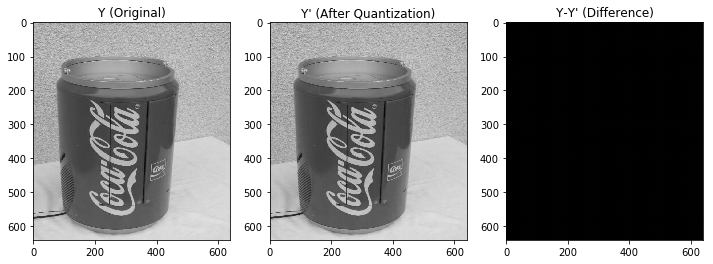

In [21]:
y_original, y_new = np.copy(ycbcr), np.copy(ycbcr)

y_original[:,:,[1,2]] = -128
y_original_rgb = ycbcr2rgb(y_original)

y_new[:,:,0] = y_prime
y_new[:,:,[1,2]] = -128
y_new_rgb = ycbcr2rgb(y_new)

f, axarr = plt.subplots(1,3, figsize=(12,4))
axarr[0].imshow(y_original_rgb,aspect="auto")
axarr[0].set_title("Y (Original)")
axarr[1].imshow(y_new_rgb,aspect="auto")
axarr[1].set_title("Y' (After Quantization)")
axarr[2].imshow(y_original_rgb-y_new_rgb,aspect="auto")
axarr[2].set_title("Y-Y' (Difference)")
plt.show()

**QUESTION: What do you observe? How do these steps help with compression? Do we lose quality?**

As we can see from the fully black difference image, the original Y and the Y' after quantization are the same. Since we have applied downsampling only to chrominance channels, luminance channel remains same after the other operations (dct, quantization, inverse quantization, idct). There is no loss on the luminance channel, which is important to present a good quality to the human eye. If we review the steps further;

- **Color Transformation:** The transformation of an RGB image to YCbCr image doe not affect the quality since it is a lossless transformation. It helps to access chrominance values for the further steps, does not apply any compression.
- **Downsampling:** The human eye is more sensitive to changes in the luminance than the chrominance. Thus, this step reduces size of the chroma channels by a factor of 4 in each dimension while preserving a good quality considering the human perception. Since the matrix sizes are decreased, it is a lossy step and helps compression.
- **DCT transformation:** The discrete cosine transformation transforms an image from spatial domain to frequency domain and allows ud to access the frequency levels of the image. Since it only transforms, it is a lossless step and does not provide any compression alone.
- **Quantization:** The quantisation matrix determines the visual quality of the compression, it uses larger values for higher frequencies to quantize them in a coarser way. The result image shows a lower quality than the original image but still satisfies human eye.

**IMPORTANT NOTE:** Although we have generated the final images after the operations as YCbCr, we have **printed all images as RGB** to visualize the differences better. While printing the single channel images, we have applied fake channels with no affect for the others to visualize better.

## 1.5 Encoding
The final step of JPEG compression is encoding. Apply Huffman encoding on Y'Cb'Cr' individually. For simplicity, just flatten the matrix into a vector by concatenating all the rows together and then apply Huffman encoding (Note: You dont have to do zigzag ordering and RLE that is used in the jpeg compression). Write two functions encodemat and decodemat for further utilization. You can generate the code table based the data you have.

In [22]:
# encode a matrix m
def encodemat(m):
    flat_data = np.ndarray.flatten(m)
    codec = HuffmanCodec.from_data(flat_data)
    out = codec.encode(flat_data)
    return codec, out

In [23]:
# decode a matrix m while reshaping into dimension dxd 
def decodemat(m, codec, d):
    flat_data = np.array(codec.decode(m, as_list = True))
    out = np.reshape(flat_data, (d,d))
    return out

# encode quantized DCT coefficients
codec_y, y_encoded = encodemat(y_dct)
codec_cb, cb_encoded = encodemat(cb_dct)
codec_cr, cr_encoded = encodemat(cr_dct)

# length of the encoded data
print(len(y_encoded),len(cb_encoded),len(cr_encoded))

922950 45027 39071


**QUESTION: Write the length of each encoded channels Y'Cb'Cr'.**

From scipy dct, idct functions: 

*   Length of Y' is 704863
*   Length of Cb' is 32323
*   Length of Cr' is 26710

From our dct, idct functions:

*   Length of Y' is 922950
*   Length of Cb' is 45027
*   Length of Cr' is 39071

## 1.6 Decompression
Using the previously obtained methods you already applied a light weight JPEG compression, by ﬁrst applying a colortransform, downsampling the Cb Cr channels, applying DCT in all the channels and ﬁnally encoding the DCT coeﬃcients using Huﬀman encoding. Now transform back to the RGB color space and show the image. Finally convert the image into gray-scale, use linear transformation on the matrix obtained to convert the image. Use w = 4 in downsampling and upsampling step.

In [24]:
# decode the encoded channels
y_decoded = decodemat(y_encoded,codec_y,len(y_prime))
cb_decoded = decodemat(cb_encoded,codec_cb,len(cb_prime))
cr_decoded = decodemat(cr_encoded,codec_cr,len(cr_prime))

# inverse quantization + idct for channels
y_inverse = idct_quant(y_decoded)
cb_inverse = idct_quant(cb_decoded)
cr_inverse = idct_quant(cr_decoded)

# upsample channels
cb_upsampled = upsample(cb_inverse, 4)
cr_upsampled = upsample(cr_inverse, 4)

# obtaining image with all channels
image_inversed = np.zeros(image.shape)
image_inversed[:,:,0] = y_inverse
image_inversed[:,:,1] = cb_upsampled
image_inversed[:,:,2] = cr_upsampled

# colortransform image back to RGB
image_inversed_rgb = ycbcr2rgb(image_inversed)

[[ 1.78953125e+02  2.61924245e+00 -6.95754453e-01 -5.13910131e-01
   4.32692308e-02  1.61077409e-02 -3.04629826e-02  1.10727620e-02]
 [-2.05168323e+00 -6.05841158e+00  4.88910606e-01  4.73652757e-02
   1.68760987e-02  9.49234669e-04 -2.43701468e-02  1.05802296e-02]
 [ 1.71206047e+00 -6.97399797e-01  7.89986922e-01  4.33362385e-02
  -5.80840929e-02 -6.74319457e-03 -2.59965728e-03 -1.30791859e-02]
 [-9.01945064e-03  1.99091124e-02  5.28005437e-01  7.08891446e-01
  -1.36620431e-02  1.42794599e-02  1.30877138e-02  1.89141966e-03]
 [-4.56730769e-01 -1.63592464e+00  8.09340731e-01 -2.39761196e-02
   3.57142857e-03 -6.94660296e-03  7.03961406e-03  8.28850293e-04]
 [-1.16133249e+00  8.30853144e-03  1.23898716e-02  1.42794599e-02
   1.31758747e-02  1.16112716e-02 -2.86976584e-02 -1.55604370e-02]
 [-3.28421897e-02  2.27280289e-02 -2.32600915e-03 -5.28594636e-03
   1.48752925e-02  3.91339239e-03  3.04840609e-03  2.53164738e-03]
 [ 3.11203018e-02  1.18010253e-02  1.10013618e-02  6.72763117e-03
  -

   4.43835878e-03 -1.90883276e-03 -4.41364445e-03  2.02559892e-03]]
[[ 1.79453125e+02 -9.16934653e-01 -3.06246471e-01 -5.45312670e-01
   4.80769231e-03 -6.24056804e-03  2.24582782e-02 -1.84232943e-03]
 [ 9.93233798e-01  1.00613974e+00  1.01076021e-02  4.90022028e-03
  -4.21752051e-03 -3.18436415e-03  6.41554830e-03  1.00190662e-02]
 [-2.04359300e+00  3.29638753e-01 -7.71581023e-01 -2.04430311e-03
  -4.26524840e-03  2.74301418e-03 -6.27612787e-03  6.11494289e-03]
 [-9.32189729e-03 -4.88117251e-01  5.31188119e-01  7.31171373e-01
  -7.66043314e-03 -9.55505496e-03 -5.48954662e-04 -3.65860882e-03]
 [-4.80769231e-03 -5.34533219e-01 -9.66253296e-04  6.73481640e-03
   2.50000000e-02  1.52671048e-02 -1.79222843e-02  2.09885092e-02]
 [-6.04701698e-01 -8.49452400e-01  1.47778372e-02  1.59057623e-03
  -6.02025422e-03 -8.67947066e-04 -4.26511679e-03  2.94187869e-03]
 [ 1.18980223e+00 -1.73307650e-03  9.63464536e-04 -1.68284540e-03
  -1.11653596e-02 -7.42561910e-03 -6.36077407e-03  3.28307046e-03]
 

[[ 1.78250000e+02  9.07472955e-01  5.03530832e-03  1.96705258e-02
   5.86538462e-01  1.83852384e-03  7.96447873e-03 -5.82901157e-03]
 [ 5.96831456e+00  2.00682780e+00  4.60940388e-01 -6.22151066e-01
  -6.40266777e-01  6.00145616e-03  6.97990614e-03 -9.22694950e-03]
 [ 4.18346963e-01  7.30819258e-01 -7.66190059e-01 -1.56464186e-03
   2.05944411e-02 -2.09941216e-03 -1.52284398e-03 -1.36974752e-03]
 [-2.04948413e+00 -3.40600104e-03 -5.43807177e-01  4.65428850e-03
  -1.18914947e-02  1.06572140e-02 -4.16623064e-03  8.87835206e-03]
 [ 1.36538462e+00  5.53677945e-01  1.26299624e-02  9.93872379e-03
  -7.14285714e-03  6.84989129e-03 -1.91959818e-02  8.91394400e-04]
 [-1.15767871e+00  4.40404174e-03 -1.39206743e-02 -4.05922378e-03
  -1.11954993e-03 -2.17036541e-03  1.44518329e-02 -1.14413054e-02]
 [ 1.20636449e+00 -3.20230780e-03 -7.94149198e-03  6.18401484e-03
  -9.24968674e-03 -8.49713549e-04 -1.20153399e-02 -6.06632320e-03]
 [-8.16016033e-03 -7.47531657e-03  6.09299647e-03  5.45758819e-04
   

[[ 1.83218750e+02 -2.66465845e+00  3.22827204e-01 -5.13428771e-01
   2.62616540e-15 -6.63283734e-04  1.50313737e-02  6.53513309e-03]
 [ 4.52218437e-02 -1.93514237e+00  9.37076486e-01 -6.20513600e-01
   7.55475922e-03 -1.74819052e-03 -3.17569090e-03 -1.38473367e-02]
 [-2.54739505e-03 -7.15338954e-01  3.77874903e-01  5.99084130e-01
  -1.68670648e-16  1.31685418e-02 -8.87578516e-03  6.23116189e-03]
 [ 1.57909223e-02 -1.01449840e+00  5.34999002e-01  1.17098999e-02
  -1.19572400e-02 -3.95035138e-03 -9.87013140e-03  1.25215541e-02]
 [-4.71153846e-01  1.62636509e+00  1.26299624e-02  7.86064096e-03
  -4.16622143e-18  2.31985104e-03 -1.91959818e-02  2.71704087e-03]
 [ 5.92415669e-01  8.25030436e-01 -8.87005418e-03 -1.00460995e-02
   1.97070985e-03  7.25849374e-03 -5.33387456e-03  1.44530438e-02]
 [-3.03300195e-02 -2.07614163e-03 -1.36254461e-03 -3.20349837e-04
  -4.48054292e-16  8.46878842e-03 -1.08329664e-03 -3.11290289e-03]
 [-1.70123797e-03 -2.22442100e-02 -2.00866346e-04  1.07505566e-02
   

  -6.74442633e-03 -7.77471691e-04 -2.47066036e-03  1.05354786e-03]]
[[ 1.87421875e+02  7.31370383e-02 -5.68292126e-01  1.07781180e-03
  -2.40384615e-02 -6.24794592e-03 -9.06807104e-03 -2.59962965e-02]
 [-1.05542109e+00  3.94544572e+00  4.57966511e-01 -6.72131515e-02
   1.90738153e-02  3.34040941e-03  8.32013797e-03 -1.29435876e-03]
 [-1.65776603e+00 -3.80954513e-01  7.61140768e-01 -5.88983020e-01
   4.87531257e-02  3.23598874e-02  4.46030675e-04  1.13294644e-03]
 [ 7.78744018e-01 -1.48582355e+00 -5.61639342e-01  3.58861534e-02
   1.90420159e-02 -1.09353684e-02  9.03037002e-03 -3.68130625e-02]
 [ 4.56730769e-01  5.43019545e-01  3.74896518e-02 -2.25287844e-02
   1.07142857e-02  2.25003881e-02 -1.43197236e-02  1.09660437e-02]
 [ 5.88639889e-01  4.52925573e-03 -2.46031524e-02 -1.95560580e-02
  -2.73786228e-02  1.04046919e-02  2.82597447e-03  6.75277784e-03]
 [-7.00261475e-03  1.55121171e-03  1.35569748e-02 -1.10402529e-02
  -3.20955169e-03 -2.45249195e-03 -7.82115912e-03  3.24506841e-03]
 

[[ 1.82015625e+02  1.76306240e+00 -1.36311173e-02  1.04615643e-02
  -2.40384615e-02  2.13203184e-03 -1.02972205e-02  1.98992943e-02]
 [-2.02933680e+00 -3.02321386e+00  1.41771072e+00  6.53633358e-01
  -6.50583703e-01 -2.42132730e-03  1.08694180e-02 -1.23518080e-02]
 [-7.42365321e-03 -7.08177271e-01 -7.82362949e-01 -5.70806124e-01
  -1.02972205e-02  3.77158703e-03  6.27612787e-03 -2.64236671e-03]
 [ 4.17976224e-01  1.51139067e+00  5.47342139e-01 -1.22595698e-02
   1.23020162e-02  1.51867919e-02  2.58716533e-03 -8.50977638e-03]
 [ 4.80769231e-03  1.07955755e+00 -2.33274181e-03 -1.19088209e-03
  -3.57142857e-03  9.88932541e-03  7.42365321e-03 -2.69305794e-02]
 [-9.58130806e-03  1.91307835e-03  1.20761165e+00  4.04116068e-03
   3.68415245e-03  4.66879686e-04  2.41176915e-02  6.07206563e-03]
 [-2.60190433e-03 -4.52255125e-03 -9.63464536e-04 -3.39604269e-03
   4.62484337e-03  4.16848450e-03  4.94835761e-03  2.61831445e-03]
 [-1.37789026e-02  1.22528563e-02 -7.11063914e-03  4.73589125e-03
  -

[[ 1.71718750e+02 -1.75144221e+00  1.91300845e+00 -1.32049512e-02
   5.76923077e-01 -1.64388975e-02 -1.52824880e-02  8.17342437e-03]
 [ 9.78714985e-01 -8.18922960e-03  4.80553294e-01 -1.23052594e+00
   1.43572758e-03  4.52759575e-03  3.85358230e-03  1.72648197e-03]
 [ 4.32170165e-01  1.45354215e+00  1.15285548e+00  1.14461262e+00
  -6.59799021e-03  1.02744979e-03 -1.52284398e-03 -6.99860281e-03]
 [-1.62671365e+00 -1.21627971e-02  5.28257518e-01  1.47076911e+00
  -8.84965461e-03 -3.59521258e-03  6.36917009e-03  1.67109596e-03]
 [-1.37500000e+00  1.06489419e+00 -7.96447873e-03 -7.94112453e-03
   3.75356624e-17  7.76628445e-05  4.34867537e-03 -2.21848914e-02]
 [ 5.78898922e-01 -1.81932526e-03  8.57321424e-03 -1.07027104e-03
  -1.09739680e-02  8.18937699e-04 -2.08846769e-03 -8.83446504e-03]
 [-1.20263998e+00  2.70200595e-02 -7.94149198e-03 -8.89290655e-03
  -8.24892440e-03  4.14386586e-03  3.99648689e-03 -2.88972576e-03]
 [-1.45031694e-02 -1.44887969e-02 -1.20517783e-02  8.13313699e-03
   

[[ 1.72062500e+02 -2.65592288e+00  1.55457624e+00  1.02632124e+00
   2.38828533e-15 -8.19715366e-04  2.60035075e-02  7.25101926e-03]
 [-2.98016504e+00 -2.92627536e+00  1.41805567e+00  1.27172665e+00
   9.01011282e-03 -3.30396415e-04  1.10237760e-03 -7.35821888e-03]
 [ 2.44581896e+00 -2.17423326e+00  1.84058996e-02  5.63108573e-01
  -9.04514241e-01  2.35804336e-03 -4.56853194e-03 -4.18071416e-03]
 [-1.24241942e+00  2.76217546e-02  1.61146353e+00  1.44793492e+00
   7.93946390e-03  1.26247077e-03  4.72503111e-03  6.77876124e-03]
 [-4.51923077e-01  1.62347401e+00 -4.66548362e-03 -3.18640839e-03
   7.14285714e-03  4.99152543e-04  1.48473064e-02  7.83054213e-03]
 [ 1.73038748e+00 -8.45886193e-01 -2.41665167e-03 -1.26247077e-03
   1.47653763e-02  2.25603932e-02 -1.30863150e-02  8.22281391e-03]
 [-3.80655168e-03 -3.87898604e-03 -2.38244759e-02  7.05857826e-03
   7.37105531e-04  2.78739582e-03 -3.31236798e-03  1.16457372e-03]
 [-1.93964715e-02  8.20724414e-03 -4.19792697e-03 -1.70086837e-03
  -

[[ 1.72984375e+02 -8.62631816e-01 -3.14231395e-01  5.25399882e-01
  -1.44230769e-02  1.44450883e-02 -1.26986319e-02  4.83174616e-03]
 [-4.99725183e+00  5.01960137e+00  9.55557500e-01  6.28698928e-01
   6.50008631e-01 -1.38010732e-03 -2.93094952e-03  3.98223936e-03]
 [-2.86492757e+00  3.69258754e-01 -3.74475351e-01 -5.63826437e-01
  -2.01942059e-02 -5.59364920e-03 -4.75328389e-03  6.31670686e-03]
 [ 2.45943083e+00 -5.06982210e-01 -5.43949969e-01 -7.25604315e-03
  -4.92061380e-03 -1.64949755e-03 -7.76849849e-03 -1.12432150e-02]
 [ 4.47115385e-01 -1.09952696e-02 -8.93073202e-03 -7.26582406e-03
  -1.78571429e-02  6.34721603e-03 -1.35736089e-02 -4.98434242e-03]
 [-2.44356113e-03  8.39326999e-01  2.34581471e-03 -1.64949755e-03
  -6.40902031e-03 -1.92684378e-03  1.09948143e-02 -7.88777556e-03]
 [-1.06188115e-02 -3.50733855e-03  8.90495652e-03  4.10604343e-03
  -7.74854323e-03 -6.25377851e-03 -1.97693904e-04  6.95136305e-04]
 [-1.70975258e-02  4.44172852e-03 -6.37517565e-03  1.46855885e-03
  -

  -5.10494658e-03  4.88990251e-03  6.50267279e-03 -4.50838581e-04]]
[[ 1.74234375e+02  3.45397383e+00 -2.20796253e+00 -2.07191789e+00
   4.80769231e-03  1.97796520e-03 -1.19786128e-02 -9.59425783e-03]
 [ 5.98091628e+00  1.97882427e+00 -4.75756056e-01  3.05970811e-03
   5.41504555e-03  7.59594011e-03 -5.89733108e-03 -5.70872133e-03]
 [-3.89413996e-01 -1.45029417e+00  3.92881250e-01 -3.60894498e-03
  -5.63173692e-03  6.43602018e-04 -8.42975448e-03 -3.56701936e-03]
 [ 3.26606427e+00  4.91600921e-01 -1.04787530e+00  7.45209794e-01
  -1.90095032e-02  5.24471014e-03  2.11113282e-02 -2.53399411e-03]
 [-4.66346154e-01 -1.06924664e+00  8.33234168e-01  2.13011469e-02
  -1.07142857e-02 -3.78788563e-03 -6.00641205e-03 -1.02035268e-02]
 [ 1.74413848e+00  1.29290692e-02 -6.77313170e-05  2.71976859e-03
   1.62469922e-03 -9.84696949e-04  3.04634775e-03  2.32690641e-02]
 [-4.01774586e-03 -4.93538430e-03  1.21944302e-02  2.71859725e-03
  -1.20802701e-03  2.12647810e-03 -3.11467408e-03 -2.78325274e-03]
 

  -2.95157301e-03 -3.54119241e-03  4.99080901e-03 -2.10081719e-03]]
[[ 1.69843750e+02  1.14173016e+01  9.20669431e-03 -5.57863486e-02
   1.92307692e-02 -2.07352968e-02 -3.04914264e-02 -2.50929012e-03]
 [ 1.29895020e+01 -5.98336958e+00  3.27212412e-02 -1.23705395e+00
  -3.99911387e-02 -1.26071416e-02  6.70087538e-03  1.43026449e-03]
 [-2.04231930e+00  3.49695991e-01  7.58566086e-01 -8.46068367e-03
  -1.72954460e-02 -2.26286460e-03 -9.50656779e-03 -1.41111594e-02]
 [-3.94801857e-01  4.83964447e-01 -5.33050110e-01  1.16151764e-02
  -1.66421737e-03  1.73592219e-02 -2.77291075e-02 -8.73932500e-03]
 [ 1.92307692e-02  4.85712167e-01 -1.45624689e-02 -2.41700118e-02
   3.57142857e-02  1.12219280e-02 -1.66485867e-02 -1.06080979e-04]
 [ 5.98305449e-01  6.64493766e-03 -1.82174812e-02  5.16772572e-03
   6.93231387e-03  6.84674213e-03  2.86341776e-02  6.85513877e-02]
 [ 1.20496724e+00  3.35246163e-02  1.78099130e-02 -2.59990441e-03
   1.33741489e-02  1.83020190e-03  4.01857621e-03  9.94199252e-05]
 

[[ 1.14937500e+02 -9.51138617e-01 -3.04771663e-01  3.05225326e-02
   3.84615385e-02 -3.07724862e-02  3.60544938e-02  1.04538158e-04]
 [ 9.78942207e-01  1.01937847e+00  4.85672715e-01 -6.90388496e-03
   2.25293467e-02 -3.67966074e-02  1.24242061e-02  2.38600599e-02]
 [ 4.34867537e-03 -3.45850836e-01 -2.23887224e-02  5.78216237e-03
   1.92279526e-02 -7.75841572e-03  1.19214731e-02 -1.10705430e-02]
 [ 3.61435357e-02  4.77914009e-01  5.46232475e-01  2.47972697e-02
  -1.48512646e-02  6.61868063e-03  3.02345754e-02  4.66042214e-03]
 [ 2.88461538e-02  4.46173967e-03  1.31959804e-02 -1.88230608e-02
  -7.14285714e-03 -1.14633009e-02  4.19945242e-02  4.87995600e-02]
 [-1.52501347e-02 -1.68763246e-02  2.98920330e-03 -6.61868063e-03
   8.22216099e-03 -3.05827470e-03  2.84205234e-02 -2.78370898e-02]
 [ 8.88345704e-03 -4.90188057e-03  1.72455286e-02  2.52748914e-02
   7.07645838e-04  1.31619678e-02  1.20595186e-02  9.28592554e-03]
 [ 1.93345119e-03 -2.66131438e-02  7.80092891e-03  2.19041987e-03
  -

   7.26440865e-04  3.49177495e-03 -2.65701444e-03  4.99838244e-03]]
[[ 1.74234375e+02 -4.41927064e+00  6.41229984e-01  1.64720061e-02
  -5.81730769e-01  6.39932094e-03 -1.07258996e-02  4.86163744e-03]
 [ 3.99283223e+00 -9.73177196e-01 -4.54662218e-01  6.29537855e-01
  -6.60454472e-01 -6.92184661e-03 -7.57389718e-03 -3.28105463e-04]
 [-8.07248906e-01  1.08579750e+00  3.90889839e-01 -5.87345354e-01
  -1.02972205e-02  1.58268096e-02  2.59965728e-03 -3.81737539e-03]
 [-4.10108694e-01 -1.00530910e+00  2.42951253e-03 -6.87335368e-03
   5.83080450e-03  2.66084727e-03  1.19464509e-02 -7.82873733e-03]
 [-4.80769231e-03  5.52926578e-01 -5.63173692e-03  5.94393760e-03
  -3.57142857e-03  5.37520343e-03 -3.07497784e-03  3.44796095e-02]
 [-4.00995989e-03 -9.75943756e-03 -1.20763205e+00 -5.95984238e-03
   2.61761196e-03  1.20385109e-02  2.10019053e-02  9.15069777e-04]
 [-3.27809927e-03  6.90555933e-04  2.32600915e-03 -3.49182331e-04
   4.62484337e-03 -9.87271246e-03  1.25890122e-03 -2.23167959e-03]
 

[[ 1.20125000e+02  7.68262087e-15 -4.20747138e-15  2.49779951e-15
   1.96867744e-15  1.08745650e-14 -6.12262950e-15 -2.98968869e-15]
 [ 1.51236889e+00  6.31734549e-18 -5.26265095e-17  3.00695369e-17
   1.60105573e-17  1.32707071e-16 -7.40799216e-17 -3.20189885e-17]
 [-5.93892257e-02 -2.39810064e-18  3.24101968e-18 -4.42759484e-18
  -1.53511612e-18 -1.35593552e-17  7.44686723e-18  3.40895622e-18]
 [ 1.82410198e-03  3.47891806e-20 -1.55792691e-19  9.37256983e-20
   5.43881795e-20  4.04240755e-19 -2.16845798e-19 -1.05549116e-19]
 [ 3.84615385e-02  4.38005901e-18 -2.54999458e-18  2.80344959e-18
   8.32083967e-19  8.50029144e-18 -8.36752523e-18 -4.68531551e-18]
 [-2.60655841e-02 -1.58889447e-18  3.10352602e-18 -1.86962705e-18
  -9.02511640e-19 -6.00361206e-18  5.77537490e-18  2.58263843e-18]
 [-2.08152346e-02 -2.13504428e-18  1.46081977e-18 -1.09561483e-18
  -2.47817639e-19 -2.72599403e-18  1.40789152e-18  4.02254719e-19]
 [-4.13258060e-02 -2.13504428e-18  2.19122965e-18 -2.55643460e-18
  -

  -1.17085844e-02  9.74894817e-04  3.06114746e-03 -5.14872622e-03]]
[[ 7.01406250e+01 -9.56223703e-01 -3.21352396e-01  8.49220102e-03
  -4.80769231e-03 -2.75701784e-02 -1.43515802e-03 -1.99487401e-03]
 [ 1.17393172e+00 -9.64557137e-03 -2.79746742e-03  7.16967246e-03
  -3.77737961e-03 -1.04217669e-03  4.42482730e-03 -3.98223936e-03]
 [-4.14669414e-02  3.39396274e-02  5.39096319e-03 -8.91470227e-03
  -1.35962156e-02  2.45580821e-02 -9.95259846e-03 -1.71771407e-03]
 [ 9.33501165e-01  6.19198985e-03  3.60894498e-03 -9.24942083e-03
   5.97862002e-03  1.64949755e-03 -6.66270181e-03  5.99627321e-03]
 [ 5.14423077e-01  1.97671798e-02  2.33274181e-03 -2.61499378e-03
  -1.07142857e-02  1.49965732e-02 -7.42365321e-03 -5.94548483e-03]
 [-3.27446433e-02 -1.04217669e-03 -6.43602018e-04  1.64949755e-03
  -9.85354926e-04 -2.71858812e-04  2.04818131e-03 -1.84331448e-03]
 [-2.18929787e-02  1.76776081e-02  4.25293822e-03 -9.51068262e-03
   5.00381171e-04  6.21049090e-03 -5.65456584e-03  2.91018899e-03]
 

  -1.08719559e-03  6.13912578e-04  4.78970496e-03 -4.86327638e-03]]
[[ 1.86812500e+02 -4.37743944e+00  3.37069206e-01  3.48720828e-02
   9.61538462e-03 -1.01399085e-02 -7.49557400e-03  1.87817200e-04]
 [-2.07973958e+00 -1.05624035e+00  2.02152041e-02 -6.56407118e-01
   1.55496593e-02 -8.60912693e-03  1.32444441e-02  3.04787406e-03]
 [-3.94802306e-01  3.59144509e-01 -4.80769231e-03 -5.65324809e-03
  -9.33096724e-03  3.38661620e-03  1.52284398e-03 -1.00260841e-02]
 [-4.00894782e-01  1.01009028e+00  1.43572758e-03  1.61832363e-02
  -1.02754269e-02  3.04787406e-03 -1.09790932e-03 -1.59693626e-02]
 [-4.61538462e-01 -1.06224131e+00  1.92279526e-02  1.16789213e-03
   7.14285714e-03  8.32144860e-03  1.80128032e-03  6.42307502e-03]
 [-7.43404892e-04  8.54078000e-05  6.47121168e-03 -3.04787406e-03
   8.97631900e-03  7.10437825e-03 -8.53023358e-03 -7.49752812e-03]
 [-1.18339377e+00 -6.66846079e-03  7.94149198e-03 -3.88339337e-03
   1.16657408e-02  6.20870762e-03 -1.81159420e-03  4.99817716e-04]
 

  -1.10759007e-02  2.03077476e-02  1.57322564e-02 -6.42755198e-03]]
[[ 1.17500000e+02 -2.89209642e+01  5.36340152e+00  1.06161694e+00
   5.57692308e-01  2.76969329e-02 -9.22695226e-03  1.65206399e-02]
 [ 8.96313599e+00 -1.68738284e+01 -8.57163541e+00  1.25885859e+00
   4.94926200e-03  1.21958333e-02  4.37179952e-03  6.07529491e-04]
 [ 2.04898131e+00  4.02822413e+00 -3.81857725e-01 -1.12749832e+00
   9.33639179e-01  6.41942245e-03  3.82875499e-02 -1.03967648e-02]
 [-1.89896268e-04 -9.73490548e-01  1.15703414e-02 -7.35339833e-01
  -1.70911392e-02  1.94692792e+00  1.47969607e-02 -1.07108162e-02]
 [ 4.71153846e-01  5.15122534e-01  6.59799021e-03 -5.75148187e-04
  -7.14285714e-03  2.80823721e-03  2.09972621e-02 -2.21580011e-02]
 [ 3.34938408e-02 -1.52056560e-02  2.32833201e-02 -4.77138172e-06
  -1.62736923e-02  4.99471493e-03  1.74649891e-02  5.92407691e-04]
 [-1.04262019e-02 -3.59012580e-02 -2.49532449e-02  2.13710864e-02
   1.23439269e-02  2.12877992e-02  9.83044723e-03  4.63739126e-03]
 

   1.20731501e-04  6.06470846e-03 -3.58325221e-03 -9.52757195e-04]]
[[ 9.63125000e+01  2.27328788e+01  9.79773998e-01  4.83556430e-01
  -5.28846154e-01  3.97310463e-02 -4.62525796e-03  1.67052844e-02]
 [-2.79931432e+01 -1.80081937e+01  1.42920756e+00  1.28917085e+00
  -5.90739585e-02  1.07589943e-02  6.16128416e-03 -1.18363574e-02]
 [ 2.43966900e+00 -3.99629296e-01 -3.09827256e+00 -5.86829428e-01
  -9.11112231e-01  4.20667049e-02 -6.43720645e-16  2.43863115e-03]
 [ 7.53496662e-03  2.50932012e+00  1.56824444e+00 -7.43195058e-01
  -1.18936644e-02 -1.91446252e-02 -3.29919735e-03  1.47468642e-02]
 [-2.88461538e-02 -5.35703678e-01  3.29899511e-03  1.29091754e+00
  -1.42857143e-02 -2.65941009e-02  1.04986311e-02  4.88088924e-03]
 [ 2.66958430e-02 -4.88556589e-03 -3.39184665e-02 -3.38232244e-03
  -2.05129152e-02 -5.75804968e-03  3.21976588e-02  6.06811330e-02]
 [ 8.75655375e-03  2.37101855e-02 -5.53650693e-16 -2.07948533e-02
  -7.51181887e-03  6.55316837e-03  7.98355473e-04 -2.33406166e-03]
 

[[ 7.12500000e+01  6.40728862e-01 -1.37532944e-01  9.47343393e-02
   7.69230769e-02 -4.62572990e-02 -3.73238690e-02 -3.51583158e-02]
 [ 1.96261557e-15  1.00600355e-15 -3.59051508e-16  1.48741672e-16
  -7.24658058e-17 -7.26282363e-17  1.67762175e-16 -5.52018065e-17]
 [-2.87612391e-15  1.82909737e-17 -2.69344838e-16  5.43479185e-18
  -4.27714842e-16 -3.25574852e-18  4.80188955e-16 -2.35419469e-18]
 [ 1.78062758e-15 -9.14548686e-18 -2.22004269e-17 -2.71739592e-18
  -4.60199514e-17  1.62787426e-18  4.95184154e-17  1.17709734e-18]
 [ 8.51473218e-16  1.54769778e-17  3.98076620e-17  4.87257200e-18
   7.62616337e-17 -2.69762021e-18 -1.53056920e-16 -3.63830088e-18]
 [ 6.86915451e-15 -7.73848888e-18  3.53693907e-18 -2.43628600e-18
  -2.24298923e-18  1.34881010e-18  1.93119981e-18  1.81915044e-18]
 [-4.29963781e-15 -6.19079110e-17 -1.48351639e-16 -1.48741672e-17
  -2.24298923e-16  6.74405051e-18  2.30879979e-16  4.64015185e-18]
 [-1.54593719e-15 -6.06816081e-32  9.34177388e-32 -6.22784925e-32
  -

   3.47366274e-03 -1.83270781e-03 -5.53055368e-03 -6.19751115e-03]]
[[ 1.28671875e+02  2.09175424e+01  2.47417958e+00  1.51760648e+00
  -1.44230769e-02  2.57496246e-02  5.04905683e-03 -4.94246713e-03]
 [-1.10011442e+00 -1.94254777e+00 -4.50982338e-01  2.17984808e-02
  -3.44411623e-02  1.14552088e-02  3.02204494e-03 -1.31258615e-02]
 [-8.30281511e-01 -7.42077303e-01 -3.56069451e-01 -5.76790225e-01
  -1.96281878e-02  3.45342921e-02  1.14754424e-02  2.35686797e-02]
 [-3.32912100e-01 -6.11432084e-03 -1.24901435e-02  1.51668264e-02
  -4.16941761e-02 -7.49412462e-03 -1.04237442e-03  8.06948970e-03]
 [ 4.75961538e-01  1.44251584e-02  6.99822543e-03 -1.10700393e-02
   3.57142857e-03  1.63900755e-02 -2.22709596e-02 -1.53940031e-02]
 [-6.23358153e-01 -8.31960168e-01 -3.51463660e-03  1.07931197e-02
   6.24698165e-03 -8.36970253e-03  5.42274702e-03  1.66129519e-02]
 [ 1.18085532e+00  1.60126343e-02  3.68855376e-03 -3.10854569e-04
   1.62905841e-02  2.30903850e-03 -3.51006188e-03 -4.91028313e-03]
 

   9.86076132e-32 -1.30252626e-16  5.57308634e-17  1.53761106e-17]]
[[ 6.65312500e+01  9.21047739e-01 -2.81261569e-02  1.36180613e-01
   7.69230769e-02 -6.64948673e-02 -6.70148249e-02 -5.05400790e-02]
 [-4.33449952e-02  5.55447788e-02 -1.68612858e-02  8.21251896e-03
  -6.71327731e-17 -4.01004480e-03  4.57583766e-03 -3.04787406e-03]
 [ 1.48473064e-02 -1.90261955e-02  1.16067960e-02 -5.65324809e-03
   8.60597313e-19  3.38661620e-03 -3.67647059e-03  2.44882362e-03]
 [-1.33622228e-02  1.71231236e-02 -1.04458404e-02  5.08778886e-03
   2.17634781e-16 -3.04787406e-03  3.30873611e-03 -2.20388303e-03]
 [ 9.61538462e-03 -1.23217089e-02  7.96447873e-03 -3.87920786e-03
   1.76516576e-18  2.14766031e-03 -4.34867537e-03  2.89656579e-03]
 [-7.55475922e-03  9.68110455e-03 -6.25765078e-03  3.04787406e-03
  -2.22481310e-19 -1.68740588e-03  3.41673231e-03 -2.27581714e-03]
 [ 5.20380866e-03 -6.66846079e-03  3.28947368e-03 -1.60218297e-03
  -2.35426757e-17  7.26440865e-04 -7.50386888e-04  4.99817716e-04]
 

[[ 8.62500000e+01 -1.73298582e+00  3.22975429e-02 -3.87656101e-02
  -9.61538462e-03 -5.79111870e-03  2.85589198e-02  2.67653285e-02]
 [ 2.10349064e+01 -1.95995280e+00  9.98439321e-04 -1.61724473e-02
  -3.47327629e-02  2.88189318e-02 -4.15560302e-03 -4.09474704e-02]
 [ 6.93933000e+00 -3.42182896e-01  1.04402542e-02 -6.51390386e-03
   3.37904215e-02  1.64174994e-02 -1.19214731e-02  4.09449186e-03]
 [ 5.29257707e+00  1.04664595e-02 -5.00147947e-01  9.76878842e-03
  -3.30355059e-03 -4.53220521e-03 -2.93838766e-04  8.39648596e-03]
 [ 3.23076923e+00  5.89810172e-01 -4.09946555e-03 -1.76088906e-02
   7.14285714e-03 -1.95081790e-02  7.60378124e-02 -2.19799566e-02]
 [ 2.31163465e+00  8.26842227e-01  2.65488330e-03 -2.07277195e-02
   3.35758275e-02  1.28846511e-02  3.84737036e-02  4.38084693e-03]
 [ 1.21051140e+00 -2.51092013e-02 -1.72455286e-02 -8.62820593e-03
   7.24816206e-03  2.14871363e-03  1.41819332e-02  1.11690923e-03]
 [ 1.80565720e+00  1.31866709e-02 -2.83198857e-02  2.32787171e-02
  -

  -2.81736038e-32 -2.25388830e-31  1.08611284e-31  0.00000000e+00]]
[[ 6.81250000e+01  7.38940732e-01 -2.84840053e-02  2.17322422e-02
  -3.84615385e-02 -3.56457844e-02  4.50538953e-02  5.38911877e-03]
 [ 4.27850195e-15  1.71828537e-15 -7.06089242e-16  3.36507034e-16
   3.62329029e-17 -1.40727461e-16  1.56458261e-16 -1.37561184e-16]
 [-2.50857954e-15 -3.61278300e-16 -1.27875610e-16  4.83073623e-17
   8.39187349e-17  2.56831010e-17 -3.69703951e-17 -4.88536030e-17]
 [ 1.73959108e-15 -1.79304451e-16  1.38897832e-17 -1.05973907e-17
   2.30099757e-17  2.13254244e-17 -2.56428082e-17 -3.06726284e-18]
 [ 8.72609078e-16  1.78493119e-17 -1.46504813e-18  1.11777752e-18
  -2.24298923e-18 -2.07878087e-18  4.66232877e-18  5.57684153e-19]
 [ 6.42379174e-15 -8.48393469e-17 -2.72513116e-16  1.19594535e-16
   7.28971499e-17 -1.87634683e-17  2.32665685e-17 -1.34550363e-16]
 [-4.22717200e-15 -6.52064563e-16  1.41840737e-17 -1.92474624e-17
   5.60747307e-17  4.52254712e-17 -5.24952264e-17 -1.17526454e-17]
 

[[ 6.49843750e+01 -1.47618632e+01 -2.53999643e+00 -6.31452876e-01
  -5.72115385e-01 -4.74504314e-02  3.48143998e-03 -1.50791125e-02]
 [-1.09372193e+00 -1.00732161e+00  4.26675900e-01 -2.56189817e-02
   2.34715354e-02 -2.35007633e-02 -2.45580821e-02  3.18377979e-03]
 [ 5.55681331e-02 -8.72929269e-03 -1.30149364e-02  4.81484569e-02
   3.08916616e-02 -1.39205588e-02 -1.14754424e-02  3.77411741e-03]
 [-1.91516175e-02  4.92469164e-03 -1.76776081e-02 -2.88931818e-02
   1.88709349e-02  9.47172763e-03 -2.51324392e-02 -2.65190870e-02]
 [-4.80769231e-03 -4.55438977e-03 -1.55287222e-02  1.75412510e-02
   3.57142857e-03 -1.53235350e-02 -3.45708710e-02 -2.06458223e-03]
 [-1.70210663e-02  1.70977760e-02  6.92424276e-03 -1.74362064e-02
   1.29637266e-02 -8.18476208e-03 -2.50554102e-02 -3.38731897e-02]
 [-2.46797947e-02 -2.10404894e-02 -3.68855376e-03  4.91169961e-04
  -1.38745301e-02  1.67558160e-03 -2.34219786e-03  1.47307241e-02]
 [-2.86713104e-03 -7.23078738e-03  6.31543626e-03  1.22256115e-02
   

   1.78552609e-16  8.94071019e-04 -3.82543918e-04 -1.05543630e-04]]
[[ 7.10000000e+01  2.62406223e-15 -3.22661244e-15  1.90009695e-15
   7.24058780e-16  6.43493517e-15 -3.65808026e-15 -1.33480000e-15]
 [ 3.45420341e-15  1.97215226e-31 -1.76455729e-31  6.74683669e-32
   3.79260051e-32  3.07200641e-31 -1.86164373e-31 -8.92568912e-32]
 [-1.17043256e-15 -8.06789562e-32  7.39557099e-32 -6.73186590e-32
  -4.25032815e-32 -2.77971461e-31  1.40842124e-31  5.85482703e-32]
 [ 1.95547879e-15  2.01697391e-31 -1.58341071e-31  7.91705356e-32
   4.84537409e-32  4.45009358e-31 -2.24132930e-31 -1.30781972e-31]
 [ 5.55571178e-16  2.27556030e-32 -4.25032815e-32  2.12516408e-32
   9.86076132e-33  1.24668197e-31 -1.14015053e-31 -5.29455650e-32]
 [ 6.87217392e-15  1.02020954e-30 -4.27583012e-31  5.94620909e-31
   2.09189008e-31  1.47876203e-30 -1.42882992e-30 -6.97396741e-31]
 [-2.89863223e-15 -6.06816081e-32  1.86835478e-31 -1.24556985e-31
  -5.63472075e-32 -3.94430453e-31  1.71491501e-31  1.82924268e-31]
 

   5.52834779e-03 -1.36641741e-03  4.99673624e-03 -1.41997219e-03]]
[[ 8.36875000e+01 -1.57049987e+01  5.06280125e+00 -3.65135103e+00
   1.71153846e+00 -3.48002534e-02 -1.16283636e-02  6.96543331e-03]
 [ 9.91456019e-01 -1.97985220e+00  5.08419807e-01  5.76749075e-02
  -9.14504372e-03 -8.81232230e-03  3.77013333e-04 -4.39367216e-03]
 [ 1.59350055e+00 -1.82364929e+00  1.14008214e+00 -5.75870423e-01
   9.21009216e-01  1.47656086e-02  2.51045115e-02  3.44167741e-03]
 [-7.94064131e-03  5.25772236e-02 -1.68504560e-02  1.88394000e-02
   1.30809916e-02  2.41111810e-02  1.17820291e-02  2.77218165e-02]
 [ 7.27700020e-16 -2.11772648e-02 -2.25269477e-02 -4.09276876e-03
   1.42857143e-02  8.84088698e-03 -1.22999114e-02  2.63869372e-02]
 [-9.86073181e-03  5.09701997e-02  2.26096803e-02 -1.75131908e-02
  -1.24553449e-02  1.41559135e-02 -1.00228753e-02  3.65066149e-02]
 [ 1.39154953e-02  7.76565390e-03 -3.85385814e-03  1.41002123e-03
   1.98852055e-02  5.53927763e-03  1.96791939e-02 -8.52732111e-03]
 

   1.06045519e-02  2.91063645e-03 -3.77322573e-03 -8.55397295e-07]]
[[ 7.64375000e+01 -7.32911455e-01 -1.26821797e+00 -4.14120886e-01
  -5.76923077e-02 -2.73409049e-02 -1.07514847e-03  5.54024199e-02]
 [-4.61421264e-02 -9.62759898e-01  2.12433913e-02 -1.25395997e-02
  -3.50892582e-02 -7.34387670e-03 -8.57062385e-03 -1.21325749e-02]
 [-3.14958932e-02 -1.33622228e-02 -1.16067960e-02 -1.13064962e-02
   2.38934362e-02  6.77323240e-03 -1.40750997e-02 -5.77716881e-03]
 [-1.14267994e-02  3.15617378e-02 -1.79749570e-02  3.66277302e-03
  -6.84822501e-03  1.80980930e-03 -4.50522695e-03 -1.37972581e-03]
 [-9.61538462e-03  5.34202147e-03  6.59799021e-03  8.45504552e-03
   7.14285714e-03 -1.39350230e-03  2.09972621e-02  9.44851832e-03]
 [ 1.08859813e-02  8.60336049e-03  5.58401094e-03  2.85567433e-03
   5.03912272e-04 -3.79775707e-03 -6.18413926e-03 -1.05644757e-02]
 [ 1.10389452e-02 -1.33369216e-02 -6.01456291e-03 -1.81512750e-03
  -5.12522454e-03  6.19214217e-03  7.50386888e-04  9.99635432e-04]
 

[[ 5.87812500e+01 -1.04683143e+01 -3.14842280e-01  2.11492002e+00
   1.72115385e+00  1.04154049e+00  2.01255364e-02  1.65374253e-02]
 [-9.62947310e-01 -1.03096026e+00  4.65131787e-02  5.70793328e-01
  -2.38664076e-02  4.26708625e-02  1.40160665e-02  1.65851684e-02]
 [-2.16631945e-15  1.98909809e-02  1.16654176e-03 -6.45590090e-03
   2.91249379e-02 -1.50897096e-02 -1.25522557e-02  4.93686539e-03]
 [-5.08407311e-03  5.03814803e-01 -2.01938363e-04 -2.67449436e-03
  -1.93210467e-02 -1.19196848e-02  8.10618620e-03 -2.57631598e-02]
 [ 2.88461538e-02 -1.25961756e-02 -2.71924313e-02 -4.37009999e-02
  -7.14285714e-03  2.69177985e-02  2.54739505e-03 -4.87239005e-02]
 [ 3.85927558e-02  6.89416510e-03  2.30042894e-02  5.32169455e-03
   1.86335007e-02 -2.55694069e-02  3.14575808e-02 -1.93855447e-02]
 [-3.15132535e-15  2.99491751e-02  1.92692907e-03  2.04915408e-02
   1.30810324e-02 -1.46601575e-02 -1.49323201e-02  1.18980988e-02]
 [ 3.94737791e-03 -7.31927572e-04 -5.20146465e-03 -1.57640733e-02
   

[[ 7.39687500e+01  2.14351693e-02 -1.71916180e-02  4.96555981e-02
  -2.88461538e-02 -2.85583971e-04 -4.66548362e-03  1.98217113e-02]
 [-2.22116239e+00 -2.23991485e-02  2.38454591e-02 -6.34241146e-02
   3.59499139e-02 -3.96116348e-04  6.47121168e-03 -2.44663198e-02]
 [-1.16231056e-01 -4.61416487e-02 -1.64144883e-02 -3.67269241e-02
   4.31213887e-02  1.46702164e-02 -5.19931457e-03 -3.24557075e-02]
 [-4.02255198e-02  9.16548824e-03  1.47726492e-02 -1.52864444e-02
   5.37997279e-03 -4.58215629e-03  4.67925949e-03 -2.12866898e-03]
 [-4.80769231e-02 -1.47726492e-02 -1.12634738e-02 -1.28720404e-03
   7.14285714e-03  5.36186111e-03 -6.14995568e-03 -1.16654538e-02]
 [ 2.74827661e-02  1.80315906e-02  8.84965461e-03  1.11801465e-02
  -1.42027481e-02 -5.88873821e-03  4.83198917e-03  2.05291246e-02]
 [-1.13004497e-02  1.82312331e-04 -4.65201830e-03  9.34547403e-03
  -4.41757870e-03  4.80460842e-04 -1.06120731e-03  2.59850851e-03]
 [ 1.75524688e-02  9.52244259e-03  2.37157836e-03  6.84997434e-03
  -

  -1.89828146e-03  1.15615635e-02 -2.01293563e-03 -1.27306875e-02]]
[[ 1.84500000e+02  1.63552333e-14 -9.19734251e-15  4.89472744e-15
   2.58984643e-15  1.66007346e-14 -9.49548432e-15 -3.61721881e-15]
 [ 1.09379259e+00  5.21104794e-17 -6.35661582e-17  3.79861604e-17
   1.38041649e-17  1.00610784e-16 -5.95395732e-17 -2.08911678e-17]
 [-8.02174511e-15 -4.03394781e-31  2.86341338e-31 -2.64533885e-31
  -2.32917983e-31 -1.85569327e-30  9.15201910e-31  3.74672677e-31]
 [ 2.39633575e-02  2.29901394e-18 -2.62643204e-18  1.10941910e-18
   2.88974464e-19  5.25952608e-18 -3.07710901e-18 -1.23563998e-18]
 [ 3.26096126e-15  2.65482035e-31 -2.87322183e-31  2.79671592e-31
   7.74774103e-32  7.38852759e-31 -7.46000210e-31 -3.44286240e-31]
 [-1.35484492e-02 -1.88578109e-18  1.49837269e-18 -7.29851335e-19
  -3.92025302e-19 -2.94331158e-18  2.92345109e-18  1.28046329e-18]
 [-1.00485917e-14 -4.85452865e-31  8.30379900e-31 -3.32151960e-31
  -2.25388830e-31 -1.46502740e-30  7.77428138e-31  3.65848536e-31]
 

[[ 1.73625000e+02 -9.66058306e+00 -2.25511297e+00 -5.27300353e-01
   9.61538462e-03  2.14037471e-02  1.48135833e-02  5.05239076e-03]
 [ 1.19508731e+01  1.30061251e+01  2.37940350e+00 -3.80888091e-02
   2.08916808e-02  2.38576652e-02  3.48459877e-03 -1.07027104e-03]
 [-2.90384711e+00 -3.22457702e+00 -3.63110154e-01  1.58805120e-02
  -2.71924313e-02 -2.20286288e-02  1.10294118e-02  7.41688144e-03]
 [ 1.64610606e+00  1.47207985e+00 -1.27618498e-02 -7.33154140e-01
  -1.82038140e-03 -1.72648197e-03  7.76015162e-03  2.17133057e-02]
 [-4.42307692e-01 -9.60481066e-03  7.96447873e-03 -2.93044201e-02
   2.14285714e-02 -4.12588786e-02 -4.34867537e-03 -3.25182635e-03]
 [ 7.42530288e-04  3.26811197e-03  1.71236519e-02  1.29899558e-02
   7.58281670e-03 -3.80168635e-03 -1.92521731e-02 -5.92943666e-02]
 [-2.18177065e-03 -3.92871526e-02 -9.86842105e-03  1.05468456e-02
   1.00076234e-03 -1.39975766e-03 -1.89729856e-02  3.70975761e-03]
 [-2.91936061e-02 -4.01004480e-03  6.02750275e-03 -3.76333325e-02
   

[[ 1.78890625e+02  8.66679214e+00 -3.19485753e+00  2.08378887e+00
  -1.68750000e+00  1.00102744e+00  3.91011904e-03 -2.17219663e-02]
 [ 8.47050488e-02  2.84711780e-02 -1.01426920e-02  1.35824462e-02
  -8.54432928e-03 -4.22370593e-02 -8.11346422e-03  3.04261622e-02]
 [ 3.68416733e-01  4.76696635e-02  3.62043685e-01 -1.18364734e-03
   2.62261780e-02 -1.02878690e-02  2.03512276e-02  1.30617863e-02]
 [ 4.08961208e-01  2.21576558e-02  3.11690866e-02 -2.31934446e-02
  -9.85782788e-03  4.25405083e-03 -1.27206070e-02 -6.82043043e-03]
 [ 2.40384615e-02  1.17526537e-02 -1.49627042e-02 -3.30431655e-02
  -1.07142857e-02 -1.57776703e-02  2.66196350e-02  2.25417817e-02]
 [ 5.88515321e-03  2.11992075e-03  1.30609210e-02 -2.88756231e-03
   3.13301524e-03  4.16922228e-03 -1.61995300e-02 -1.52615854e-02]
 [ 1.13770426e-02  1.67076640e-02  5.05109837e-03 -3.35456639e-04
  -8.04165973e-03 -2.20678341e-03 -9.61066400e-03  2.66597894e-03]
 [-1.94694294e-02 -1.24903107e-02  2.01499232e-02 -2.06876717e-03
   

  -5.63472075e-32 -4.50777660e-31  2.17222568e-31  0.00000000e+00]]
[[ 1.89046875e+02  1.61177389e+00 -5.01000462e-02 -8.15290247e-03
   1.44230769e-02 -1.27392840e-02 -4.00235220e-04  7.20294459e-03]
 [-1.02828547e+00 -1.70279721e-02  4.17241748e-02  7.25960500e-03
  -2.30787759e-02  1.24115183e-02 -1.61926258e-03  1.32798304e-02]
 [ 4.27059844e-01  4.83492938e-02  1.86474983e-02  2.44749831e-02
   6.99822543e-03 -1.01068208e-02 -6.27612787e-03 -3.57235344e-03]
 [ 3.15833659e-02 -2.31785130e-03  2.85892320e-02  7.84128035e-03
   6.67524983e-03 -7.66077927e-03  1.84142025e-02  1.79385632e-02]
 [ 4.80769231e-03 -4.79259231e-03 -3.08916616e-02 -2.79030760e-04
   3.57142857e-03 -8.74512208e-03  3.53169857e-02 -1.27128974e-02]
 [ 5.88141384e-03  9.37085543e-03  6.38567118e-03 -2.08981405e-02
   1.91646339e-03 -7.74188398e-04  1.31506109e-02  2.51163937e-02]
 [-1.95843047e-02  1.20439860e-02  9.63464536e-04  5.29771886e-03
  -8.74930557e-03 -5.03741000e-04  1.47125369e-02  8.55678950e-03]
 

   8.99578031e-17 -2.50791451e-16 -1.20073034e-16 -4.26390002e-17]]
[[ 1.02531250e+02 -8.99492433e-01 -1.21563096e-02  1.01321594e-01
  -1.92307692e-02 -3.32904339e-02  3.29899511e-03 -1.28202895e-02]
 [-1.03095759e-01  7.96259679e-02 -8.41651101e-02  5.14265689e-02
   4.92868355e-02  2.27150791e-03 -1.07364314e-03 -1.29899558e-02]
 [ 1.48473064e-02 -4.13478883e-01 -4.80769231e-03 -3.63794333e-02
  -1.59289575e-02  3.51980803e-02  1.52284398e-03  4.22118388e-03]
 [ 5.25155567e-02  2.01981014e-02  2.97472367e-02  1.61770339e-02
   1.55168314e-02 -1.07027104e-03 -1.65851836e-02 -5.18166686e-03]
 [ 9.61538462e-03 -8.09356684e-03  7.96447873e-03  4.13401527e-02
   4.26296910e-17 -2.28873029e-02 -4.34867537e-03  1.90262155e-03]
 [-1.45818281e-02  7.94256766e-03 -5.30498018e-03 -3.59521258e-03
  -8.59064124e-03 -2.78227361e-03  1.02930546e-02  7.99160704e-04]
 [ 5.20380866e-03  2.94637655e-02  7.94149198e-03  1.88238022e-02
   3.41681636e-03 -1.14102047e-02 -1.81159420e-03  7.79213252e-03]
 

  -1.37174599e-02  9.31794324e-17 -1.45459798e-02  1.01368189e-16]]
[[ 9.57656250e+01 -8.79703884e-01 -3.21352396e-01 -4.62436742e-03
  -4.80769231e-03 -6.05604435e-03 -1.43515802e-03 -1.43681249e-03]
 [-4.07851921e-02 -9.97094911e-01  4.57948536e-02 -5.62603341e-03
  -7.86598583e-03  6.71323643e-03  9.21422586e-03 -2.46864754e-03]
 [ 9.22493353e-03 -2.41599459e-03  1.40814048e-03  3.60894498e-03
  -6.99822543e-03 -6.43602018e-04 -2.59965728e-03 -2.33962974e-03]
 [ 2.09056226e-02  1.80237637e-02  1.30395727e-02  1.08935604e-02
   2.16015070e-02 -7.92116659e-04  3.81807920e-04 -1.64659757e-02]
 [ 1.44230769e-02 -3.77737961e-03  2.33274181e-03  5.97862002e-03
  -1.07142857e-02 -9.85354926e-04 -7.42365321e-03 -6.68111138e-03]
 [-3.00584633e-02  5.11794142e-03  1.03821110e-03  2.00200692e-02
   1.58950158e-03 -1.15976810e-03 -2.85571668e-02 -1.37517698e-03]
 [-1.88446581e-02  4.93538430e-03 -2.32600915e-03 -5.96136478e-03
   8.74930557e-03  8.04642658e-04  3.09258475e-03  2.78325274e-03]
 

[[ 1.27453125e+02  8.63009297e+00  6.10885335e-04  5.15853687e-01
  -4.80769231e-03 -1.34445264e-02 -3.28241682e-02 -1.57883215e-03]
 [-4.21336783e+01 -4.04005008e+00  1.95670588e-02 -2.69029989e-02
   1.25855541e-02  3.76628228e-02 -1.41915598e-02 -6.11381121e-03]
 [ 4.08873769e+00 -2.95995376e+00 -3.97688943e-01  1.83815941e-02
   4.26524840e-03  8.20605259e-03 -1.51147760e-02 -1.27461717e-02]
 [ 1.20683501e+00  2.52132072e+00 -5.68153246e-01 -2.26494415e-03
   6.14207246e-03  1.54830094e-02  1.77168358e-02  2.21269417e-02]
 [-1.38942308e+00  5.33827120e-01  8.06041736e-01  2.45933883e-03
  -1.07142857e-02  1.98903340e-02 -3.45901699e-03  1.93974234e-02]
 [ 5.98313638e-01 -8.28295940e-01 -8.18565302e-03  1.81243662e-03
   4.13741899e-03 -8.91682152e-04 -2.76156877e-02 -5.45044966e-02]
 [-2.00774559e-03  1.21532743e-02 -1.30299743e+00 -1.16155830e-03
   1.11653596e-02 -2.24653085e-03  1.30307987e-03  3.32425154e-03]
 [ 1.20446078e-02  3.56251102e-02 -4.00598617e-02  1.81295087e-02
   

  -5.63472075e-32 -4.50777660e-31  2.17222568e-31  0.00000000e+00]]
[[ 8.80000000e+01  8.08493478e-15 -2.29990928e-15  1.56308779e-15
   1.51418645e-15  8.02446033e-15 -4.44932577e-15 -1.97203109e-15]
 [ 5.02429587e-15  5.91645679e-31 -1.66075980e-31  1.24556985e-31
   6.06816081e-32  4.85452865e-31 -2.58419952e-31 -1.22409451e-31]
 [-3.88241044e-15 -3.58573139e-31  2.88237638e-31 -2.35141231e-31
  -1.22409451e-31 -9.72475081e-31  4.42284147e-31  2.24767354e-31]
 [ 1.48445105e-15  2.15143883e-31 -1.44118819e-31  4.17186056e-32
   6.12047254e-32  3.50227040e-31 -1.83439163e-31 -8.04812137e-32]
 [ 9.66210744e-16  6.06816081e-32 -9.52073506e-32  7.48057755e-32
   3.38083245e-32  2.19754109e-31 -2.26349294e-31 -7.84378741e-32]
 [ 7.82630702e-15  6.37156885e-31 -4.28433078e-31  3.23024940e-31
   1.85945785e-31  1.66505998e-30 -1.70434295e-30 -7.83258200e-31]
 [-5.02429587e-15 -2.42726432e-31  4.15189950e-31 -1.66075980e-31
  -1.12694415e-31 -7.32513698e-31  3.88714069e-31  1.82924268e-31]
 

[[ 1.94234375e+02  8.29167492e-01  3.08227353e-02  2.03079138e-02
  -1.44230769e-02 -6.02746200e-03  1.49627042e-02 -3.91064759e-03]
 [-1.97910342e+00  1.99956100e+00 -2.40408587e-02  2.32697728e-02
  -1.01346138e-02  4.56316312e-03  1.22062330e-02 -1.39832424e-02]
 [ 7.98551556e-01  1.04260616e-02  1.69977592e-02 -1.65057257e-02
  -1.02972205e-02 -1.66610981e-02 -6.27612787e-03 -9.29368031e-03]
 [ 1.23296185e-03  1.19514770e-02 -8.84167819e-03  1.34060390e-03
  -8.73407628e-03 -1.03742050e-02 -2.15747486e-03  2.57245871e-03]
 [-2.40384615e-02 -9.11940108e-03 -8.93073202e-03 -2.47642550e-03
  -1.07142857e-02  4.08147374e-04 -1.35736089e-02 -1.61296297e-02]
 [-3.51186921e-03 -3.36398446e-03  5.92559224e-03  4.34223282e-03
  -7.35161978e-03  7.43408601e-03  8.23232057e-03  7.24450474e-03]
 [-1.44888148e-02 -4.15837413e-03  9.63464536e-04  6.26251382e-03
   4.62484337e-03 -8.53431157e-03 -6.40495273e-03 -1.31131591e-03]
 [ 8.46601889e-05 -1.84129744e-02 -1.47854779e-02  1.27608197e-02
  -

  -4.36660020e-03 -1.37793877e-03 -3.40034426e-03  3.46429507e-03]]
[[ 9.01406250e+01  8.59817032e-01 -3.21352396e-01  9.36752414e-03
  -2.40384615e-02 -1.13694835e-02 -1.43515802e-03 -2.22883447e-03]
 [-8.90638215e-01  2.67891374e-02  2.77826849e-02 -7.16967246e-03
   8.30612674e-03  1.36052821e-02 -5.45619445e-04 -2.76971968e-03]
 [-1.28274942e-02  5.21338394e-02  5.39096319e-03  1.84998869e-02
  -2.33274181e-03 -5.26954814e-03 -5.64534524e-03  8.73871423e-03]
 [ 4.76963303e-01 -4.20341662e-05 -1.15800469e-03 -1.89962453e-02
  -7.96245386e-03 -2.42355112e-03 -2.20807416e-02 -5.99627321e-03]
 [-4.47115385e-01 -9.29354441e-02 -1.35962156e-02  2.08934603e-02
  -1.07142857e-02 -3.16911409e-02  1.27369753e-03  1.73712973e-03]
 [ 1.45996453e-02  1.04217669e-03  1.16906514e-02 -7.47343420e-03
   3.44539771e-03  1.11528282e-02  3.44669045e-02  7.99327017e-03]
 [ 6.17377831e-02 -4.12221675e-02 -1.82089931e-02  4.22717443e-03
   2.91643519e-03 -1.59093659e-03 -5.65456584e-03 -2.67564139e-03]
 

[[ 1.45828125e+02 -7.61036910e-03 -3.79437366e-02 -4.38210542e-03
  -4.80769231e-03 -1.60990885e-02 -3.69923033e-03  1.40278236e-03]
 [-1.82080370e+00  2.99485827e+00 -6.75368378e-03  4.15122575e-03
   4.65783549e-04  1.29947892e-02 -2.25994528e-03  2.74417460e-03]
 [ 8.42347360e-01 -1.09869306e+00 -1.50063478e-02  2.29103413e-02
   1.35962156e-02 -1.22062330e-02 -7.79897185e-03  1.51699490e-02]
 [-8.18384312e-01  2.10987416e-02 -3.10401723e-02  1.50486286e-02
  -1.91836398e-03 -2.80934204e-02  2.75978145e-03  4.86920349e-03]
 [ 4.37500000e-01 -9.89641124e-03 -6.99822543e-03  9.08620546e-03
   3.57142857e-03 -1.39300327e-02  2.22709596e-02 -1.15131006e-02]
 [-4.71353540e-02  1.00470683e-02 -1.74327205e-02  1.35309514e-02
   1.78983915e-02  5.47067904e-03 -8.48384478e-04  1.69980086e-03]
 [-5.06539708e-02  8.84167819e-03 -6.97802745e-03 -1.80945150e-03
  -5.00381171e-04 -3.68341247e-03  2.03137743e-03  2.49046630e-03]
 [-2.25693032e-02  1.10264556e-02 -5.05380103e-03 -1.08181006e-02
   

   5.46570130e-03  1.22454043e-03  5.79582380e-03 -1.34836794e-03]]
[[ 2.04453125e+02 -8.52290001e-01 -3.56050066e-03  1.87601127e-02
   1.44230769e-02  1.01523324e-02  5.63173692e-03 -2.11524682e-02]
 [-8.05522641e+00  2.35000590e-02  6.00183335e-03  2.54528081e-02
  -1.07570670e-02  1.55309735e-02 -9.49325662e-03 -2.07352015e-02]
 [-8.28246169e-01 -5.83272690e-03 -3.39955183e-03  8.71276391e-03
  -5.63173692e-03 -1.55379272e-03  6.27612787e-03 -5.64836586e-03]
 [-4.12039428e-01 -4.78117802e-03 -2.28250565e-03 -1.94480763e-02
   1.05544577e-02 -1.11482585e-02  4.21387820e-03  1.73788539e-02]
 [ 4.80769231e-03  1.22124206e-02  6.99822543e-03  9.34224626e-03
  -3.57142857e-03  1.30258634e-02 -2.22709596e-02 -1.93077076e-02]
 [-4.71983999e-03 -9.12798623e-03 -5.33501801e-03 -1.48170383e-03
  -2.31196916e-04 -7.84800290e-03  1.69780142e-02  6.58245834e-03]
 [ 4.08119751e-03 -2.04430311e-03 -9.63464536e-04  2.46927814e-03
  -1.20802701e-03 -3.33293902e-04  1.28099055e-03 -1.15286103e-03]
 

  -2.37104428e-01  2.38680612e-01  5.18154781e-01  2.02821908e-01]]
[[ 1.39562500e+03  1.44473819e+01  1.84127574e+01 -9.84931397e+00
   6.25000000e-01 -9.97010098e-02  3.55828631e-01  4.37870650e-01]
 [ 2.42241347e+01  1.59049423e+01  8.88902885e+00  7.28737335e-01
  -1.71516140e+01  1.08352359e-01  1.63550555e-01  1.72835429e-01]
 [-1.77594759e+01 -5.64971665e+01  1.98628833e+01 -1.46939748e+01
   1.63320371e-01  1.11641540e-02 -1.61611652e-01 -3.55013689e-01]
 [-1.77061103e+01 -2.21741508e+01 -1.36753503e+01  4.34011973e-01
  -1.66222967e-01 -9.51505844e-03 -7.70562975e-02 -3.75924752e-01]
 [ 2.41250000e+01  1.24607400e-01 -4.83556031e+01  8.09189205e-03
  -3.75000000e-01  3.06079273e-01 -1.30008124e-01  2.79683743e-01]
 [-1.95276700e-01 -5.50851944e-01 -9.39076907e-02  2.40484942e-01
   5.93452722e-01  1.41366825e-01 -1.94468545e-01  2.12781048e-01]
 [-8.52305810e-02  5.57936481e-02  3.38388348e-01  2.17833377e-01
   6.76495125e-02 -2.90166151e-01 -1.12883284e-01  1.46176275e-01]
 

[[ 1.40400000e+03 -3.52429381e+01 -1.22113910e+01  9.61795379e+00
   1.50000000e+01  2.60859117e+01 -8.32391653e-02  2.83701008e-01]
 [ 3.14647474e+01 -1.61460112e+01  1.80962473e+01  1.26436459e+01
  -2.17394043e-15  5.73504875e-02  1.55819484e-01 -4.85643992e-01]
 [ 6.27806804e+01 -1.60487867e+01 -5.98752615e+01  3.77895612e-01
   9.78306164e-15  2.23770501e-02  4.26776695e-01 -4.47172996e-01]
 [ 1.76629508e+01  3.83203706e-02 -1.39851422e+01 -1.95690289e+01
  -9.39136569e-15 -7.90042537e-01  2.61273605e-02  2.92923991e-03]
 [-1.20000000e+01  1.36269385e+01  2.45580811e+01 -6.20079242e-01
  -9.11292924e-15 -2.16825731e-01 -1.60162411e-01 -5.84198494e-03]
 [-1.58421564e+01  1.11031791e-01  3.69728599e-01  4.14231609e+01
   2.73408068e-14 -1.98738038e-01  5.17190356e-01  2.88320371e-01]
 [ 3.13621773e+01 -4.25793145e-02 -7.32233047e-02 -2.58036323e-01
   1.15463195e-14 -2.11897519e-01 -1.24738495e-01 -4.79459254e-01]
 [ 1.26173462e-01 -2.72440556e-01 -8.75411526e-02  1.92649513e-01
   

  -5.42006715e-01 -3.44893035e-01 -3.32478609e-01 -6.03652944e-02]]
[[ 1.39625000e+03  3.52473359e+01 -6.17334503e+00 -9.52674070e+00
  -1.47500000e+01 -1.26991069e-01  1.21700788e-01 -3.16858580e-01]
 [ 3.22897524e+01 -2.41261278e+01  9.46232067e+00  2.43761278e+01
  -1.06303762e-01 -1.71901535e-01  1.23230687e-01 -9.56708581e-02]
 [-4.54551229e+01  3.23551562e+01 -2.97760191e+01  2.66341453e-01
   7.88580507e-01  8.48596265e-01 -1.76776695e-01  3.77047545e-01]
 [ 1.63958881e-01 -2.20986949e+01 -1.46834022e+01 -1.37323078e-01
   4.53063723e-01 -2.30969883e-01 -2.91477787e-01 -3.87323078e-01]
 [ 4.82500000e+01 -1.40444206e+01  1.35299025e-01  3.56084591e+01
   2.50000000e-01  1.75674635e-01 -3.26640741e-01 -1.05016597e-01]
 [ 1.45606069e+01 -9.18616421e-02  4.11075996e-01 -2.30969883e-01
   9.01199778e-02  1.58138358e-01  5.51070752e-02 -2.84986404e-01]
 [-3.06913148e+01  2.73766636e-01 -1.76776695e-01 -3.09636293e-01
  -5.60426911e-02 -1.75586426e-01  2.76019100e-01  9.48600984e-02]
 

   1.99970160e-02 -1.92649513e-01  1.18242939e-01  5.63667134e-02]]
[[ 1.37362500e+03 -7.36342260e-01  6.10569552e+00 -3.01128813e+01
   1.53750000e+01  3.33033822e-01  4.16195827e-02  6.11365994e-01]
 [ 7.93601349e+00  3.20894308e+01 -1.76497377e+01 -1.20002136e+01
   3.71978506e-01 -3.23244392e-01  7.75042392e-01  5.61551891e-01]
 [-9.12471853e+00 -3.18313036e+01  1.01631358e+01 -2.26531862e-01
   3.94290254e-01  4.50599889e-02 -1.61611652e-01 -8.78163024e-03]
 [-8.06482186e+01  1.10635116e+01 -1.34734000e+01 -3.67823101e-02
   9.29614724e-02  2.25919921e-01  6.02800256e-02 -2.30275308e-01]
 [ 2.43750000e+01 -2.78979577e+01 -2.40284918e+01  3.39948145e-01
   1.25000000e-01  2.83158809e-01 -1.94499676e-01  2.65915051e-01]
 [ 1.48058669e+01 -2.19170641e+01 -2.03052947e-01 -3.77633470e-01
  -8.14108843e-01  1.26879733e-01  4.07601549e-01 -6.30126130e-02]
 [-1.44089559e-01  5.31518809e-02  3.38388348e-01 -2.17057736e-01
  -2.80213456e-02  1.82807221e-01  8.68641840e-02  7.95474113e-02]
 

   7.51681109e-02  7.23938367e-01 -7.57866616e-02  1.09123271e-01]]
[[ 1.47350000e+03 -2.09092405e+01 -1.83451079e+01  1.04069200e+01
   1.52500000e+01  2.48989838e-01 -5.19149002e-01  2.50367759e-01]
 [ 1.00854401e+00  8.09224423e+00 -8.78710439e+00 -5.74157452e-01
  -3.69137011e-01  1.82350487e-01 -7.50916785e-02  3.44562162e-01]
 [-1.83451079e+01 -8.05625555e+00 -6.76776695e-01  2.64731876e-01
   2.87012574e-01 -6.90168151e-01 -1.76776695e-01 -6.34042825e-02]
 [ 2.75287943e+01 -8.66796294e-02 -1.35401703e+01 -2.35397142e-01
  -2.51389586e-01 -1.95066005e-01  1.64695601e-01  1.21666034e-01]
 [-2.47500000e+01 -2.80225651e+01 -9.56708581e-02  3.31856253e-01
  -5.00000000e-01 -2.29204639e-02 -2.30969883e-01 -1.37686919e-02]
 [ 1.60661536e+01 -2.19353745e+01  5.85687894e-01 -4.02172786e-01
   2.83035514e-01 -7.24354555e-03 -5.84588466e-02  4.13320371e-01]
 [-5.19149002e-01  8.72784831e-02 -1.76776695e-01 -1.66602217e-01
   6.92909649e-01 -4.97002458e-02 -3.23223305e-01 -9.20186038e-02]
 

   2.07867403e-01 -4.03811150e-02 -4.84646729e-01 -4.92134637e-01]]
[[ 1.46612500e+03 -1.88190619e-01  2.99708670e+01 -1.00509252e+01
  -3.75000000e-01  2.05911282e-01  1.68469746e-01 -2.97637000e-01]
 [-2.40458989e+01 -8.21631947e+00  9.54186809e+00  1.24221911e+01
  -3.54851853e-01  1.86291754e-01  2.93608080e-01 -3.02538936e-02]
 [-9.44009412e+00 -1.55656148e+01 -5.15165043e-01 -1.48522256e-01
   2.02948538e-01  2.93608080e-01  1.40165043e-01 -1.80241288e-02]
 [-2.69742756e+01  9.96121243e-02  5.20500762e-01 -4.20116889e-01
  -1.42851581e-02 -1.74544147e-01 -2.46417798e-01  2.14355270e-02]
 [ 1.18750000e+01 -1.40895473e+01 -6.25260137e-01 -4.12830390e-01
  -1.25000000e-01  3.99375473e-02  1.23692204e-01 -1.15187848e-02]
 [ 2.99346938e+01 -1.57474496e-01 -2.41483728e-01 -2.47767452e-01
  -7.18163394e-02  2.35980881e-01  2.81638937e-01 -3.94126625e-03]
 [ 3.11053190e+01  5.20500762e-01  3.90165043e-01 -3.66154050e-01
  -4.89961112e-01 -1.21416721e-01  1.51650429e-02  2.41483728e-01]
 

  -2.54257460e-01 -9.24764360e-03  1.89368131e-02 -7.78809302e-02]]
[[ 1.44575000e+03 -7.46868827e+00 -7.92396010e-14  4.98060717e+01
  -1.52500000e+01  4.23176645e-01 -2.74788411e-13 -1.40863127e-01]
 [-2.46230973e+01  4.33475323e-01  2.70120325e+01 -1.61611652e-01
   2.30552272e-01 -3.51539285e-02 -1.50459517e-01  2.10231048e-01]
 [ 3.62118615e+01  4.03167080e+01 -3.02242424e+01 -1.47533199e+01
   5.57610624e-01 -1.43551368e-01 -3.01776695e-01 -4.10985932e-01]
 [ 2.69835261e+01 -2.25206056e+01 -2.81695496e+01 -1.90315397e+01
   3.30108369e+01 -3.47379576e-01  3.57074797e-01  3.38388348e-01]
 [ 6.56775743e-14 -1.47045473e+01  1.35299025e-01 -5.18747589e-03
  -5.00000000e-01  1.16433909e-02 -3.26640741e-01 -3.88747688e-01]
 [ 1.46174112e+01  3.38388348e-01  8.44431779e-02 -1.70602881e-01
  -6.10643116e-02  4.12374893e-01  6.06997099e-03 -1.33673777e-01]
 [-1.16551412e-01 -2.19510794e-01 -5.17766953e-02  2.93179154e-01
   3.96281669e-02 -2.41224703e-01 -5.25757595e-01 -1.44080034e-01]
 

   2.76842248e-01  1.42092728e-02 -6.19326605e-03 -4.99296070e-02]]
[[ 9.60000000e+02  1.44933130e+01  4.59618402e+00 -9.55199330e+00
   1.00000000e+00  2.23504916e-01 -9.61540566e-03 -1.68370790e-01]
 [-8.20943327e+00 -1.72051462e-01  8.58732888e+00 -1.40736410e+01
   1.68921325e+01  1.15122695e+00 -1.24140419e-01  4.79662087e-01]
 [ 1.69428741e+01 -2.36864659e+01  4.26776695e-01 -1.44329555e+01
  -5.97238791e-01 -2.07275816e-01  3.23223305e-01 -5.93837281e-01]
 [-3.15698531e-01  9.45078299e+00 -1.47682718e+01  1.14961112e-01
   1.36985942e-01  4.04589279e-01  1.63760722e-01 -6.68077681e-01]
 [-5.00000000e-01 -1.32179073e+01 -5.97238791e-01 -6.32808165e-01
   4.53530623e-15  1.05560621e-01  5.17982457e-01 -1.83787596e-02]
 [ 3.53924188e-01  1.80411665e+00 -7.09112119e-01  6.54589279e-01
  -9.97083107e-02 -8.64961112e-01 -3.11344874e-01  1.47482128e-01]
 [-2.53016982e-01 -1.44342683e-01 -6.76776695e-01 -3.63755587e-01
   5.17982457e-01 -3.02278454e-01  7.32233047e-02 -3.15830063e-02]
 

  -1.38777878e-17 -8.32667268e-17  5.55111512e-17  1.38777878e-17]]
[[ 1.32400000e+03 -6.93941921e+00 -1.41389096e-13 -2.61242962e-01
   3.16957676e-14 -1.22969731e-01 -2.37773030e-13  1.05316888e-01]
 [ 3.16656547e+01  2.81707673e-14 -1.54621437e-02 -2.12129036e-15
  -5.59367485e-01  6.98957646e-15  3.73289170e-02  1.99803013e-15]
 [-1.20594303e-13  5.11537773e-01 -9.28440312e-15  6.33303679e-01
   1.04800844e-14  8.16007469e-01  4.20236982e-15 -8.97368846e-01]
 [-5.42503214e-02 -1.22990548e-14 -2.56639984e-01  1.63692630e-15
   6.12158546e-01  1.27746025e-15  6.19583729e-01 -2.26355732e-15]
 [ 4.52210355e-14 -1.96423740e-01  2.59920369e-15  3.46759961e-01
   5.21514588e-15 -6.89748448e-02 -6.53177006e-15 -2.93968901e-01]
 [ 1.82617199e-01 -1.83662039e-15  3.84088878e-01  3.58006020e-15
  -1.61837841e-02 -6.75005978e-16 -9.27272579e-01 -3.24644523e-15]
 [-2.34895436e-13 -4.24493407e-01 -1.10189635e-14  1.13007305e-01
  -8.79851747e-15 -4.12659195e-01  3.05311332e-15  5.35127011e-02]
 

[[ 8.87375000e+02  6.72871031e+00 -1.63320371e-01  3.70898495e-01
  -1.25000000e-01  4.08846739e-01 -6.76495125e-02 -3.27469449e-01]
 [-6.98230717e+01  7.52924375e+00  2.82164417e-01  1.31357759e-01
  -4.94392893e-02 -4.28464326e-01  1.16876328e-01 -3.13000472e-01]
 [ 4.66267285e+01 -7.62520806e+00 -8.83883476e-02  5.93451470e-02
   1.23692204e-01  1.54715522e-01 -3.66116524e-02 -6.23392139e-03]
 [ 1.09422798e+00 -1.07195494e+01 -3.01699972e-01 -1.04747157e-01
   3.12272539e-01 -3.80649985e-01 -1.24968220e-01 -5.12932495e-01]
 [ 1.25000000e-01  1.40081859e+01  1.63320371e-01 -4.24322212e-01
  -3.75000000e-01  1.26582459e-01  6.76495125e-02 -1.10247121e-01]
 [-4.06686320e-01 -9.06208956e-02  1.57557017e-01  1.49680101e-01
  -2.42354825e-01 -1.07563444e-01  6.52622532e-02 -4.16248552e-01]
 [-7.77456885e-01  2.75304442e-01  2.13388348e-01  5.39388898e-01
   6.25260137e-01 -5.21809202e-02  8.83883476e-02  2.90256309e-01]
 [-4.34078434e-01  2.17329614e-01 -5.81383715e-01  1.25163467e-01
  -

[[ 1.37012500e+03 -3.45421430e+01 -2.98751961e+01 -2.91492067e+01
  -1.25000000e-01 -8.69830317e-01  6.25001368e-02 -4.69044432e-01]
 [ 4.91748721e+01  5.48963672e+01  3.81064399e+01 -2.32876633e+01
   2.74943622e-01  8.76686282e-02  2.63893916e-01 -3.56894635e-01]
 [-3.54662087e-01  4.02735467e+01 -9.61135912e+00  3.55722950e-01
  -2.80213456e-02 -1.06987773e+00 -1.10983496e+00  3.55888136e-01]
 [ 2.66749336e+01 -1.11833387e+01 -2.91498176e+01  3.84039213e+01
   6.48820754e-01 -3.09843172e-01  5.20708816e-01  3.31497364e-01]
 [ 2.41250000e+01 -2.78558887e+01 -2.44904316e+01 -8.71591866e-01
  -1.25000000e-01 -5.26366345e-01 -3.15796003e-03  2.74283103e-01]
 [ 1.52848477e+01  4.58347528e-01  6.69611256e-01 -3.83066477e-01
   4.33528168e-01  3.75740689e-02 -7.12166448e-01 -5.26484431e-01]
 [-5.29589279e-01 -3.15474854e-01  1.64016504e+00  1.14280295e+00
  -3.94290254e-01 -2.15135061e-01  1.11359121e-01  2.58453949e-01]
 [-3.01335742e-01  6.98820605e-02 -2.41696204e-01 -7.44522878e-01
   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[ 1.48425000e+03  2.09992192e+01 -5.71140527e+00 -1.82614805e-01
  -2.50000000e-01 -4.89388543e-01 -6.96409282e-02 -9.97152097e-02]
 [-2.41017356e+01  6.13252394e-01  4.18576301e-01  1.18354353e+01
   1.70046295e+01  1.23346386e-01  1.73379981e-01 -3.19358231e-01]
 [-4.22311599e-01 -7.77037854e+00 -3.01776695e-01 -4.79459254e-01
   2.30969883e-01 -4.25793145e-02 -1.25000000e-01 -1.73059816e-01]
 [-1.73282819e+01  1.07114829e+01  1.46984450e-01  3.28089323e-01
   2.00710390e-01  7.28251044e-03  6.08829528e-02 -1.67008990e-02]
 [-3.60000000e+01  1.59094823e-01  2.37695006e+01 -9.01199778e-02
  -5.00000000e-01  4.53063723e-01 -1.04119719e-01  1.06303762e-01]
 [ 1.44120766e+01 -7.53221547e-01 -9.82118698e-02  1.84059206e-01
  -4.20072742e-01  5.98687373e-01 -4.06806885e-02 -2.68594620e-01]
 [-3.66268908e-01  3.77895612e-01  1.25000000e-01 -3.77311114e-01
  -9.56708581e-02 -2.71852807e-01  5.17766953e-02 -2.23770501e-02]
 [-6.35171989e-02 -1.42581535e-01 -8.32600029e-02 -1.43268832e-01
  

  -1.57772181e-30 -1.26217745e-29  7.49417860e-30  0.00000000e+00]]
[[ 5.28000000e+02  2.36406129e-14 -3.98791346e-14  3.29321420e-14
   2.95266357e-14  1.67135117e-13 -1.00325549e-13 -4.73325683e-14]
 [ 5.02429587e-15  5.91645679e-31 -3.94430453e-31  2.95822839e-31
   1.97215226e-31  1.57772181e-30 -9.36772325e-31 -4.43734259e-31]
 [-4.89868847e-14 -1.18329136e-30  5.62063395e-30 -2.02145607e-30
  -1.47911420e-30 -1.46432306e-29  9.15818207e-30  4.10454190e-30]
 [ 1.94691465e-14  2.56379794e-30 -1.62702562e-30  1.60237371e-30
   7.39557099e-31  5.94110869e-30 -3.54371110e-30 -1.50992908e-30]
 [ 2.13532574e-14  1.97215226e-30 -1.87354465e-30  1.52841800e-30
   8.87468518e-31  7.05044434e-30 -3.75941525e-30 -1.91052250e-30]
 [ 1.60149431e-13  2.16936749e-30 -1.34599392e-29  8.30769141e-30
   7.05044434e-30  4.65674453e-29 -2.74067535e-29 -1.17651208e-29]
 [-8.03887339e-14 -3.15544362e-30  7.09974815e-30 -4.73316543e-30
  -3.15544362e-30 -2.52435490e-29  1.49883572e-29  0.00000000e+00]
 

  -4.99600361e-15 -2.07388351e-02  2.63955304e-02 -1.75815355e-02]]
[[ 5.79000000e+02  5.91152585e+00 -3.15432203e+00  4.12912601e-01
   1.00000000e+00 -9.26790395e-01  2.24170765e-01  1.56284444e-01]
 [ 4.71027738e-15 -1.39811900e-14  6.25382579e-15  8.34589296e-16
  -3.45420341e-15  1.69065523e-15  1.14838337e-15 -1.82052017e-15]
 [-4.37270750e-14 -3.01366769e-15  6.43356225e-15 -7.45513178e-15
   3.84672652e-15  2.47756007e-15 -6.82853553e-15  5.72391116e-15]
 [ 2.93999813e-14 -8.15080028e-15  3.74598505e-15  3.36255778e-16
  -1.92336326e-15  1.02722094e-15  5.30195581e-16 -9.40932714e-16]
 [ 2.28448453e-14  3.68329348e-15 -2.56855092e-15  1.16285225e-15
   7.85046229e-17 -8.28090988e-16  9.78955835e-16 -6.28071904e-16]
 [ 1.78244746e-13 -2.32041054e-16  1.23814431e-16 -1.62077740e-17
  -3.92523115e-17  3.63786652e-17 -8.79922067e-18 -6.13452568e-18]
 [-9.73457324e-14 -5.58080098e-15  7.50176098e-15 -7.18165336e-15
   3.14018492e-15  2.75470921e-15 -6.50624280e-15  5.29331922e-15]
 

[[ 1.44925000e+03 -6.63911581e+00 -6.63528480e+00 -9.93143104e+00
   2.50000000e-01 -3.00480618e-01  3.13042504e-01  4.45567256e-01]
 [ 1.68348507e+01  8.88227332e+00  9.86069471e+00 -2.34834957e-01
   2.88718503e-01  1.41068707e-01 -5.86039175e-01 -4.45666027e-01]
 [-8.77005644e+00 -7.51736649e+00 -1.25000000e-01 -2.66851730e-01
  -3.96281669e-02 -3.60768960e-01 -1.98223305e-01  3.48257112e-01]
 [ 9.30656963e+00  1.13074139e+01 -6.58522223e-01 -8.40845143e-02
   5.22807839e-02  8.82542647e-01 -5.65911132e-01  7.65165043e-01]
 [-1.10000000e+01  5.84740500e-02 -1.91341716e-01  4.60875179e-02
  -5.00000000e-01 -5.18962956e-01 -4.61939766e-01  9.87488823e-01]
 [ 9.20205576e-01  7.65165043e-01 -7.99156976e-01  5.59319343e-01
  -7.53225890e-01  4.14667132e-01 -4.87409917e-01  5.77336375e-01]
 [ 3.85499719e-01  5.58135568e-01  5.51776695e-01  1.19944893e+00
   5.57610624e-01  5.51579845e-01 -1.25000000e-01 -9.28504496e-01]
 [-6.15358725e-02  2.31110668e-01 -1.46205315e-01  8.90088472e-02
   

[[ 5.67000000e+02  3.09858197e-14 -4.11489182e-14  3.08691783e-14
   1.79841402e-14  1.72159375e-13 -1.08657491e-13 -4.59999172e-14]
 [-6.97312019e+00 -2.10290298e-16  5.00891597e-16 -6.57311804e-16
  -3.16250626e-16 -2.20456805e-15  1.35429504e-15  6.58622368e-16]
 [ 1.30656296e+00  4.22595694e-18 -1.10824098e-16  8.54983988e-17
   5.13591685e-17  3.81410198e-16 -2.36436359e-16 -1.08234681e-16]
 [ 1.75982220e+00  4.26312798e-17 -1.57778051e-16  6.32124049e-17
   7.99468859e-17  5.73660739e-16 -3.49397484e-16 -1.42681466e-16]
 [-1.00000000e+00 -1.80005471e-17  8.80217617e-17 -7.70431491e-17
  -5.33540082e-17 -3.10025260e-16  1.80774599e-16  9.36472151e-17]
 [-5.24984587e-01 -4.30917773e-17  4.89806836e-17 -3.66258263e-17
  -2.81888575e-17 -1.60888154e-16  9.01265381e-17  3.95245527e-17]
 [ 5.41196100e-01  2.08166817e-17 -4.16333634e-17  4.16333634e-17
   1.38777878e-17  1.52655666e-16 -8.32667268e-17 -8.32667268e-17]
 [ 5.48797987e-02  4.33680869e-18 -2.16840434e-18  4.33680869e-18
   

   1.93374507e-01 -4.03805312e-01 -5.08660155e-02  1.51439257e-01]]
[[ 1.33387500e+03 -1.95757031e-01 -1.22790406e+01 -1.04405136e-01
   1.25000000e-01  3.81247384e-01  8.00812053e-02  3.43408190e-01]
 [-1.62221666e+01  8.07315406e+00  2.77242169e+01  2.26254045e-01
  -3.22263057e-01  3.26511901e-01  8.22656108e-02 -7.15907788e-02]
 [ 3.57666780e+01 -8.52798373e+00  2.01128833e+01  1.47082599e+01
   2.58991229e-01 -8.29804934e-02 -1.61611652e-01 -5.96916909e-02]
 [ 1.11051872e-01  1.17322980e+01 -2.77323088e+01 -1.87261238e+01
   6.83974885e-01 -2.29713831e-02 -1.02543012e-01  1.17110190e-01]
 [-3.75000000e-01 -5.42516992e-01  2.41637909e+01 -3.98374036e-01
  -1.25000000e-01  1.84823644e-01 -1.32141065e-01  2.74433345e-01]
 [-3.10109389e-01  2.22698216e+01  2.61535750e-01  5.80582007e-01
  -3.04689422e-02 -2.08905013e-01  2.06873011e-01 -1.05843976e+00]
 [-3.09156271e+01  2.99058205e-01  3.38388348e-01 -4.54017031e-01
   2.98619396e-01  3.60404316e-02  1.37116716e-01  9.09281532e-02]
 

   1.95757031e-01 -4.84911149e-01 -8.80603013e-01  6.94734705e-01]]
[[ 7.19000000e+02  8.14033869e+00 -8.77005644e+00 -1.86189612e+00
   7.50000000e-01  5.73595460e-02  3.85499719e-01  1.28060090e+00]
 [ 1.81471873e-01  8.14643741e+00 -7.12545201e-01  1.67785467e-01
   1.65288089e-01  2.04798041e-01 -2.01950297e-01 -1.48755350e-01]
 [ 2.30969883e-01  4.17633432e-01  6.76776695e-01 -8.20280857e-02
  -5.57610624e-01 -7.59142996e-01  1.76776695e-01  8.18127323e-01]
 [-1.32699292e-01  5.71066949e-01 -6.21193306e-01  3.70504118e-02
   4.26668193e-01  2.17513558e-01 -1.29857798e-01 -3.71842700e-01]
 [-2.50000000e-01 -7.51681109e-02  5.57610624e-01 -3.20364431e-01
   8.56351239e-16 -6.37244474e-02  3.96281669e-02  1.12497028e-01]
 [-2.63955304e-02  2.25396091e-01 -6.11491837e-01  5.71066949e-01
   2.22819270e-01  7.38622917e-02  3.87440650e-01  2.17513558e-01]
 [-9.56708581e-02  2.83702223e-01  1.76776695e-01  6.98926752e-01
  -3.96281669e-02  5.96029693e-01  3.23223305e-01 -3.85987504e-01]
 

[[ 5.63000000e+02 -8.75034068e+00 -5.92123785e-14 -5.27193866e-01
   1.46666530e-14  3.52259679e-01 -1.07721294e-13  1.74055098e+00]
 [ 1.17587560e+00  5.67813923e-15  4.48001689e-15  6.04575114e-15
   5.69900201e-17 -3.63317542e-15 -2.13261719e-15 -1.19529086e-15]
 [-5.41196100e-01 -7.92965616e-15 -9.23622015e-15  6.98892979e-15
  -2.97171853e-17 -4.85344303e-15  3.95470248e-15  1.61776588e-15]
 [-2.75899379e-01 -1.95240735e-15 -2.29668053e-15  8.07704227e-16
  -1.45465454e-17 -6.28825543e-16  1.01416620e-15  4.09448603e-16]
 [ 1.00000000e+00 -6.44005728e-16 -7.02179365e-17  4.73370244e-17
   3.32081782e-17  3.29940591e-16 -2.09676526e-16  4.01651060e-17]
 [-1.38703985e+00 -4.29455749e-15 -4.54006280e-15  1.55385960e-15
  -6.21906137e-17 -1.48895263e-15  2.17856428e-15  9.62805874e-16]
 [ 1.30656296e+00 -8.13238366e-15 -1.17128529e-14  5.19029264e-15
   2.77555756e-17 -2.99760217e-15  4.56579219e-15  1.55431223e-15]
 [-7.85694958e-01 -5.55111512e-17  1.86725635e-14 -6.93889390e-17
  -

[[ 9.19750000e+02 -2.16672065e+01 -7.92563339e-02  1.10731015e+01
   1.47500000e+01  1.14512677e+00  1.11522125e+00  4.81945630e-01]
 [-8.61372441e+00  1.41439806e-01 -2.12607524e-01 -5.48619396e-01
   1.96423740e-01  8.21066949e-01 -7.68177757e-01 -8.38048462e-01]
 [ 7.88580507e-01  2.51389586e-01  6.03553391e-01  1.10874445e+00
  -1.35299025e-01  3.47991879e-01 -2.50000000e-01 -2.83035514e-01]
 [-1.77111505e-02 -1.01244650e-01 -7.46578341e-02  2.22534938e+00
  -3.46759961e-01  3.90305828e-01 -9.06127446e-01  5.08991229e-01]
 [ 2.50000000e-01  4.87725805e-02  4.61939766e-01  1.38892558e-01
   2.50000000e-01 -2.07867403e-01 -1.91341716e-01 -2.45196320e-01]
 [ 3.97530232e-02 -8.99122870e-03 -3.75330278e-01 -1.06680095e+00
   6.89748448e-02 -6.11358131e-02  1.80239956e-01  4.52019591e-02]
 [-5.60426911e-02 -5.13379153e-02  2.50000000e-01 -3.08920767e-01
   3.26640741e-01 -3.69137011e-01 -1.03553391e-01 -1.48161436e-01]
 [-2.27723123e-01 -7.95155244e-01 -3.18189645e-01  3.24864416e-02
   

  -2.40456199e-01 -2.20670858e-01  3.14171165e-01 -4.38716831e-01]]
[[ 1.66587500e+03 -7.39532442e+00 -5.87472564e+00  5.62799747e-02
  -1.25000000e-01  3.01799836e-01 -1.37290441e-01 -1.65608253e-01]
 [ 8.16875258e+00  7.61934082e+00 -7.95474113e-02  5.42261637e-01
  -9.82118698e-02  4.77028617e-01 -4.48684423e-01 -8.42589751e-01]
 [ 2.58991229e-01  1.57557017e-01  8.83883476e-02 -1.54715522e-01
  -5.85631970e-01  5.93451470e-02  3.90165043e-01 -3.01699972e-01]
 [-1.02877769e-01 -5.31962612e-01 -2.06329597e-01 -5.99173365e-01
   1.73379981e-01 -2.59878977e-02 -4.50599889e-02 -1.21058734e-01]
 [-3.75000000e-01  3.44874224e-02  2.98619396e-01 -9.82118698e-02
   1.25000000e-01  1.46984450e-01 -2.58991229e-01 -1.73379981e-01]
 [-2.70664185e-01 -2.53878757e-02 -5.65036524e-02  5.04342188e-01
  -3.44874224e-02 -4.66690627e-01 -2.26531862e-01  5.71590779e-01]
 [ 2.98619396e-01  2.90256309e-01  1.40165043e-01 -1.16876328e-01
  -4.33918421e-01 -2.40817020e-01 -8.83883476e-02 -2.75304442e-01]
 

  -2.03170814e-14  9.56708581e-02  1.08801856e-14  9.40297472e-02]]
[[ 1.66600000e+03  4.00272662e-01  1.91341716e-01 -5.22038568e-01
   6.97210880e-15 -4.36879939e-01  4.61939766e-01 -3.55518562e-01]
 [ 8.41730067e+00  7.87714716e+00  2.81399025e-14  3.55969883e-01
  -1.43618770e-14  5.32746578e-01 -2.59798433e-14  1.02990250e-02]
 [-1.59014095e-13 -6.60931126e-01  2.50000000e-01  2.89228780e-01
  -4.95374810e-15 -1.71266527e-02  6.03553391e-01 -2.29012536e-01]
 [ 3.64471112e-01 -4.38941628e-02 -7.99110121e-15  1.34029066e-01
   6.39817918e-17 -2.01640741e-01  7.17309177e-15 -2.20670858e-01]
 [ 6.20585817e-14  5.05854784e-01  1.91341716e-01  2.03848923e-01
  -9.99053897e-15  6.49487463e-01  4.61939766e-01  1.75278607e-01]
 [-1.08727868e-01 -2.93291419e-02  2.36330172e-15 -4.51640741e-01
   7.34049871e-15  2.26883637e-01 -9.46557668e-16 -1.47447553e-01]
 [-3.24074101e-13 -7.86763143e-02  1.03553391e-01 -1.10322242e-01
   1.23974263e-14 -3.51500082e-01  2.50000000e-01  8.85925182e-01]
 

  -2.89228780e-01 -2.69030117e-01 -5.46148233e-01  2.91477670e-01]]
[[ 5.89375000e+02 -7.65535726e+01  1.19523998e+01  2.02154302e+01
  -3.75000000e-01 -1.83002327e-01 -2.15380230e-01  2.02277730e-01]
 [ 4.72613343e+01  4.05408022e+01 -1.81929214e+01 -1.22978989e+01
   6.97593334e-01 -2.87410650e-02 -2.49575621e-01  7.30446053e-01]
 [-2.73741556e+01 -3.84429332e+01 -2.01128833e+01  9.13858518e-01
   7.20930995e-01 -1.41373233e-01  5.15165043e-01  8.93082292e-01]
 [-1.57470161e+01 -1.16660173e+01  5.73291823e-01 -3.62276518e-01
   8.42028715e-02  3.01131085e-02  7.48896492e-03  8.33826582e-01]
 [ 1.25000000e-01  4.40010482e-01  6.64888304e-01 -7.41506067e-01
  -1.25000000e-01  1.16570440e-01 -6.81302828e-01 -1.19602294e+00]
 [ 4.71500145e-01  6.86095864e-01  2.39148559e-02  2.80113109e-01
  -4.82811025e-01  3.56179863e-01  1.42202965e-01 -8.32386337e-01]
 [-4.32268678e-01 -6.76243813e-01  1.51650429e-02 -2.39793157e-01
   1.07277679e-01 -5.90160249e-01 -1.37116716e-01 -8.39778064e-03]
 

[[ 6.90875000e+02  1.47099024e+02  9.58946043e+01  5.04039542e+01
   1.43750000e+01  3.53179702e-03 -7.82313151e-02  7.11262762e-01]
 [ 8.76627988e+01  1.04065414e+02  6.24024990e+01  1.21118241e+01
   1.12054701e+00  5.63000472e-01 -1.55382231e-01 -2.09227797e-02]
 [ 1.84920138e+01  2.35873829e+01 -3.16941738e-01 -1.50407347e+01
  -2.62425198e+01 -5.78106908e-02  5.15165043e-01 -9.19515693e-02]
 [ 1.06599791e+00  1.30649985e-01  1.75860655e-01 -3.71633101e+01
  -3.32084376e+01  1.02769424e-01 -1.13957807e-01  5.77337433e-01]
 [-6.25000000e-01  5.17454879e-01  3.54662087e-01 -6.85428031e-01
  -6.25000000e-01  4.44028963e-01  5.29589279e-01  8.67621544e-01]
 [ 1.81295124e-01 -3.90153098e-01  7.40478538e-01 -6.04337357e-01
   5.04582997e-01 -1.00447481e+00 -4.06379791e-01  1.00319899e-01]
 [-7.59392618e-01  2.52217388e-01  1.51650429e-02  4.34544397e-01
   9.93178788e-01  2.41325170e-02  5.66941738e-01 -1.47792626e-01]
 [ 4.45143038e-02 -7.28029561e-01  4.32992178e-01  4.67329614e-01
   

[[ 1.63400000e+03  1.10722110e-13  2.70598050e-01  1.42476869e-13
   6.79195626e-14  5.73070503e-13 -6.53281482e-01 -1.66268261e-13]
 [ 9.35408701e-14  7.92892386e+00  2.74616979e-14  2.83273797e-14
   1.02128102e-14 -2.80876284e-14 -1.45769618e-14 -2.70598050e-01]
 [ 2.70598050e-01  5.24799005e-15 -7.07106781e-01  9.96554217e-15
   2.70598050e-01 -1.42288352e-17 -7.07106781e-01 -9.10641840e-16]
 [ 1.15485215e-13 -9.01103100e-15 -4.04384444e-15 -1.67747629e-01
   4.99131594e-15  6.53281482e-01  3.32201329e-15 -8.47574899e-15]
 [ 7.55163624e-14 -1.29678779e-14  2.70598050e-01 -8.55172379e-15
  -1.00849810e-14  6.86704169e-15 -6.53281482e-01  4.57056374e-15]
 [ 5.06125592e-13 -7.91344429e-15 -5.68551769e-15  6.53281482e-01
   3.36087194e-16 -7.48930581e-02 -3.20455854e-16 -8.74945931e-16]
 [-6.53281482e-01 -2.01227923e-14 -7.07106781e-01 -3.10862447e-15
  -6.53281482e-01  7.54951657e-15  7.07106781e-01 -1.70974346e-14]
 [-1.20584098e-13 -2.70598050e-01 -3.71369602e-14 -1.96127836e-14
  -

   2.00971835e-14  2.78755943e-14  2.62582356e-14  1.57902557e-14]]
[[ 1.72400000e+03  4.94654603e-15 -1.73854746e-13  1.11087857e-13
   6.32557543e-14  4.98063977e-13 -2.93544246e-13 -1.41623825e-13]
 [-5.02429587e-15 -5.91645679e-31  3.94430453e-31 -2.95822839e-31
  -1.97215226e-31 -1.57772181e-30  9.36772325e-31  4.43734259e-31]
 [-8.92176999e+00 -1.43111003e-15  8.89501414e-16 -5.25008292e-16
  -3.12799072e-16 -2.64039836e-15  1.68429522e-15  6.74803346e-16]
 [ 1.43820469e-13  1.43967115e-29 -1.00086727e-29  9.73750180e-30
   4.19082356e-30  4.24752294e-29 -2.68520857e-29 -1.07913707e-29]
 [ 7.41083640e-14  1.18329136e-30 -6.80392531e-30  5.76854537e-30
   2.66240556e-30  2.39123462e-29 -1.45322970e-29 -6.81625126e-30]
 [ 5.15618363e-13  3.64848169e-29 -5.33960225e-29  4.87861166e-29
   1.12905717e-29  1.50943604e-28 -9.20317180e-29 -4.14583384e-29]
 [-6.34050671e-01 -4.85722573e-17  4.85722573e-17 -4.16333634e-17
  -1.38777878e-17 -1.94289029e-16  1.17961196e-16  1.11022302e-16]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[ 7.07000000e+02 -5.91152585e+00 -5.41196100e-01 -4.12912601e-01
  -1.00000000e+00  9.26790395e-01  1.30656296e+00 -1.56284444e-01]
 [ 5.93494949e-14 -4.81700138e-15  1.17162398e-14  5.09701173e-15
  -4.08224039e-15 -7.48620762e-16 -4.34440253e-16 -4.48003640e-15]
 [-1.08239220e+00 -1.19524539e-14  1.52343269e-14  6.34897865e-15
  -6.39466254e-15 -4.64528703e-16  8.23469254e-16 -6.03192384e-15]
 [ 4.45513735e-14  1.97091595e-15  8.28525793e-15  3.75998144e-15
  -1.84485864e-15 -1.31153736e-15 -1.43500560e-15 -2.84968653e-15]
 [-2.00000000e+00 -7.85332143e-16  1.72568329e-16 -1.62155968e-16
  -1.70786144e-16 -5.45972100e-16  4.53181027e-16  1.43831703e-16]
 [ 2.13493322e-13 -4.96095229e-15  5.62444471e-15  2.37022035e-15
  -2.47289562e-15  2.58549368e-17  3.46921654e-16 -2.30749798e-15]
 [ 2.61312593e+00 -1.04916076e-14 -3.19189120e-15 -1.49880108e-15
  -1.16573418e-15  2.72004641e-15  2.10942375e-15  2.22044605e-16]
 [-6.53158463e-14 -1.68244094e-14  6.56455891e-15  2.44715174e-15
  

   6.49487463e-01  3.13925224e-01  1.76221475e-01  7.83998969e-02]]
[[ 1.03000000e+03 -7.60385854e+00  8.84251366e-01  4.58672491e-01
   2.50000000e-01 -3.93618712e-01  1.74927192e-01 -6.64092786e-01]
 [ 7.17340306e+01 -9.83419409e-01 -2.71591850e-01  7.23947510e-01
  -5.18962956e-01 -1.93050434e-01 -4.75440773e-01  4.94086323e-01]
 [ 1.80133178e+01 -6.74706008e-01 -5.82106781e-01 -2.95145886e-01
   1.35299025e-01  4.68739545e-02 -5.17766953e-02  1.86998430e-01]
 [-4.64730755e+01 -8.67977626e-01  2.01674137e-01  4.45359175e-01
  -5.84740500e-02  3.47621490e-02 -2.63955304e-02 -2.36944597e-01]
 [ 3.70000000e+01 -8.30959335e-01  4.22311599e-01  6.38554076e-01
  -2.50000000e-01 -1.48883076e-01  3.66268908e-01  6.77429276e-02]
 [-1.51948170e+01  6.63721293e-01 -3.73155492e-01  3.15092235e-01
   9.87488823e-01 -2.07922308e-01 -1.32699292e-01 -1.91200931e-01]
 [ 3.04223665e+01  9.35364471e-01 -3.01776695e-01 -7.06862212e-01
  -3.26640741e-01  8.35253976e-01  8.32106781e-01 -3.13504456e-01]
 

[[ 1.69800000e+03 -7.62875988e-14 -3.31901103e-13  6.03037283e-14
   9.82230836e-14  5.24715583e-13 -2.89392233e-13 -3.98599516e-14]
 [-2.29088499e+01 -7.75214716e+00  7.55791225e-01 -2.53417437e-01
  -1.16195769e-15 -1.49864046e-01  4.37601579e-01  8.88716462e-01]
 [-1.84775907e+00 -1.46641922e-14  2.99681711e-15  7.82645852e-15
  -6.30892750e-17 -9.18964145e-15  7.13484821e-15 -3.94364359e-15]
 [-2.81616003e+00  4.14776703e-02 -7.78678552e-01 -9.02906625e-03
   8.04928650e-17 -2.64565021e-01  9.58918507e-01 -5.62075720e-01]
 [ 7.80335952e-14  1.15048120e-14 -2.42306628e-14  1.26189108e-14
   5.02429587e-15 -1.27859069e-14  7.14759425e-15  2.18622468e-15]
 [ 1.47728614e+00 -2.91477670e-01  8.20968817e-01 -1.18118411e-01
  -2.25083369e-16 -1.01883637e-01  8.51586289e-02 -3.12075720e-01]
 [ 7.65366865e-01 -1.67504899e-14  3.98292510e-15 -6.57807142e-15
  -2.48412402e-15  1.09079412e-14 -9.98506833e-15  9.38138456e-15]
 [-2.67324701e-01  3.51630710e-02 -4.47541003e-02  5.03417437e-01
   

   0.00000000e+00  1.78982185e-03  7.44027758e-04 -2.22262653e-03]]
[[ 1.29109375e+02  3.85249099e-01  3.56050066e-03 -8.79543483e-02
   4.80769231e-03  3.98174515e-02 -5.63173692e-03 -1.53974647e-02]
 [ 1.12502252e+00 -7.42235701e-01  4.59712626e-02  3.53677300e-02
  -6.66846079e-03 -1.29290692e-02 -6.00452930e-03  3.27637586e-02]
 [ 1.27369753e-03 -9.06504006e-02  4.30276321e-02 -2.80141602e-02
   5.63173692e-03  1.31164237e-02 -1.88283836e-02  1.80665165e-02]
 [-5.69345837e-02 -2.64247519e-03  7.62640442e-02 -2.98956468e-02
  -5.06842932e-03  2.12081829e-02 -1.94774946e-02 -5.41891618e-03]
 [ 5.28846154e-02  8.79152708e-02  5.01196142e-02 -1.43384532e-03
   3.57142857e-03 -1.53078564e-03 -3.35157054e-02 -1.30978770e-02]
 [ 1.42918789e-01  3.42826897e-02  3.61076903e-02  2.52122010e-02
  -2.80605342e-03 -1.21318899e-02 -1.48831270e-02 -1.40061115e-02]
 [ 1.51650098e-02 -1.86199078e-03  2.89039361e-03  1.20642322e-02
   1.20802701e-03 -6.25630045e-03 -1.72055701e-03  1.44564747e-03]
 

  -2.09515438e-02  2.20996009e-02 -1.16221833e-02  8.17085075e-03]]
[[ 1.08421875e+02  4.84013394e+00 -1.38143829e-01 -8.55169938e-01
  -5.28846154e-02  2.07459339e-01 -4.49970077e-03 -4.24651102e-02]
 [-3.08981430e+00 -2.54600201e+00  3.61344989e-01  9.49593691e-01
   3.19148692e-01 -9.35776520e-02 -7.58015616e-02  3.84114252e-02]
 [ 6.90708799e-01  1.18561415e+00  8.96439497e-01  1.16923227e-01
  -3.53101372e-01 -1.31991226e-01  1.13046828e-01  7.91333199e-02]
 [ 4.19789308e-01  2.98303932e-01 -1.97769148e-01 -3.03686858e-01
  -2.73834968e-02  1.12640987e-01  3.10390501e-04 -6.99415179e-02]
 [ 3.12500000e-01  2.05674042e-01  1.51971565e-02  2.21605141e-01
   1.96428571e-01 -7.43385244e-02 -1.74346584e-01  9.39417740e-02]
 [ 1.29804748e-01  1.96181917e-01  1.61833773e-01  5.73460429e-02
  -6.59673144e-02 -9.43097381e-02 -5.29867631e-02  2.14407386e-02]
 [ 1.16977376e-01  1.35924571e-01  6.16734781e-02  2.94201832e-02
  -3.98831952e-03 -8.45391092e-03 -8.07865120e-03 -1.39748761e-02]
 

   3.89615436e-01  5.79133426e-01  3.22845105e-01  2.08999444e-01]]
[[ 9.98000000e+02 -1.81225489e+00 -6.80826220e-14  6.36379290e-01
   4.96917096e-14 -4.25215047e-01 -1.73344512e-13  3.60479911e-01]
 [-1.81225489e+00 -1.64213390e+00 -7.89715792e-17  5.76640741e-01
   1.13933321e-16 -3.85299025e-01  2.31294470e-16  3.26640741e-01]
 [-1.12418620e-13  1.82106095e-14  1.56293067e-29 -6.39471568e-15
  -4.88107685e-30  4.27281241e-15  2.16135562e-29 -3.62231545e-15]
 [ 6.36379290e-01  5.76640741e-01 -9.34359693e-18 -2.02489301e-01
  -5.06929694e-17  1.35299025e-01 -8.39236078e-17 -1.14700975e-01]
 [ 3.83102560e-14  9.10530477e-15 -1.72563323e-30 -3.19735784e-15
   6.40949485e-31  2.13640621e-15 -6.39100593e-30 -1.81115773e-15]
 [-4.25215047e-01 -3.85299025e-01 -4.64651647e-18  1.35299025e-01
   3.14905156e-17 -9.04039183e-02  4.73974298e-17  7.66407412e-02]
 [-1.90923243e-13 -1.89326617e-29  1.57772181e-29 -1.26217745e-29
  -6.31088724e-30 -6.31088724e-29  3.62876016e-29  2.52435490e-29]
 

  -1.66533454e-16  1.60163071e-01 -6.89748448e-02 -4.38941628e-02]]
[[ 8.24750000e+02 -9.61093293e-01  6.92909649e-01 -3.37491084e-01
   3.64873332e-14  2.25504333e-01 -2.87012574e-01  1.91173342e-01]
 [-8.37152602e-01  1.07277567e+00 -7.73428154e-01  3.76708718e-01
   3.31724486e-16 -2.51708718e-01  3.20364431e-01 -2.13388348e-01]
 [ 3.26640741e-01 -4.18576301e-01  3.01776695e-01 -1.46984450e-01
  -1.28783732e-16  9.82118698e-02 -1.25000000e-01  8.32600029e-02]
 [ 1.21765906e-01 -1.56037860e-01  1.12497028e-01 -5.47932099e-02
  -5.09214880e-17  3.66116524e-02 -4.65977947e-02  3.10378602e-02]
 [-2.50000000e-01  3.20364431e-01 -2.30969883e-01  1.12497028e-01
   9.24969342e-17 -7.51681109e-02  9.56708581e-02 -6.37244474e-02]
 [ 8.13613769e-02 -1.04261165e-01  7.51681109e-02 -3.66116524e-02
  -3.29761688e-17  2.44631240e-02 -3.11356510e-02  2.07388351e-02]
 [ 1.35299025e-01 -1.73379981e-01  1.25000000e-01 -6.08829528e-02
  -5.55111512e-17  4.06806885e-02 -5.17766953e-02  3.44874224e-02]
 

  -8.32667268e-17  5.41931878e-02 -6.89748448e-02  4.59427662e-02]]
[[ 1.03900000e+03  1.28145772e+00 -9.23879533e-01  4.49988112e-01
   3.39009842e-14 -3.00672443e-01  3.82683432e-01 -2.54897790e-01]
 [-9.06127446e-01  1.16116401e+00 -8.37152602e-01  4.07746578e-01
   3.70786655e-16 -2.72447553e-01  3.46759961e-01 -2.30969883e-01]
 [-9.92298434e-14 -1.38050658e-29  9.56493848e-30 -6.36019105e-30
  -4.63455782e-30 -2.92371573e-29  1.87231205e-29  9.13353017e-30]
 [ 3.18189645e-01 -4.07746578e-01  2.93968901e-01 -1.43181558e-01
  -1.33913022e-16  9.56708581e-02 -1.21765906e-01  8.11058372e-02]
 [ 4.64747368e-14 -6.43842275e-15  4.64184412e-15 -2.26087341e-15
   9.86076132e-32  1.51066732e-15 -1.92271479e-15  1.28068191e-15]
 [-2.12607524e-01  2.72447553e-01 -1.96423740e-01  9.56708581e-02
   8.43051678e-17 -6.39252236e-02  8.13613769e-02 -5.41931878e-02]
 [-2.21069018e-13 -1.26217745e-29  1.89326617e-29 -1.57772181e-29
  -1.26217745e-29 -6.31088724e-29  4.10207671e-29  2.52435490e-29]
 

   4.13997281e-02  4.56197892e-02  6.67388997e-02 -3.89588982e-03]]
[[ 1.28000000e+02  1.04928327e-14 -4.88260824e-15  2.63723346e-15
   1.14194831e-15  1.21467358e-14 -7.04813406e-15 -2.62609920e-15]
 [ 1.50728876e-14  3.94430453e-31 -6.64303920e-31  2.49113970e-31
   1.21363216e-31  1.45635859e-30 -8.02461955e-31 -3.94430453e-31]
 [-3.65403336e-15 -4.30287766e-31  2.42726432e-31 -1.82044824e-31
  -1.08808401e-31 -8.70467206e-31  4.40834035e-31  2.08816122e-31]
 [ 2.74052502e-15  7.17146277e-32 -2.42726432e-31  9.10224121e-32
   5.44042004e-32  6.52850404e-31 -3.42226422e-31 -1.68212987e-31]
 [ 1.54593719e-15  1.82044824e-31 -1.08808401e-31  8.16063005e-32
   4.50777660e-32  3.60622128e-31 -3.40644482e-31 -1.61357912e-31]
 [ 1.23674975e-14  1.45635859e-30 -8.70467206e-31  6.52850404e-31
   3.60622128e-31  2.88497702e-30 -2.72515585e-30 -1.29086330e-30]
 [-7.34320165e-15 -7.28179297e-31  4.15189950e-31 -3.32151960e-31
  -1.12694415e-31 -1.12694415e-30  5.25907270e-31  3.65848536e-31]
 

  -3.39734806e-02 -9.72399299e-02  3.26025002e-02  2.17316304e-02]]
[[ 1.74015625e+02 -5.69632672e-01 -8.04445543e-01  1.52889978e+00
   7.21153846e-02  1.87751979e-01 -2.24909467e-01  1.03397538e-01]
 [-1.71962146e+00 -2.55046300e+00 -4.73918161e-01 -3.14927857e-01
  -1.03530535e-01 -1.57306717e-01  1.85997337e-01  2.91545686e-01]
 [ 1.43412929e+00  1.37994285e+00  5.97479083e-01  1.45800307e-01
  -4.69177324e-02 -1.75427572e-02  2.59200461e-02  3.58662645e-02]
 [ 7.22496012e-01  7.98008586e-01  5.35548905e-01  4.27855411e-01
   1.97010857e-01  1.16720714e-01  2.97528714e-02 -6.26277743e-03]
 [ 1.68269231e-01  2.77556852e-01  2.28071123e-01  1.07055085e-01
  -3.92857143e-02 -1.33588420e-01 -1.79878438e-01 -8.01629488e-02]
 [ 3.25046238e-02  6.40322075e-02 -1.08665468e-03 -1.38075400e-01
  -1.32813578e-01 -1.12548910e-01 -5.70276584e-02  4.30650766e-02]
 [ 3.03944664e-01  2.43128330e-01 -5.57557483e-02 -2.01680639e-01
  -1.22818955e-01 -3.48665501e-02  1.76165774e-02  1.97078127e-02]
 

   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00]]
[[ 1.02400000e+03  8.39426613e-14 -9.27695565e-14  5.01074358e-14
   2.96906562e-14  3.15815131e-13 -2.04395888e-13 -7.61568768e-14]
 [ 1.20583101e-13  3.15544362e-30 -1.26217745e-29  4.73316543e-30
   3.15544362e-30  3.78653235e-29 -2.32713967e-29 -1.14384831e-29]
 [-8.03887339e-14 -9.46633086e-30  6.31088724e-30 -4.73316543e-30
  -3.15544362e-30 -2.52435490e-29  1.49883572e-29  7.09974815e-30]
 [ 6.02915504e-14  1.57772181e-30 -6.31088724e-30  2.36658272e-30
   1.57772181e-30  1.89326617e-29 -1.16356984e-29 -5.71924156e-30]
 [ 4.01943669e-14  4.73316543e-30 -3.15544362e-30  2.36658272e-30
   1.57772181e-30  1.26217745e-29 -7.49417860e-30 -3.54987407e-30]
 [ 3.21554936e-13  3.78653235e-29 -2.52435490e-29  1.89326617e-29
   1.26217745e-29  1.00974196e-28 -5.99534288e-29 -2.83989926e-29]
 [-1.90923243e-13 -1.89326617e-29  1.57772181e-29 -1.26217745e-29
  -6.31088724e-30 -6.31088724e-29  3.62876016e-29  2.52435490e-29]
 

   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00]]
[[ 1.02400000e+03  8.39426613e-14 -9.27695565e-14  5.01074358e-14
   2.96906562e-14  3.15815131e-13 -2.04395888e-13 -7.61568768e-14]
 [ 1.20583101e-13  3.15544362e-30 -1.26217745e-29  4.73316543e-30
   3.15544362e-30  3.78653235e-29 -2.32713967e-29 -1.14384831e-29]
 [-8.03887339e-14 -9.46633086e-30  6.31088724e-30 -4.73316543e-30
  -3.15544362e-30 -2.52435490e-29  1.49883572e-29  7.09974815e-30]
 [ 6.02915504e-14  1.57772181e-30 -6.31088724e-30  2.36658272e-30
   1.57772181e-30  1.89326617e-29 -1.16356984e-29 -5.71924156e-30]
 [ 4.01943669e-14  4.73316543e-30 -3.15544362e-30  2.36658272e-30
   1.57772181e-30  1.26217745e-29 -7.49417860e-30 -3.54987407e-30]
 [ 3.21554936e-13  3.78653235e-29 -2.52435490e-29  1.89326617e-29
   1.26217745e-29  1.00974196e-28 -5.99534288e-29 -2.83989926e-29]
 [-1.90923243e-13 -1.89326617e-29  1.57772181e-29 -1.26217745e-29
  -6.31088724e-30 -6.31088724e-29  3.62876016e-29  2.52435490e-29]
 

   2.65908861e-01 -2.70738835e-01  2.29067468e-01 -8.97175772e-02]]
[[ 1.15662500e+03 -7.80978899e+01 -2.62473275e+00 -7.85084465e+00
  -1.12500000e+00 -4.27888566e+00 -1.30491322e-01 -2.95757572e-01]
 [ 1.77428328e+02 -6.85752106e+01 -1.46633861e+01 -6.93029624e+00
  -3.07410924e+00 -3.22204939e+00 -1.22821811e+00 -2.83687734e-01]
 [ 8.32541025e+01  1.02875392e+01 -2.74930871e+01 -2.62196702e+00
  -4.52173539e+00  1.03986822e+00 -2.55653410e+00  2.64407116e-02]
 [ 1.08694268e+01  4.81686396e+01 -1.53038618e+01 -6.69444731e+00
  -2.49810565e+00  7.57612269e-01 -2.19793161e+00 -2.16691754e-01]
 [-8.37500000e+00  2.99782583e+01  1.20316561e+01 -1.09833528e+01
   3.75000000e-01 -2.79044427e+00 -1.33060148e+00 -1.71636567e+00]
 [-2.59277069e-01  6.81157848e-01  2.39370657e+01 -4.95469833e+00
  -3.20580320e-01 -3.93029118e+00 -1.36511294e+00 -3.36563165e+00]
 [ 2.72225350e+00 -7.04628120e+00  1.36934659e+01  5.83995407e+00
  -3.40369785e+00 -1.45714603e+00 -1.50691290e+00 -3.34759380e+00]
 

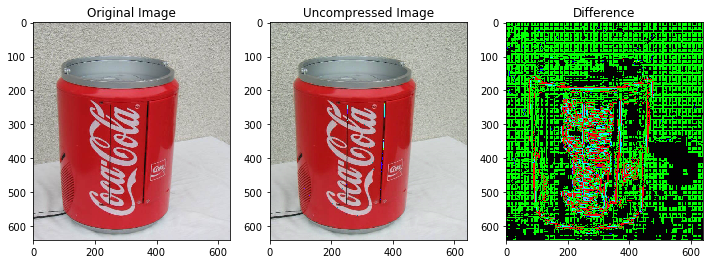

In [25]:
# show the original image and the compressed image
f, axarr = plt.subplots(1,3, figsize=(12,4))
axarr[0].imshow(image,aspect="auto")
axarr[0].set_title("Original Image")
axarr[1].imshow(image_inversed_rgb,aspect="auto")
axarr[1].set_title("Uncompressed Image")
axarr[2].imshow(image-image_inversed_rgb,aspect="auto")
axarr[2].set_title("Difference")
plt.show()

Converting the image into grayscale (using luminosity and average methods):

In [26]:
# transform an RGB image to a grayscale image using the luminosity method
def rgb2grayscale(rgb):
    return np.add(0.3 * rgb[:,:,0], np.add(0.59 * rgb[:,:,1], 0.11 * rgb[:,:,2]))/3

In [27]:
# transform an RGB image to a grayscale image using the average method
def rgb2grayscale_avg(rgb):
    return np.add(rgb[:,:,0], np.add(rgb[:,:,1], rgb[:,:,2]))/3

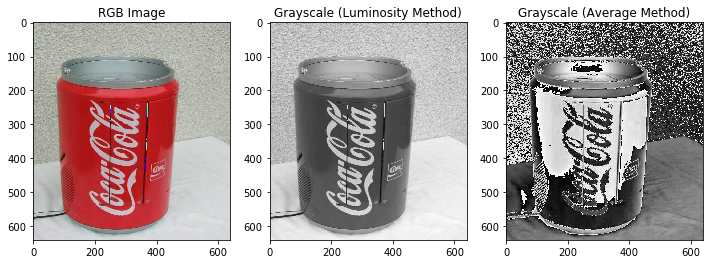

In [28]:
# show the uncompressed rgb image and the grayscale image
f, axarr = plt.subplots(1,3, figsize=(12,4))
axarr[0].imshow(image_inversed_rgb,aspect="auto")
axarr[0].set_title("RGB Image")
axarr[1].imshow(rgb2grayscale(image_inversed_rgb), cmap = plt.cm.gray, aspect="auto")
axarr[1].set_title("Grayscale (Luminosity Method)")
axarr[2].imshow(rgb2grayscale_avg(image_inversed_rgb),cmap = plt.cm.gray, aspect="auto")
axarr[2].set_title("Grayscale (Average Method)")
plt.show()